# Bayesian Optimization Pythia Tune using Ax - Reduced Parameters
> Created: June 4 2024 AAK, Harrison B. Prosper

## Running the notebook
All code and program dependencies such as pythia, rivet, hepmc, Ax are preinstalled on the docker image `alialkadhim/pythia_sbi_tune:latest`. Here is how to install the image and run this notebook:

```
git clone https://github.com/AliAlkadhim/Pythia8_SBI_Tune.git
```
Then,
```
cd Pythia8_SBI_Tune/code/BayesOpt
bash docker_run.sh
```

Then, inside the docker container, do

```
jupyter-lab --ip 0.0.0.0 --port 8889 --allow-root &
```

Now copy and paste the link displayed at the bottom of the terminal to your browser

----

This notebook is an extension for `BO_TuneAx_all_params.ipynb` and it performs Bayesian Optimizaion using [Ax](https://github.com/facebook/Ax) of the Lund string model parameters $a$ and $b$ that appear in the fragmentation function

$$
f_{\text{Lund}}(z) \propto \frac{(1-z)^a}{z} \exp \left(-\frac{b m_{\perp}^2}{z}\right)
$$

which are referred to as `StringZ:aLund` and `StringZ:bLund` in pythia8, respectively.

We use the data from `ALEPH_1996_S3486095` from the paper ["Studies of quantum chromodynamics with the ALEPH detector"](https://www.sciencedirect.com/science/article/pii/S0370157397000458)


## Key Observations
The default values of these parameters in pythia is due to the [Monash Tune](https://arxiv.org/pdf/1404.5630.pdf). Other papers have corroborated the results of that tune and attained similar values for some of the parameters. Therefore, when performing the Bayesian Optimization, we want to take that into account by forcing the algorithm to sample the Monash tune point. Observe how with few number of iterations, while forcing the sobol quasirandom sampling to explore the Monash tune, we will most likely end up with the Monash tune as the best-fit point. However, when we increase the number of iterations, we arrive at a tune that is slightly different than the Monash tune.

## Diferences from the previous notebook
This notebook differs from the previous notebook, `BO_TuneAx_all_params.ipynb`, in the following ways:

1. Instead of using the following test statistic:

$$
    \lambda(X; \theta) = \sqrt{\frac{1}{N}\sum_\text{histograms} \sum_i \left( \frac{D_i - T_i(\theta)}{\delta_i} \right)^2}, \tag{1}
$$


we will use a linear sum of $\chi^2$ variates:
$$
    \lambda(X; \theta) = \sum_\text{histograms} \sum_i \left( \frac{D_i - T_i(\theta)}{\delta_i} \right)^2, \tag{2}
$$

where $N$ is the total number of bins summed over histograms and $\delta_i^2$ is the sum of the variances associated with the data $D_i$ and the theoretical prediction $T_i$ with the latter obtained via Monte Carlo simulation.

The reason is that the peculiar objective function in Eq. (1) is designed for use in a neural network, so we cannot correctly interpret the minos errors as confidence intervals because the objective function doesn't have a $\chi^2$ distribution. On the other hand using Eq. (2) we can interpret this as a $\chi^2$ function for which the usual rules can be applied to derive the errors.


2. We keep fixed all the parameters which are not well determined to the values we found in `BO_TuneAx_all_params.ipynb`. We keep the parameters which are well-determined floating.

Well-determined parameters: [sigma, aExtraSQuark, enhancedFraction, probStoUD, probQQtoQ, probSQtoQQ, alphaSvalue, pTmin]

not well-determined parameters: [aLund, bLund, rFactC, rFactB, aExtraDiquark, enhancedWidth, ProbQQ1toQQ0]

In addition to floating the parameters which are well-determined, we also float $a$ and $b$ again. Therefore:

**floating parameters**: [ aLund, bLund, sigma, aExtraSQuark, enhancedFraction, probStoUD, probQQtoQ, probSQtoQQ, alphaSvalue, pTmin ]

**fixed parameters**: [rFactC, rFactB, aExtraDiquark, enhancedWidth, ProbQQ1toQQ0]

3. We remove histograms that have large discrepancies between theory and data in `BO_TuneAx_all_params.ipynb`, as these histograms could be causing biasing. These observables are just not well modeled by pythia. These observables (histograms) are: ['d35-x01-y01', 'd36-x01-y01','d39-x01-y01', 'd40-x01-y01']

----

## Considererations for Data and Effective counts
Notice (unfortunately) that the total effective counts for every histogram is different! This is a huge complication because, in principle, we would need to generate different numbers of events for every histogram. But, as is true of much of what we do in science, we should make some simplifying assumptions to reduce to complexity of the problem. 

**Assumptions**

  1. Since we are not given correlation matrices for the measured cross sections, we assume that the bin-by-bin cross section measurements are conditionally independent: given fixed values of the tune parameters the measured cross sections are statistically independent.
  2. The counts per bin are Poisson-distributed and the cross sections are just scaled values of the counts.  We can, therefore, compute the effective count in each bin using the following *ansatz*
\begin{align}
    n_i & = k_i \sigma_i,\\
    \sqrt{n_i} & = k_i \delta \sigma_i \quad \text{and, therefore, }\\
    n_i & = \left( \frac{\sigma_i}{\delta\sigma_i} \right)^2 ,
\end{align}
where $\sigma_i \pm \delta\sigma_i$ is the measured cross section in bin $i$ and $k_i$, the *effective integrated luminosity*, is the product $\epsilon_i {\cal L}$ of the efficiency times acceptance, $\epsilon_i$, and  the integrated luminosity ${\cal L}$. The total effective count for a histogram is then just $n = \sum_{i} n_i$.

Therefore, for each tune parameter point, a sufficiently large sample of simulated events will result in histograms that serve both as the predictions as well as the basis for simulating events counts in all the simulated "observed" histograms. Given our assumptions, we can write down an approximation of the statistical model, $p(X | \theta)$, where $X$ are *potentially observable* counts and $\theta$ are the tune parameters. With the assumptions above, the statistical model for the $\texttt{ALEPH}$ data can be approximated as a product of either gamma or Gaussian densities depending on the size of the effective bin counts. We see that about 300,000 events need to be simulated per point in order to match the statistical precision of the data.

## .yoda format
The .yoda histograms for the data look like:

```
# xval	 xerr-	 xerr+	 yval	 yerr-	 yerr+
```
`xval` is the bin center, while `yval` is the height of the bin center. `xerr-=xerr+` is the positive and uncertainties in the bin center location, and `yerr-=yerr+` is the uncertainty in the height.

The data recorded is the cross section. so let's call that cross section in bin i $\hat{\sigma}_i^{Data} =yval$ and the uncertainty in bin i $\Delta^{Data}_i = yerr-$ . 


while the simulation histograms look like:
```
xlow	 xhigh	 sumw	 sumw2	 sumwx	 sumwx2	 numEntries
```

`xlow` is the left edge and `xhigh` is the right edge for a bin $i$. `sumw` is the sum of weights per bin $i$ $sumw^{bin, i} \sum_{k=1}^{N_{counts \ in \ bin \ i}} w_k^{bin \ i}$ and `sumw2` is sum of weights squared $sumw2^{bin \ i}=\sum_{k=1}^{N_{counts \ in \ bin \ i}} (w_k^{bin \ i})^2$ . To convert to differential cross section we divide by the bin widths, i.e. we calculate $\Delta x = xhigh-xlow$ and divide $\hat{\sigma}_i^{MC} = sumw/\Delta x$ and $sumw2/\Delta x ^2$ and $sumwx/\Delta x$ and $sumwx2/Delta x^2$ . Then the MC error for the cross section per bin is $\Delta_i^{MC} =\sqrt{sumw2/\Delta x ^2}$ 

We can write the effective count can be as
$$\frac{\sqrt{\sum_i w_i^2}}{\sum_i w_i}=\frac{1}{\sqrt{N_{e f f}}}$$
So 
$$N_{eff,\ i} = \left( \frac{\sum_i w_i }{\sqrt{\sum_i w_i^2 } } \right)^2 = \left( \frac{\sum_i w_i}{\Delta_{i, MC}} \right)^2$$
Therefore the scale factor per bin is

$$K_i = \frac{\sum_i w_i}{\sum_i w_i^2 }= \frac{\sum_i w_i}{\Delta_{i,MC}^2}$$

------

In [174]:
import os, sys, re
import numpy as np
import pandas as pd
import matplotlib as mp
import matplotlib.pyplot as plt
import importlib

from bayes_opt import BayesianOptimization, UtilityFunction 


from ax.service.ax_client import AxClient, ObjectiveProperties
from ax.utils.measurement.synthetic_functions import hartmann6
from ax.utils.notebook.plotting import init_notebook_plotting, render
from ax.core.observation import ObservationFeatures

import torch
init_notebook_plotting()
# import plotly.io as pio
# pio.renderers.default = "jupyterlab"


#`source /cvmfs/sft.cern.ch/lcg/views/LCG_102/x86_64-centos7-gcc11-opt/setup.sh`
from glob import glob
from tqdm import tqdm
import yoda2numpy_BayesOpt
from yoda2numpy_BayesOpt import Yoda2Numpy

import pythia_SBI_utils
from pythia_SBI_utils import *

FONTSIZE = 14
font = {'family' : 'serif',
        'weight' : 'normal',
        'size'   : FONTSIZE}
mp.rc('font', **font)

# set usetex = False if LaTex is not 
# available on your system or if the 
# rendering is too slow
mp.rc('text', usetex=True)

[INFO 06-05 18:58:18] ax.utils.notebook.plotting: Injecting Plotly library into cell. Do not overwrite or delete cell.
[INFO 06-05 18:58:18] ax.utils.notebook.plotting: Please see
    (https://ax.dev/tutorials/visualizations.html#Fix-for-plots-that-are-not-rendering)
    if visualizations are not rendering.


In [175]:
BAYES_OPT=False
AX=True

In [176]:
N_ITER = 120
best_param_filename_120 = f"best_parameters/all_parameters_Niter_{N_ITER}.csv"
best_parameters_120 = pd.read_csv(best_param_filename_120)
best_parameters_120

,Unnamed: 0,aLund,bLund,rFactC,rFactB,aExtraSQuark,aExtraDiquark,sigma,enhancedFraction,enhancedWidth,ProbStoUD,probQQtoQ,probSQtoQQ,ProbQQ1toQQ0,alphaSvalue,pTmin
0,0,0.75248,1.049841,1.38034,0.819206,0.0,0.931775,0.316637,0.0,1.939937,0.217093,0.104321,0.949422,0.164353,0.13793,0.495941


In [177]:
float(best_parameters_120['rFactC'])

/tmp/ipykernel_56/2751996330.py:1: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead



1.380340215435916

In [179]:
# FLOATING PARAAMS: 
# aLund, 
# bLund, 
# sigma, 
# aExtraSQuark, 
# enhancedFraction, 
# probStoUD, 
# probQQtoQ, 
# probSQtoQQ, 
# alphaSvalue, 
# pTmin

def make_pythia_card(aLund, 
                     bLund,
                    aExtraSQuark,
                    sigma,
                    enhancedFraction,
                    ProbStoUD,
                    probQQtoQ,
                    probSQtoQQ,
                    alphaSvalue,
                    pTmin):
    
    cards_dir = os.path.join(os.getcwd(), "BO_Cards")
    filename = f"ALEPH_1996_S3486095_BO_card.cmnd"
    file_path = os.path.join(cards_dir, filename)
    with open(file_path,'w') as f:
        first_block="""Main:numberOfEvents = 250000          ! number of events to generate
Next:numberShowEvent = 0           ! suppress full listing of first events
# random seed
Random:setSeed = on
Random:seed= 0
! 2) Beam parameter settings.
Beams:idA = 11                ! first beam,  e- = 11
Beams:idB = -11                ! second beam, e+ = -11
Beams:eCM = 91.2               ! CM energy of collision
# Pythia 8 settings for LEP
# Hadronic decays including b quarks, with ISR photons switched off
WeakSingleBoson:ffbar2gmZ = on
23:onMode = off
23:onIfAny = 1 2 3 4 5
PDF:lepton = off
SpaceShower:QEDshowerByL = off\n\n"""
        f.write(first_block)
        # f.write(f"Random:seed={indx+1}")
        f.write(f"StringZ:aLund = {aLund}\n\n")
        f.write(f"StringZ:bLund = {bLund}\n\n")
        f.write(f"StringZ:rFactC = {float(best_parameters_120['rFactC'])}\n\n")
        f.write(f"StringZ:rFactB = {float(best_parameters_120['rFactB'])}\n\n")
        f.write(f"StringZ:aExtraSQuark = {aExtraSQuark}\n\n")
        f.write(f"StringZ:aExtraDiquark = {float(best_parameters_120['aExtraDiquark'])}\n\n")
        f.write(f"StringPT:sigma = {sigma}\n\n")
        f.write(f"StringPT:enhancedFraction = {enhancedFraction}\n\n")
        f.write(f"StringPT:enhancedWidth = {float(best_parameters_120['enhancedWidth'])}\n\n")
        f.write(f"StringFlav:ProbStoUD = {ProbStoUD}\n\n")
        f.write(f"StringFlav:probQQtoQ = {probQQtoQ}\n\n")
        f.write(f"StringFlav:probSQtoQQ = {probSQtoQQ}\n\n")
        f.write(f"StringFlav:ProbQQ1toQQ0 = {float(best_parameters_120['ProbQQ1toQQ0'])}\n\n")
        f.write(f"TimeShower:alphaSvalue = {alphaSvalue}\n\n")
        f.write(f"TimeShower:pTmin = {pTmin}\n\n")
        


def get_pbounds(PARAM_DICT):
    pbounds = {}
    for key, value in PARAM_DICT.items():
        p_name = key.split(':')[1]
        p_bound = tuple(value)
        pbounds[p_name] = p_bound
    return pbounds

In [180]:
dfdata, dfsims, generated_indices = get_data()
print('DATA DATAFRAME')
print(dfdata['/REF/ALEPH_1996_S3486095/d01-x01-y01'].head())
print('FIRST SIM DATAFRAME')
print(dfsims[generated_indices[0]]['/ALEPH_1996_S3486095/d01-x01-y01'].head())

data_keys, mc_keys = get_hist_names(dfdata)

filtered_data_keys, filtered_mc_keys = filter_keys(dfdata, dfsims, data_keys, mc_keys)

print(f'length of filtered_data_keys = {len(filtered_data_keys)}')

[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.53it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw  sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   7.200000   5.76  0.021773  0.015762         9.0
1  0.005  0.010  11.200000   8.96  0.078792  0.114858        14.0
2  0.010  0.015  16.799999  13.44  0.211972  0.541758        21.0
3  0.015  0.020  14.400000  11.52  0.247678  0.857541        18.0
4  0.020  0.025  13.600000  10.88  0.307007  1.392386        17.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH

In [181]:
def reduce_filtered_keys(filtered_data_keys, filtered_mc_keys):
    # Initialize empty list for the reduced keys
    reduced_data_keys = []
    reduced_mc_keys = []
    # List of histogram keys that need to be removed
    hists_to_remove = ['d35-x01-y01', 'd36-x01-y01', 'd39-x01-y01', 'd40-x01-y01']
    
    # Iterate over each data key
    for data_key in filtered_data_keys:
        # Add the key to reduced_data_keys only if it does not match any hist_to_remove
        if not any(hist_to_remove in str(data_key) for hist_to_remove in hists_to_remove):
            reduced_data_keys.append(data_key)

    for mc_key in filtered_mc_keys:
        # Add the key to reduced_data_keys only if it does not match any hist_to_remove
        if not any(hist_to_remove in str(mc_key) for hist_to_remove in hists_to_remove):
            reduced_mc_keys.append(mc_key)
            
        
    return reduced_data_keys, reduced_mc_keys

        

In [182]:
reduced_data_keys, reduced_mc_keys = reduce_filtered_keys(filtered_data_keys, filtered_mc_keys)
print(reduced_data_keys, reduced_mc_keys)
print(f'length of reduced data keys = {len(reduced_data_keys)}')
print(f'length of reduced mc keys = {len(reduced_mc_keys)}')

['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S3486095/d37-x01-y01',

In [183]:
importlib.reload(yoda2numpy_BayesOpt)
from yoda2numpy_BayesOpt import Yoda2Numpy
importlib.reload(pythia_SBI_utils)
from pythia_SBI_utils import *

def true_objective_func(aLund, 
                     bLund,
                    aExtraSQuark,
                    sigma,
                    enhancedFraction,
                    ProbStoUD,
                    probQQtoQ,
                    probSQtoQQ,
                    alphaSvalue,
                    pTmin):
    
    # step 1: write .cmnd file 
    make_pythia_card(aLund, 
                     bLund,
                    aExtraSQuark,
                    sigma,
                    enhancedFraction,
                    ProbStoUD,
                    probQQtoQ,
                    probSQtoQQ,
                    alphaSvalue,
                    pTmin)
    #step 2 run main42 and rivet
    os.system("""./main42 BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo
    rivet -o ALEPH_1996_S3486095_hist_0.yoda -a ALEPH_1996_S3486095 /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo

    /media/ali/DATA/TEMP/rm ALEPH_1996_S3486095_card.fifo
    mv ALEPH_1996_S3486095_hist_0.yoda ALEPH_YODAS_BayesOpt/""")
    

    #step 3: get generated yoda file histograms in the form of dataframes
    dfdata, dfsims, generated_indices = get_data()
    print('DATA DATAFRAME')
    print(dfdata['/REF/ALEPH_1996_S3486095/d01-x01-y01'].head())
    print('FIRST SIM DATAFRAME')
    print(dfsims[generated_indices[0]]['/ALEPH_1996_S3486095/d01-x01-y01'].head())

    #step 4: fileter histograms based on our criteria
    data_keys, mc_keys = get_hist_names(dfdata)

    filtered_data_keys, filtered_mc_keys = filter_keys(dfdata, dfsims, data_keys, mc_keys)

    #step 4.5: take out bad histograms
    reduced_data_keys, reduced_mc_keys = reduce_filtered_keys(filtered_data_keys, filtered_mc_keys)

    
    #step 5: get test statistic at each point
    X0 = {}
    for ii, gen_ind in enumerate(generated_indices):
        # X0.append(test_statistic(filtered_data_keys,filtered_mc_keys, dfdata, dfsims[gen_ind], which = 0))
        # try:
        #     X0.append(test_statistic(filtered_data_keys,filtered_mc_keys, dfdata, dfsims[ii], which = 0))
        try:
            X0[gen_ind] = test_statistic(reduced_data_keys,
                                         reduced_mc_keys, 
                                         dfdata, 
                                         dfsims[gen_ind], 
                                         which = 0)
        except Exception:
            print('test statistic error in file index: ', gen_ind)
            
    if BAYES_OPT:        
        objective_func = - X0[0]
    else:
        objective_func = X0[0]
    # os.system("rm ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda")
        
    print(f"objective function = {objective_func}")
    return objective_func

In [184]:
PARAM_DICT = {
        'StringZ:aLund' : [0.5, 2.0],
        'StringZ:bLund': [0.5, 2.0],
        # 'StringZ:rFactC':[0.0, 2.0],
        # 'StringZ:rFactB': [0., 2.0],
        'StringZ:aExtraSQuark':[0.,2.],
        # 'StringZ:aExtraDiquark':[0.,2.],
        'StringPT:sigma':[0.,1.],
        'StringPT:enhancedFraction':[0.,1.],
        # 'StringPT:enhancedWidth':[1.0,4.0],
        'StringFlav:ProbStoUD':[0,4.0],
        'StringFlav:probQQtoQ':[0,4.0],
        'StringFlav:probSQtoQQ':[0,4.0],
        # 'StringFlav:ProbQQ1toQQ0':[0,4.0],
        'TimeShower:alphaSvalue':[0.06,0.25],
        'TimeShower:pTmin':[0.1,2.0]


}

MONASH_DICT = {
    "aLund" : 0.68, 
    "bLund" : 0.98,
    "rFactC": 1.32,
    "rFactB":0.855,
    "aExtraSQuark": 0.0,
    "aExtraDiquark":0.97,
    "sigma":0.335,
    "enhancedFraction":0.01,
    "enhancedWidth":2.0,
    "ProbStoUD":0.217,
    "probQQtoQ":0.081,
    "probSQtoQQ":0.915,
    "ProbQQ1toQQ0": 0.0275,
    "alphaSvalue": 0.1365,
    "pTmin": 0.5
}

REDUCED_MONASH_DICT = {
    "aLund" : 0.68, 
    "bLund" : 0.98,
    "aExtraSQuark": 0.0,
    "sigma":0.335,
    "enhancedFraction":0.01,
    "ProbStoUD":0.217,
    "probQQtoQ":0.081,
    "probSQtoQQ":0.915,
    "alphaSvalue": 0.1365,
    "pTmin": 0.5
}

ab_tune_Monash_rest = REDUCED_MONASH_DICT.copy()
ab_tune_Monash_rest["aLund"] = 1.1279257649367096
ab_tune_Monash_rest["bLund"] =1.349756967243872
ab_tune_Monash_rest

{'aLund': 1.1279257649367096,
 'bLund': 1.349756967243872,
 'aExtraSQuark': 0.0,
 'sigma': 0.335,
 'enhancedFraction': 0.01,
 'ProbStoUD': 0.217,
 'probQQtoQ': 0.081,
 'probSQtoQQ': 0.915,
 'alphaSvalue': 0.1365,
 'pTmin': 0.5}

In [185]:
ax_client = AxClient()
ax_client.create_experiment(
name="Ax_Tune_Pythia",
        parameters = [
                    {
                        "name": "aLund",
                        "type": "range",
                        "bounds": [0.5, 2.0],
                    }, 
                    {
                        "name": "bLund",
                        "type": "range",
                        "bounds": [0.5, 2.0],
                    },

                    {
                        "name": "aExtraSQuark",
                        "type": "range",
                        "bounds": [0.0, 2.0],
                    }, 

                    {
                        "name": "sigma",
                        "type": "range",
                        "bounds": [0.,1.],
                    }, 
                    {
                        "name": "enhancedFraction",
                        "type": "range",
                        "bounds": [0.,1.],
                    }, 

                    {
                        "name": "ProbStoUD",
                        "type": "range",
                        "value_type": "float",
                        "bounds": [0,4.0],
                    }, 
                    {
                        "name": "probQQtoQ",
                        "type": "range",
                        "value_type": "float",
                        "bounds": [0,4.0],
                    }, 
                    {
                        "name": "probSQtoQQ",
                        "type": "range",
                        "value_type": "float",
                        "bounds": [0,4.0],
                    }, 
   
                    {
                        "name": "alphaSvalue",
                        "type": "range",
                        "value_type": "float",
                        "bounds": [0.06,0.25],
                    }, 
                    {
                        "name": "pTmin",
                        "type": "range",
                        "value_type": "float",
                        "bounds": [0.1,2.0],
                    }, 
            
                ],
objectives = {"true_objective_func": ObjectiveProperties(minimize=True)},
)

[INFO 06-05 18:59:05] ax.service.ax_client: Starting optimization with verbose logging. To disable logging, set the `verbose_logging` argument to `False`. Note that float values in the logs are rounded to 6 decimal points.
[INFO 06-05 18:59:05] ax.service.utils.instantiation: Inferred value type of ParameterType.FLOAT for parameter aLund. If that is not the expected value type, you can explicitly specify 'value_type' ('int', 'float', 'bool' or 'str') in parameter dict.
[INFO 06-05 18:59:05] ax.service.utils.instantiation: Inferred value type of ParameterType.FLOAT for parameter bLund. If that is not the expected value type, you can explicitly specify 'value_type' ('int', 'float', 'bool' or 'str') in parameter dict.
[INFO 06-05 18:59:05] ax.service.utils.instantiation: Inferred value type of ParameterType.FLOAT for parameter aExtraSQuark. If that is not the expected value type, you can explicitly specify 'value_type' ('int', 'float', 'bool' or 'str') in parameter dict.
[INFO 06-05 18:59

In [186]:


##########################################
# Sample Monash Tune point
suggest_param, suggest_ind = ax_client.attach_trial(
    parameters=REDUCED_MONASH_DICT
)
ax_client.complete_trial(trial_index=suggest_ind, raw_data=true_objective_func(
        aLund=suggest_param["aLund"], 
        bLund=suggest_param["bLund"],
        aExtraSQuark=suggest_param["aExtraSQuark"],
        sigma=suggest_param["sigma"],
        enhancedFraction=suggest_param["enhancedFraction"],
        ProbStoUD=suggest_param["ProbStoUD"],
        probQQtoQ=suggest_param["probQQtoQ"],
        probSQtoQQ=suggest_param["probSQtoQQ"],
        alphaSvalue=suggest_param["alphaSvalue"],
        pTmin=suggest_param["pTmin"]
))
##########################################
# Sample ab tune point with the rest of the parameters from the Monash tune
suggest_param_ab, suggest_ind_ab = ax_client.attach_trial(
    parameters=ab_tune_Monash_rest
)
ax_client.complete_trial(trial_index=suggest_ind_ab, raw_data=true_objective_func(
        aLund=suggest_param_ab["aLund"], 
        bLund=suggest_param_ab["bLund"],
        aExtraSQuark=suggest_param_ab["aExtraSQuark"],
        sigma=suggest_param_ab["sigma"],
        enhancedFraction=suggest_param_ab["enhancedFraction"],
        ProbStoUD=suggest_param_ab["ProbStoUD"],
        probQQtoQ=suggest_param_ab["probQQtoQ"],
        probSQtoQQ=suggest_param_ab["probSQtoQQ"],
        alphaSvalue=suggest_param_ab["alphaSvalue"],
        pTmin=suggest_param_ab["pTmin"]
))


##########################################
# start main tuning loop
N_ITER = 100
for i in range(N_ITER):
    parameterization, trial_index = ax_client.get_next_trial()
    print(parameterization)
    ax_client.complete_trial(trial_index=trial_index, raw_data=true_objective_func(
        aLund=parameterization["aLund"], 
        bLund=parameterization["bLund"],
        aExtraSQuark=parameterization["aExtraSQuark"],
        sigma=parameterization["sigma"],
        enhancedFraction=parameterization["enhancedFraction"],
        ProbStoUD=parameterization["ProbStoUD"],
        probQQtoQ=parameterization["probQQtoQ"],
        probSQtoQQ=parameterization["probSQtoQQ"],
        alphaSvalue=parameterization["alphaSvalue"],
        pTmin=parameterization["pTmin"]
    ))



[INFO 06-05 18:59:25] ax.core.experiment: Attached custom parameterizations [{'aLund': 0.68, 'bLund': 0.98, 'aExtraSQuark': 0.0, 'sigma': 0.335, 'enhancedFraction': 0.01, 'ProbStoUD': 0.217, 'probQQtoQ': 0.081, 'probSQtoQQ': 0.915, 'alphaSvalue': 0.1365, 'pTmin': 0.5}] as trial 0.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) ins


 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the Lund Monte Carlo!  |  | 
 |  |   P  P   Y Y     T    H   H   I    A A     This is PYTHIA version 8.309      |  | 
 |  |   PPP     Y      T    HHHHH   I   AAAAA    Last date of change: 16 Feb 2023  |  | 
 |  |   P       Y      T    H   H   I   A   A                                      |  | 
 |  |  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 19:02:43
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:02 elapsed)
Event 300 (0:00:02 elapsed)
Event 400 (0:00:02 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:03 elapsed)
Event 700 (0:00:03 elapsed)
Event 800 (0:00:03 elapsed)
Event 900 (0:00:03 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:04 elapsed)
Event 1300 (0:00:04 elapsed)
Event 1400 (0:00:04 elapsed)
Event 1500 (0:00:04 elapsed)
Event 1600 (0:00:04 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:05 elapsed)
Event 2200 (0:00:05 elapsed)
Event 2300 (0:00:05 elapsed)
Event 2400 (0:00:05 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:06 elapsed)
Event 2900 (0:00:06 elapsed)
Event 3000 (0:00:06





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 14.73it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.791200  0.009433  0.040131  0.030068     14739.0
1  0.005  0.010  23.436800  0.018749  0.176076  0.274144     29296.0
2  0.010  0.015  20.695999  0.016557  0.257236  0.648048     25870.0
3  0.015  0.020  17.283199  0.013827  0.301239  1.057299     21604.0
4  0.020  0.025  13.852000  0.011082  0.310374  1.396592     17315.0
 new d


[INFO 06-05 19:08:37] ax.service.ax_client: Completed trial 0 with data: {'true_objective_func': (6733.075946, None)}.


objective function = 6733.075945854187


[INFO 06-05 19:08:37] ax.core.experiment: Attached custom parameterizations [{'aLund': 1.127926, 'bLund': 1.349757, 'aExtraSQuark': 0.0, 'sigma': 0.335, 'enhancedFraction': 0.01, 'ProbStoUD': 0.217, 'probQQtoQ': 0.081, 'probSQtoQQ': 0.915, 'alphaSvalue': 0.1365, 'pTmin': 0.5}] as trial 1.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc


 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the Lund Monte Carlo!  |  | 
 |  |   P  P   Y Y     T    H   H   I    A A     This is PYTHIA version 8.309      |  | 
 |  |   PPP     Y      T    HHHHH   I   AAAAA    Last date of change: 16 Feb 2023  |  | 
 |  |   P       Y      T    H   H   I   A   A                                      |  | 
 |  |  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 19:11:57
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:02 elapsed)
Event 300 (0:00:04 elapsed)
Event 400 (0:00:05 elapsed)
Event 500 (0:00:06 elapsed)
Event 600 (0:00:07 elapsed)
Event 700 (0:00:08 elapsed)
Event 800 (0:00:08 elapsed)
Event 900 (0:00:08 elapsed)
Event 1000 (0:00:08 elapsed)
Event 1100 (0:00:09 elapsed)
Event 1200 (0:00:09 elapsed)
Event 1300 (0:00:09 elapsed)
Event 1400 (0:00:10 elapsed)
Event 1500 (0:00:10 elapsed)
Event 1600 (0:00:10 elapsed)
Event 1700 (0:00:11 elapsed)
Event 1800 (0:00:11 elapsed)
Event 1900 (0:00:11 elapsed)
Event 2000 (0:00:12 elapsed)
Event 2100 (0:00:12 elapsed)
Event 2200 (0:00:12 elapsed)
Event 2300 (0:00:14 elapsed)
Event 2400 (0:00:15 elapsed)
Event 2500 (0:00:16 elapsed)
Event 2600 (0:00:18 elapsed)
Event 2700 (0:00:20 elapsed)
Event 2800 (0:00:21 elapsed)
Event 2900 (0:00:22 elapsed)
Event 3000 (0:00:24





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  5.04it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.209600  0.008968  0.038977  0.029557     14012.0
1  0.005  0.010  23.472799  0.018778  0.176334  0.274570     29341.0
2  0.010  0.015  20.962400  0.016770  0.260694  0.657142     26203.0
3  0.015  0.020  17.121599  0.013697  0.297960  1.044150     21402.0
4  0.020  0.025  13.961600  0.011169  0.313142  1.410464     17452.0


[INFO 06-05 19:18:19] ax.service.ax_client: Completed trial 1 with data: {'true_objective_func': (6764.128706, None)}.


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-05 19:18:20] ax.service.ax_client: Generated new trial 2 with parameters {'aLund': 1.023334, 'bLund': 0.965479, 'aExtraSQuark': 0.033352, 'sigma': 0.766123, 'enhancedFraction': 0.916146, 'ProbStoUD': 2.47677, 'probQQtoQ': 2.449059, 'probSQtoQQ': 0.441878, 'alphaSvalue': 0.160037, 'pTmin': 1.869554} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeE

{'aLund': 1.0233344286680222, 'bLund': 0.9654786437749863, 'aExtraSQuark': 0.03335243836045265, 'sigma': 0.7661234140396118, 'enhancedFraction': 0.9161463379859924, 'ProbStoUD': 2.4767696857452393, 'probQQtoQ': 2.449058771133423, 'probSQtoQQ': 0.4418776333332062, 'alphaSvalue': 0.1600371265411377, 'pTmin': 1.8695535480976104}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 19:20:50
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:00 elapsed)
Event 700 (0:00:00 elapsed)
Event 800 (0:00:00 elapsed)
Event 900 (0:00:00 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:01 elapsed)
Event 2100 (0:00:01 elapsed)
Event 2200 (0:00:01 elapsed)
Event 2300 (0:00:01 elapsed)
Event 2400 (0:00:01 elapsed)
Event 2500 (0:00:01 elapsed)
Event 2600 (0:00:01 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 15.67it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   4.865052  0.003892  0.015400  0.011305      6081.0
1  0.005  0.010  10.568550  0.008455  0.080844  0.127997     13210.0
2  0.010  0.015  12.354242  0.009884  0.154683  0.392494     15442.0
3  0.015  0.020  12.148632  0.009719  0.212247  0.746635     15185.0
4  0.020  0.025  11.329390  0.009064  0.254621  1.149214     14161.0
 new d


[INFO 06-05 19:23:36] ax.service.ax_client: Completed trial 2 with data: {'true_objective_func': (846108.081834, None)}.


objective function = 846108.0818338394


[INFO 06-05 19:23:36] ax.service.ax_client: Generated new trial 3 with parameters {'aLund': 1.685088, 'bLund': 0.95413, 'aExtraSQuark': 1.918309, 'sigma': 0.836876, 'enhancedFraction': 0.305434, 'ProbStoUD': 3.783173, 'probQQtoQ': 2.135141, 'probSQtoQQ': 1.309074, 'alphaSvalue': 0.14684, 'pTmin': 1.914191} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeEr

{'aLund': 1.685087509918958, 'bLund': 0.9541300050914288, 'aExtraSQuark': 1.918309336528182, 'sigma': 0.8368762694299221, 'enhancedFraction': 0.3054344551637769, 'ProbStoUD': 3.7831729277968407, 'probQQtoQ': 2.1351414173841476, 'probSQtoQQ': 1.3090740442276, 'alphaSvalue': 0.1468404189683497, 'pTmin': 1.9141914590261877}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 19:26:09
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:00 elapsed)
Event 700 (0:00:00 elapsed)
Event 800 (0:00:00 elapsed)
Event 900 (0:00:00 elapsed)
Event 1000 (0:00:00 elapsed)
Event 1100 (0:00:00 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:01 elapsed)
Event 2100 (0:00:01 elapsed)
Event 2200 (0:00:01 elapsed)
Event 2300 (0:00:01 elapsed)
Event 2400 (0:00:01 elapsed)
Event 2500 (0:00:01 elapsed)
Event 2600 (0:00:01 elapsed)
Event 2700 (0:00:01 elapsed)
Event 2800 (0:00:01 elapsed)
Event 2900 (0:00:01 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 15.94it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   3.943248  0.003155  0.013622  0.010383      4929.0
1  0.005  0.010  11.692140  0.009354  0.089779  0.142598     14615.0
2  0.010  0.015  14.543374  0.011635  0.182437  0.463803     18179.0
3  0.015  0.020  14.573774  0.011659  0.254903  0.897696     18217.0
4  0.020  0.025  13.422562  0.010738  0.301449  1.359637     16778.0
 new d


[INFO 06-05 19:28:58] ax.service.ax_client: Completed trial 3 with data: {'true_objective_func': (776542.922997, None)}.


objective function = 776542.922996521


[INFO 06-05 19:28:58] ax.service.ax_client: Generated new trial 4 with parameters {'aLund': 1.2337, 'bLund': 1.693517, 'aExtraSQuark': 0.643285, 'sigma': 0.472614, 'enhancedFraction': 0.42418, 'ProbStoUD': 2.071608, 'probQQtoQ': 2.896339, 'probSQtoQQ': 3.19301, 'alphaSvalue': 0.087882, 'pTmin': 0.820307} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeErro

{'aLund': 1.2337001166306436, 'bLund': 1.69351653335616, 'aExtraSQuark': 0.6432849187403917, 'sigma': 0.4726144056767225, 'enhancedFraction': 0.42417950462549925, 'ProbStoUD': 2.071608029305935, 'probQQtoQ': 2.896338988095522, 'probSQtoQQ': 3.1930102966725826, 'alphaSvalue': 0.0878823793772608, 'pTmin': 0.8203071687370538}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 19:31:27
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:02 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:04 elapsed)
Event 1600 (0:00:04 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:05 elapsed)
Event 2100 (0:00:05 elapsed)
Event 2200 (0:00:05 elapsed)
Event 2300 (0:00:05 elapsed)
Event 2400 (0:00:06 elapsed)
Event 2500 (0:00:06 elapsed)
Event 2600 (0:00:06 elapsed)
Event 2700 (0:00:07 elapsed)
Event 2800 (0:00:07 elapsed)
Event 2900 (0:00:07 elapsed)
Event 3000 (0:00:07





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 16.28it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  35.155762  0.028125  0.106417  0.074653     43944.0
1  0.005  0.010  37.960602  0.030369  0.278074  0.422981     47450.0
2  0.010  0.015  25.420401  0.020337  0.313465  0.783576     31775.0
3  0.015  0.020  17.359478  0.013888  0.300953  1.050632     21699.0
4  0.020  0.025  12.161794  0.009730  0.271737  1.219346     15202.0
 new d


[INFO 06-05 19:33:56] ax.service.ax_client: Completed trial 4 with data: {'true_objective_func': (886515.342325, None)}.


objective function = 886515.3423252106


[INFO 06-05 19:33:56] ax.service.ax_client: Generated new trial 5 with parameters {'aLund': 0.722014, 'bLund': 1.358459, 'aExtraSQuark': 1.089242, 'sigma': 0.43233, 'enhancedFraction': 0.96898, 'ProbStoUD': 0.024503, 'probQQtoQ': 0.390913, 'probSQtoQQ': 0.696351, 'alphaSvalue': 0.201901, 'pTmin': 0.164908} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeEr

{'aLund': 0.7220137589611113, 'bLund': 1.3584585413336754, 'aExtraSQuark': 1.089242035523057, 'sigma': 0.4323297319933772, 'enhancedFraction': 0.9689797610044479, 'ProbStoUD': 0.024502508342266083, 'probQQtoQ': 0.3909129798412323, 'probSQtoQQ': 0.6963505782186985, 'alphaSvalue': 0.20190083497203887, 'pTmin': 0.16490761740133167}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 19:37:17
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 16.33it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh    sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  0.7920  0.000634  0.002808  0.002175       990.0
1  0.005  0.010  3.4432  0.002755  0.026960  0.043561      4304.0
2  0.010  0.015  5.5912  0.004473  0.070600  0.180602      6989.0
3  0.015  0.020  6.9152  0.005532  0.121355  0.428810      8644.0
4  0.020  0.025  7.4456  0.005956  0.167808  0.759522      9307.0
 new data keys ['/REF/AL


[INFO 06-05 19:42:18] ax.service.ax_client: Completed trial 5 with data: {'true_objective_func': (613609.532125, None)}.


objective function = 613609.5321245193


[INFO 06-05 19:42:18] ax.service.ax_client: Generated new trial 6 with parameters {'aLund': 0.736183, 'bLund': 1.623973, 'aExtraSQuark': 0.408595, 'sigma': 0.433176, 'enhancedFraction': 0.921003, 'ProbStoUD': 1.786641, 'probQQtoQ': 2.591489, 'probSQtoQQ': 3.972746, 'alphaSvalue': 0.066847, 'pTmin': 1.790934} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Type

{'aLund': 0.7361825965344906, 'bLund': 1.6239733789116144, 'aExtraSQuark': 0.4085950367152691, 'sigma': 0.43317644856870174, 'enhancedFraction': 0.9210026385262609, 'ProbStoUD': 1.786641251295805, 'probQQtoQ': 2.591488629579544, 'probSQtoQQ': 3.972746480256319, 'alphaSvalue': 0.06684686152264475, 'pTmin': 1.7909343504346906}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  I

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 19:44:21
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:01 elapsed)
Event 2100 (0:00:01 elapsed)
Event 2200 (0:00:01 elapsed)
Event 2300 (0:00:01 elapsed)
Event 2400 (0:00:01 elapsed)
Event 2500 (0:00:01 elapsed)
Event 2600 (0:00:01 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 16.81it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  50.955681  0.040768  0.142876  0.096455     63689.0
1  0.005  0.010  41.582859  0.033269  0.302501  0.457229     51974.0
2  0.010  0.015  25.169420  0.020137  0.309656  0.772320     31459.0
3  0.015  0.020  15.798990  0.012640  0.273466  0.953288     19747.0
4  0.020  0.025  10.379314  0.008304  0.232036  1.041746     12973.0
 new d

[INFO 06-05 19:46:53] ax.service.ax_client: Completed trial 6 with data: {'true_objective_func': (1232319.138458, None)}.
[INFO 06-05 19:46:53] ax.service.ax_client: Generated new trial 7 with parameters {'aLund': 1.381183, 'bLund': 1.264585, 'aExtraSQuark': 1.723024, 'sigma': 0.375034, 'enhancedFraction': 0.538344, 'ProbStoUD': 1.33361, 'probQQtoQ': 0.137555, 'probSQtoQQ': 1.71747, 'alphaSvalue': 0.178005, 'pTmin': 0.998815} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipy

{'aLund': 1.3811834803782403, 'bLund': 1.2645852519199252, 'aExtraSQuark': 1.723024159669876, 'sigma': 0.3750340910628438, 'enhancedFraction': 0.5383437210693955, 'ProbStoUD': 1.3336096182465553, 'probQQtoQ': 0.137555293738842, 'probSQtoQQ': 1.7174697667360306, 'alphaSvalue': 0.17800499932840466, 'pTmin': 0.9988146825693547}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  I

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 19:50:36
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:00 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:03 elapsed)
Event 2700 (0:00:03 elapsed)
Event 2800 (0:00:03 elapsed)
Event 2900 (0:00:03 elapsed)
Event 3000 (0:00:03





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.14it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh     sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   1.0168  0.000813  0.003838  0.003070      1271.0
1  0.005  0.010   5.2792  0.004223  0.041465  0.067137      6599.0
2  0.010  0.015   8.9384  0.007151  0.112794  0.288353     11173.0
3  0.015  0.020  10.4752  0.008380  0.183624  0.648149     13094.0
4  0.020  0.025  10.8760  0.008701  0.244459  1.103438     13595.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S

[INFO 06-05 19:57:29] ax.service.ax_client: Completed trial 7 with data: {'true_objective_func': (516736.008553, None)}.


objective function = 516736.00855255127


[INFO 06-05 19:57:29] ax.service.ax_client: Generated new trial 8 with parameters {'aLund': 1.527672, 'bLund': 1.665534, 'aExtraSQuark': 0.003441, 'sigma': 0.192757, 'enhancedFraction': 0.185789, 'ProbStoUD': 3.48064, 'probQQtoQ': 2.03343, 'probSQtoQQ': 1.980024, 'alphaSvalue': 0.200192, 'pTmin': 1.239356} using model Sobol.


{'aLund': 1.5276723355054855, 'bLund': 1.6655336432158947, 'aExtraSQuark': 0.0034412741661071777, 'sigma': 0.1927569517865777, 'enhancedFraction': 0.18578879162669182, 'ProbStoUD': 3.4806400388479233, 'probQQtoQ': 2.0334300622344017, 'probSQtoQQ': 1.9800239279866219, 'alphaSvalue': 0.20019244140945375, 'pTmin': 1.239355581626296}


/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:58: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead




 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the Lund Monte Carlo!  |  | 
 |  |   P  P   Y Y     T    H   H   I    A A     This is PYTHIA version 8.309      |  | 
 |  |   PPP     Y      T    HHHHH   I   AAAAA    Last date of change: 16 Feb 2023  |  | 
 |  |   P       Y      T    H   H   I   A   A                                      |  | 
 |  |  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 20:01:03
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:02 elapsed)
Event 300 (0:00:02 elapsed)
Event 400 (0:00:02 elapsed)
Event 500 (0:00:03 elapsed)
Event 600 (0:00:03 elapsed)
Event 700 (0:00:03 elapsed)
Event 800 (0:00:03 elapsed)
Event 900 (0:00:03 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:04 elapsed)
Event 1200 (0:00:04 elapsed)
Event 1300 (0:00:04 elapsed)
Event 1400 (0:00:04 elapsed)
Event 1500 (0:00:04 elapsed)
Event 1600 (0:00:04 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:05 elapsed)
Event 2000 (0:00:05 elapsed)
Event 2100 (0:00:05 elapsed)
Event 2200 (0:00:05 elapsed)
Event 2300 (0:00:05 elapsed)
Event 2400 (0:00:06 elapsed)
Event 2500 (0:00:06 elapsed)
Event 2600 (0:00:06 elapsed)
Event 2700 (0:00:06 elapsed)
Event 2800 (0:00:06 elapsed)
Event 2900 (0:00:06 elapsed)
Event 3000 (0:00:06





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 10.77it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh     sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   2.2352  0.001788  0.008004  0.006201      2794.0
1  0.005  0.010   7.5040  0.006003  0.057662  0.091630      9380.0
2  0.010  0.015   9.8160  0.007853  0.123403  0.314362     12270.0
3  0.015  0.020  10.3224  0.008258  0.180784  0.637550     12903.0
4  0.020  0.025  10.1776  0.008142  0.228830  1.033206     12722.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-

[INFO 06-05 20:09:06] ax.service.ax_client: Completed trial 8 with data: {'true_objective_func': (1517185.29863, None)}.


objective function = 1517185.2986297607


[INFO 06-05 20:09:06] ax.service.ax_client: Generated new trial 9 with parameters {'aLund': 1.857784, 'bLund': 1.206591, 'aExtraSQuark': 1.860484, 'sigma': 0.557311, 'enhancedFraction': 0.762154, 'ProbStoUD': 2.619026, 'probQQtoQ': 2.321435, 'probSQtoQQ': 1.624403, 'alphaSvalue': 0.217829, 'pTmin': 1.248011} using model Sobol.


{'aLund': 1.8577843313105404, 'bLund': 1.2065905523486435, 'aExtraSQuark': 1.8604837022721767, 'sigma': 0.5573114678263664, 'enhancedFraction': 0.7621537894010544, 'ProbStoUD': 2.619025718420744, 'probQQtoQ': 2.321435008198023, 'probSQtoQQ': 1.6244029887020588, 'alphaSvalue': 0.2178285448625684, 'pTmin': 1.2480114193633198}


/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:58: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead




 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the Lund Monte Carlo!  |  | 
 |  |   P  P   Y Y     T    H   H   I    A A     This is PYTHIA version 8.309      |  | 
 |  |   PPP     Y      T    HHHHH   I   AAAAA    Last date of change: 16 Feb 2023  |  | 
 |  |   P       Y      T    H   H   I   A   A                                      |  | 
 |  |  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 20:12:59
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:02 elapsed)
Event 200 (0:00:02 elapsed)
Event 300 (0:00:03 elapsed)
Event 400 (0:00:03 elapsed)
Event 500 (0:00:03 elapsed)
Event 600 (0:00:04 elapsed)
Event 700 (0:00:04 elapsed)
Event 800 (0:00:04 elapsed)
Event 900 (0:00:04 elapsed)
Event 1000 (0:00:04 elapsed)
Event 1100 (0:00:04 elapsed)
Event 1200 (0:00:05 elapsed)
Event 1300 (0:00:05 elapsed)
Event 1400 (0:00:05 elapsed)
Event 1500 (0:00:05 elapsed)
Event 1600 (0:00:05 elapsed)
Event 1700 (0:00:05 elapsed)
Event 1800 (0:00:05 elapsed)
Event 1900 (0:00:05 elapsed)
Event 2000 (0:00:06 elapsed)
Event 2100 (0:00:06 elapsed)
Event 2200 (0:00:06 elapsed)
Event 2300 (0:00:06 elapsed)
Event 2400 (0:00:06 elapsed)
Event 2500 (0:00:06 elapsed)
Event 2600 (0:00:06 elapsed)
Event 2700 (0:00:06 elapsed)
Event 2800 (0:00:07 elapsed)
Event 2900 (0:00:07 elapsed)
Event 3000 (0:00:07





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.04it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-05 20:18:11] ax.service.ax_client: Completed trial 9 with data: {'true_objective_func': (1541548.162766, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh    sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  0.2888  0.000231  0.001039  0.000810       361.0
1  0.005  0.010  1.5608  0.001249  0.012447  0.020438      1951.0
2  0.010  0.015  3.0200  0.002416  0.038341  0.098581      3775.0
3  0.015  0.020  4.3728  0.003498  0.076979  0.272848      5466.0
4  0.020  0.025  5.3000  0.004240  0.119578  0.541777      6625.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH

[INFO 06-05 20:18:11] ax.service.ax_client: Generated new trial 10 with parameters {'aLund': 1.396548, 'bLund': 1.951563, 'aExtraSQuark': 1.256688, 'sigma': 0.451928, 'enhancedFraction': 0.768345, 'ProbStoUD': 0.016059, 'probQQtoQ': 1.903743, 'probSQtoQQ': 3.876088, 'alphaSvalue': 0.178686, 'pTmin': 1.255375} using model Sobol.


{'aLund': 1.3965477575547993, 'bLund': 1.951563139911741, 'aExtraSQuark': 1.2566880155354738, 'sigma': 0.45192796364426613, 'enhancedFraction': 0.7683449536561966, 'ProbStoUD': 0.016059227287769318, 'probQQtoQ': 1.9037431217730045, 'probSQtoQQ': 3.8760882169008255, 'alphaSvalue': 0.17868584117852152, 'pTmin': 1.2553749464452266}


/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:58: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead




 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the Lund Monte Carlo!  |  | 
 |  |   P  P   Y Y     T    H   H   I    A A     This is PYTHIA version 8.309      |  | 
 |  |   PPP     Y      T    HHHHH   I   AAAAA    Last date of change: 16 Feb 2023  |  | 
 |  |   P       Y      T    H   H   I   A   A                                      |  | 
 |  |  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 20:21:56
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:01<00:00,  1.39it/s]
[INFO 06-05 20:25:25] ax.service.ax_client: Completed trial 10 with data: {'true_objective_func': (425457.410065, None)}.


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   2.346418  0.001877  0.008141  0.006224      2933.0
1  0.005  0.010   7.733662  0.006187  0.059926  0.096001      9667.0
2  0.010  0.015  10.382484  0.008306  0.130199  0.330818     12978.0
3  0.015  0.020  10.982488  0.008786  0.192206  0.677321     13728.0
4  0.020  0.025  10.600884  0.008481  0.238264  1.075418     13251.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S

[INFO 06-05 20:25:25] ax.service.ax_client: Generated new trial 11 with parameters {'aLund': 0.927952, 'bLund': 0.572224, 'aExtraSQuark': 1.96616, 'sigma': 0.74556, 'enhancedFraction': 0.248056, 'ProbStoUD': 2.440409, 'probQQtoQ': 3.368548, 'probSQtoQQ': 2.317416, 'alphaSvalue': 0.075394, 'pTmin': 1.51499} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeEr

{'aLund': 0.9279520558193326, 'bLund': 0.5722244023345411, 'aExtraSQuark': 1.9661599285900593, 'sigma': 0.745560253970325, 'enhancedFraction': 0.24805605318397284, 'ProbStoUD': 2.4404093138873577, 'probQQtoQ': 3.3685475327074528, 'probSQtoQQ': 2.3174161054193974, 'alphaSvalue': 0.07539421750232578, 'pTmin': 1.514989759400487}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 20:27:37
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:01 elapsed)
Event 2100 (0:00:01 elapsed)
Event 2200 (0:00:01 elapsed)
Event 2300 (0:00:01 elapsed)
Event 2400 (0:00:01 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 15.81it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.924848  0.009540  0.040022  0.029958     14906.0
1  0.005  0.010  27.620920  0.022097  0.209688  0.329588     34526.0
2  0.010  0.015  27.700121  0.022160  0.344582  0.868872     34625.0
3  0.015  0.020  23.158501  0.018527  0.402632  1.409689     28948.0
4  0.020  0.025  17.732870  0.014186  0.397073  1.785726     22166.0
 new d


[INFO 06-05 20:30:03] ax.service.ax_client: Completed trial 11 with data: {'true_objective_func': (771787.052612, None)}.


objective function = 771787.0526123047


[INFO 06-05 20:30:03] ax.service.ax_client: Generated new trial 12 with parameters {'aLund': 1.661006, 'bLund': 1.077259, 'aExtraSQuark': 1.735437, 'sigma': 0.45473, 'enhancedFraction': 0.870762, 'ProbStoUD': 0.899954, 'probQQtoQ': 2.062082, 'probSQtoQQ': 2.824685, 'alphaSvalue': 0.077798, 'pTmin': 1.209553} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Type

{'aLund': 1.6610057838261127, 'bLund': 1.0772591778077185, 'aExtraSQuark': 1.7354365717619658, 'sigma': 0.45473006647080183, 'enhancedFraction': 0.8707616068422794, 'ProbStoUD': 0.8999544605612755, 'probQQtoQ': 2.0620820485055447, 'probSQtoQQ': 2.824684724211693, 'alphaSvalue': 0.07779759220778942, 'pTmin': 1.2095527253113687}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 20:32:13
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 14.03it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  16.201059  0.012961  0.054975  0.041377     20251.0
1  0.005  0.010  34.120541  0.027297  0.256833  0.400505     42650.0
2  0.010  0.015  30.218081  0.024175  0.374673  0.941670     37772.0
3  0.015  0.020  22.245960  0.017797  0.386227  1.350347     27807.0
4  0.020  0.025  16.310659  0.013049  0.364949  1.639936     20388.0


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-05 20:34:33] ax.service.ax_client: Completed trial 12 with data: {'true_objective_func': (770938.208359, None)}.
[INFO 06-05 20:34:33] ax.service.ax_client: Generated new trial 13 with parameters {'aLund': 0.780321, 'bLund': 0.753123, 'aExtraSQuark': 0.180045, 'sigma': 0.508407, 'enhancedFraction': 0.939803, 'ProbStoUD': 2.458667, 'probQQtoQ': 2.179875, 'probSQtoQQ': 2.389536, 'alphaSvalue': 0.192015, 'pTmin': 1.418881} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/

objective function = 770938.2083587646
{'aLund': 0.7803206187672913, 'bLund': 0.7531225234270096, 'aExtraSQuark': 0.18004522286355495, 'sigma': 0.5084069026634097, 'enhancedFraction': 0.9398030582815409, 'ProbStoUD': 2.458666827529669, 'probQQtoQ': 2.1798752434551716, 'probSQtoQQ': 2.3895359374582767, 'alphaSvalue': 0.19201454273425042, 'pTmin': 1.4188807900995017}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 20:38:27
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.12it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh    sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  0.9016  0.000721  0.003204  0.002497      1127.0
1  0.005  0.010  3.7568  0.003005  0.029427  0.047621      4696.0
2  0.010  0.015  6.2968  0.005037  0.079722  0.204444      7871.0
3  0.015  0.020  7.7000  0.006160  0.135203  0.477996      9625.0
4  0.020  0.025  8.3288  0.006663  0.187442  0.847149     10411.0


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-05 20:44:32] ax.service.ax_client: Completed trial 13 with data: {'true_objective_func': (1134493.017221, None)}.


objective function = 1134493.0172214508


[INFO 06-05 20:44:32] ax.service.ax_client: Generated new trial 14 with parameters {'aLund': 1.523493, 'bLund': 1.425781, 'aExtraSQuark': 1.706865, 'sigma': 0.623808, 'enhancedFraction': 0.185033, 'ProbStoUD': 3.249376, 'probQQtoQ': 1.487938, 'probSQtoQQ': 2.648978, 'alphaSvalue': 0.105462, 'pTmin': 1.33463} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Type

{'aLund': 1.5234925849363208, 'bLund': 1.42578131146729, 'aExtraSQuark': 1.7068649902939796, 'sigma': 0.6238080700859427, 'enhancedFraction': 0.18503277376294136, 'ProbStoUD': 3.249375708401203, 'probQQtoQ': 1.4879379086196423, 'probSQtoQQ': 2.6489778719842434, 'alphaSvalue': 0.10546217480674386, 'pTmin': 1.334629590343684}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  II

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 20:47:09
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:00 elapsed)
Event 700 (0:00:00 elapsed)
Event 800 (0:00:00 elapsed)
Event 900 (0:00:00 elapsed)
Event 1000 (0:00:00 elapsed)
Event 1100 (0:00:00 elapsed)
Event 1200 (0:00:00 elapsed)
Event 1300 (0:00:00 elapsed)
Event 1400 (0:00:00 elapsed)
Event 1500 (0:00:00 elapsed)
Event 1600 (0:00:00 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:01 elapsed)
Event 2100 (0:00:01 elapsed)
Event 2200 (0:00:01 elapsed)
Event 2300 (0:00:01 elapsed)
Event 2400 (0:00:01 elapsed)
Event 2500 (0:00:01 elapsed)
Event 2600 (0:00:01 elapsed)
Event 2700 (0:00:01 elapsed)
Event 2800 (0:00:01 elapsed)
Event 2900 (0:00:01 elapsed)
Event 3000 (0:00:01





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 14.78it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  19.016151  0.015213  0.062185  0.045704     23770.0
1  0.005  0.010  31.925859  0.025541  0.237694  0.367074     39907.0
2  0.010  0.015  25.237000  0.020190  0.312679  0.785326     31546.0
3  0.015  0.020  18.812950  0.015050  0.326567  1.141504     23516.0
4  0.020  0.025  13.873710  0.011099  0.310332  1.394147     17342.0
 new d

objective function = 726397.304763794


[INFO 06-05 20:49:57] ax.service.ax_client: Completed trial 14 with data: {'true_objective_func': (726397.304764, None)}.
[INFO 06-05 20:49:57] ax.service.ax_client: Generated new trial 15 with parameters {'aLund': 1.465757, 'bLund': 1.614146, 'aExtraSQuark': 0.272736, 'sigma': 0.00221, 'enhancedFraction': 0.46953, 'ProbStoUD': 3.92156, 'probQQtoQ': 2.379211, 'probSQtoQQ': 0.615544, 'alphaSvalue': 0.072927, 'pTmin': 0.336945} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipy

{'aLund': 1.4657566556707025, 'bLund': 1.6141463350504637, 'aExtraSQuark': 0.2727356534451246, 'sigma': 0.0022103553637862206, 'enhancedFraction': 0.4695304473862052, 'ProbStoUD': 3.9215599447488785, 'probQQtoQ': 2.3792107217013836, 'probSQtoQQ': 0.6155439615249634, 'alphaSvalue': 0.07292743159458041, 'pTmin': 0.3369451338425279}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 20:52:32
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:00 elapsed)
Event 700 (0:00:00 elapsed)
Event 800 (0:00:00 elapsed)
Event 900 (0:00:00 elapsed)
Event 1000 (0:00:00 elapsed)
Event 1100 (0:00:00 elapsed)
Event 1200 (0:00:00 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:01 elapsed)
Event 2100 (0:00:01 elapsed)
Event 2200 (0:00:01 elapsed)
Event 2300 (0:00:01 elapsed)
Event 2400 (0:00:01 elapsed)
Event 2500 (0:00:01 elapsed)
Event 2600 (0:00:01 elapsed)
Event 2700 (0:00:01 elapsed)
Event 2800 (0:00:01 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


 50%|████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 1/2 [00:00<00:00,  1.78it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  2.37it/s]
[INFO 06-05 20:55:31] ax.service.ax_client: Completed trial 15 with data: {'true_objective_func': (1219113.85463, None)}.
[INFO 06-05 20:55:31] ax.service.ax_client: Generated new trial 16 with parameters {'aLund': 1.815791, 'bLund': 1.663491, 'aExtraSQuark': 1.984565, 'sigma': 0.118161, 'enhancedFraction': 0.302845, 'ProbStoUD': 1.098648, 'probQQtoQ': 1.58627, 'probSQtoQQ': 1.922105, 'alphaSvalue': 0.125538, 'pTmin': 0.291758} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use flo


using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  86.879539  0.069504  0.176804  0.101538    108599.0
1  0.005  0.010  30.684919  0.024548  0.222416  0.335164     38356.0
2  0.010  0.015  18.228872  0.014583  0.224743  0.561649     22786.0
3  0.015  0.020  11.340046  0.009072  0.196414  0.685059     14175.0
4  0.020  0.025   7.434430  0.005948  0.166280  0.746949      9293.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 20:59:37
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:03 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:04 elapsed)
Event 1200 (0:00:04 elapsed)
Event 1300 (0:00:04 elapsed)
Event 1400 (0:00:04 elapsed)
Event 1500 (0:00:04 elapsed)
Event 1600 (0:00:05 elapsed)
Event 1700 (0:00:05 elapsed)
Event 1800 (0:00:05 elapsed)
Event 1900 (0:00:05 elapsed)
Event 2000 (0:00:06 elapsed)
Event 2100 (0:00:06 elapsed)
Event 2200 (0:00:06 elapsed)
Event 2300 (0:00:07 elapsed)
Event 2400 (0:00:07 elapsed)
Event 2500 (0:00:07 elapsed)
Event 2600 (0:00:07 elapsed)
Event 2700 (0:00:07 elapsed)
Event 2800 (0:00:07 elapsed)
Event 2900 (0:00:07 elapsed)
Event 3000 (0:00:08





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.33it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-05 21:06:26] ax.service.ax_client: Completed trial 16 with data: {'true_objective_func': (837838.780787, None)}.
[INFO 06-05 21:06:26] ax.service.ax_client: Generated new trial 17 with parameters {'aLund': 0.916102, 'bLund': 0.928428, 'aExtraSQuark': 1.862054, 'sigma': 0.594547, 'enhancedFraction': 0.610405, 'ProbStoUD': 1.332938, 'probQQtoQ': 3.468218, 'probSQtoQQ': 1.790859, 'alphaSvalue': 0.080368, 'pTmin': 1.029817} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/

DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  33.288799  0.026631  0.097633  0.066710     41611.0
1  0.005  0.010  30.568800  0.024455  0.224275  0.341743     38211.0
2  0.010  0.015  21.141600  0.016913  0.261355  0.654889     26427.0
3  0.015  0.020  15.472800  0.012378  0.269054  0.942106     19341.0
4  0.020  0.025  11.537600  0.009230  0.258299  1.161351     14422.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 21:08:33
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:00 elapsed)
Event 700 (0:00:00 elapsed)
Event 800 (0:00:00 elapsed)
Event 900 (0:00:00 elapsed)
Event 1000 (0:00:00 elapsed)
Event 1100 (0:00:00 elapsed)
Event 1200 (0:00:00 elapsed)
Event 1300 (0:00:00 elapsed)
Event 1400 (0:00:00 elapsed)
Event 1500 (0:00:00 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:01 elapsed)
Event 2100 (0:00:01 elapsed)
Event 2200 (0:00:01 elapsed)
Event 2300 (0:00:01 elapsed)
Event 2400 (0:00:01 elapsed)
Event 2500 (0:00:01 elapsed)
Event 2600 (0:00:01 elapsed)
Event 2700 (0:00:01 elapsed)
Event 2800 (0:00:01 elapsed)
Event 2900 (0:00:01 elapsed)
Event 3000 (0:00:01





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 15.02it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  18.310040  0.014648  0.059326  0.043619     22887.0
1  0.005  0.010  32.971199  0.026378  0.247012  0.383705     41213.0
2  0.010  0.015  28.224680  0.022580  0.349739  0.878316     35280.0
3  0.015  0.020  21.124500  0.016900  0.366712  1.281954     26405.0
4  0.020  0.025  15.584374  0.012468  0.348645  1.566431     19480.0
 new d

objective function = 849855.1169128418


[INFO 06-05 21:11:00] ax.service.ax_client: Completed trial 17 with data: {'true_objective_func': (849855.116913, None)}.
[INFO 06-05 21:11:00] ax.service.ax_client: Generated new trial 18 with parameters {'aLund': 1.913519, 'bLund': 1.166639, 'aExtraSQuark': 1.998783, 'sigma': 0.237865, 'enhancedFraction': 0.846246, 'ProbStoUD': 1.316688, 'probQQtoQ': 2.777819, 'probSQtoQQ': 3.882113, 'alphaSvalue': 0.079088, 'pTmin': 1.23304} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/i

{'aLund': 1.9135194052942097, 'bLund': 1.1666385238058865, 'aExtraSQuark': 1.9987833835184574, 'sigma': 0.23786492552608252, 'enhancedFraction': 0.8462461391463876, 'ProbStoUD': 1.3166876770555973, 'probQQtoQ': 2.777819100767374, 'probSQtoQQ': 3.8821129500865936, 'alphaSvalue': 0.07908820483833551, 'pTmin': 1.2330395619384944}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 21:13:08
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 15.27it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  35.944801  0.028756  0.116946  0.084894     44931.0
1  0.005  0.010  44.138401  0.035311  0.322786  0.490137     55173.0
2  0.010  0.015  27.833599  0.022267  0.342838  0.856092     34792.0
3  0.015  0.020  18.255199  0.014604  0.316262  1.103302     22819.0
4  0.020  0.025  12.155200  0.009724  0.271533  1.218177     15194.0
 new d


[INFO 06-05 21:15:49] ax.service.ax_client: Completed trial 18 with data: {'true_objective_func': (872642.858059, None)}.


objective function = 872642.8580589294


[INFO 06-05 21:15:49] ax.service.ax_client: Generated new trial 19 with parameters {'aLund': 0.83316, 'bLund': 1.159519, 'aExtraSQuark': 1.927289, 'sigma': 0.176442, 'enhancedFraction': 0.653785, 'ProbStoUD': 0.159739, 'probQQtoQ': 2.600625, 'probSQtoQQ': 0.327489, 'alphaSvalue': 0.127434, 'pTmin': 0.458483} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Type

{'aLund': 0.8331598499789834, 'bLund': 1.1595190498046577, 'aExtraSQuark': 1.927289204671979, 'sigma': 0.17644192092120647, 'enhancedFraction': 0.6537851775065064, 'ProbStoUD': 0.1597389541566372, 'probQQtoQ': 2.6006251499056816, 'probSQtoQQ': 0.3274889476597309, 'alphaSvalue': 0.12743411127477883, 'pTmin': 0.4584830403327942}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 21:18:59
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:03 elapsed)
Event 2700 (0:00:03 elapsed)
Event 2800 (0:00:03 elapsed)
Event 2900 (0:00:03 elapsed)
Event 3000 (0:00:03





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 14.52it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  24.522400  0.019618  0.076641  0.054525     30653.0
1  0.005  0.010  29.627199  0.023702  0.218773  0.335328     37034.0
2  0.010  0.015  21.895201  0.017516  0.271030  0.680139     27369.0
3  0.015  0.020  16.372000  0.013098  0.284626  0.996464     20465.0
4  0.020  0.025  12.344800  0.009876  0.276562  1.244336     15431.0
 new d

objective function = 237679.541305542


[INFO 06-05 21:22:45] ax.service.ax_client: Completed trial 19 with data: {'true_objective_func': (237679.541306, None)}.
[INFO 06-05 21:22:45] ax.service.ax_client: Generated new trial 20 with parameters {'aLund': 1.641726, 'bLund': 0.538045, 'aExtraSQuark': 1.607508, 'sigma': 0.693324, 'enhancedFraction': 0.323171, 'ProbStoUD': 0.627021, 'probQQtoQ': 3.125905, 'probSQtoQQ': 3.865613, 'alphaSvalue': 0.078943, 'pTmin': 1.340823} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/

{'aLund': 1.6417264747433364, 'bLund': 0.53804477956146, 'aExtraSQuark': 1.607507985085249, 'sigma': 0.6933236811310053, 'enhancedFraction': 0.3231707252562046, 'ProbStoUD': 0.6270214505493641, 'probQQtoQ': 3.1259053833782673, 'probSQtoQQ': 3.86561281606555, 'alphaSvalue': 0.07894309947267175, 'pTmin': 1.3408234534785153}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 21:25:05
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:00 elapsed)
Event 700 (0:00:00 elapsed)
Event 800 (0:00:00 elapsed)
Event 900 (0:00:00 elapsed)
Event 1000 (0:00:00 elapsed)
Event 1100 (0:00:00 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:01 elapsed)
Event 2100 (0:00:01 elapsed)
Event 2200 (0:00:01 elapsed)
Event 2300 (0:00:01 elapsed)
Event 2400 (0:00:01 elapsed)
Event 2500 (0:00:01 elapsed)
Event 2600 (0:00:01 elapsed)
Event 2700 (0:00:01 elapsed)
Event 2800 (0:00:01 elapsed)
Event 2900 (0:00:01 elapsed)
Event 3000 (0:00:01





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.74it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   5.560822  0.004449  0.019773  0.015296      6951.0
1  0.005  0.010  18.788876  0.015031  0.144906  0.231040     23486.0
2  0.010  0.015  23.704100  0.018963  0.296638  0.752240     29630.0
3  0.015  0.020  22.464880  0.017972  0.392065  1.377821     28081.0
4  0.020  0.025  19.200876  0.015361  0.430514  1.938543     24001.0


[INFO 06-05 21:27:36] ax.service.ax_client: Completed trial 20 with data: {'true_objective_func': (579662.897583, None)}.
[INFO 06-05 21:27:36] ax.service.ax_client: Generated new trial 21 with parameters {'aLund': 1.094828, 'bLund': 0.672003, 'aExtraSQuark': 1.400385, 'sigma': 0.293325, 'enhancedFraction': 0.135012, 'ProbStoUD': 1.400549, 'probQQtoQ': 0.604068, 'probSQtoQQ': 3.52534, 'alphaSvalue': 0.101206, 'pTmin': 0.724887} using model Sobol.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/i

 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 21:30:04
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.91it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME


    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  27.324800  0.021860  0.088888  0.064624     34156.0
1  0.005  0.010  37.105598  0.029684  0.273399  0.418054     46382.0
2  0.010  0.015  25.905600  0.020724  0.319507  0.798830     32382.0
3  0.015  0.020  18.524000  0.014819  0.321327  1.122434     23155.0
4  0.020  0.025  13.009600  0.010408  0.291146  1.308534     16262.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEP

[INFO 06-05 21:33:38] ax.service.ax_client: Completed trial 21 with data: {'true_objective_func': (660000.761171, None)}.
[INFO 06-05 21:33:43] ax.service.ax_client: Generated new trial 22 with parameters {'aLund': 0.909939, 'bLund': 1.162588, 'aExtraSQuark': 0.171128, 'sigma': 0.336324, 'enhancedFraction': 0.064717, 'ProbStoUD': 0.189406, 'probQQtoQ': 0.144158, 'probSQtoQQ': 0.946464, 'alphaSvalue': 0.138311, 'pTmin': 0.513869} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tm

{'aLund': 0.9099387892001172, 'bLund': 1.1625881125015227, 'aExtraSQuark': 0.17112784029253925, 'sigma': 0.336323725749733, 'enhancedFraction': 0.06471679642284257, 'ProbStoUD': 0.1894060478438844, 'probQQtoQ': 0.14415771977056893, 'probSQtoQQ': 0.9464639420619482, 'alphaSvalue': 0.1383105035943457, 'pTmin': 0.5138688619759646}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 21:36:53
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:03 elapsed)
Event 2700 (0:00:03 elapsed)
Event 2800 (0:00:03 elapsed)
Event 2900 (0:00:03 elapsed)
Event 3000 (0:00:03





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.75it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  10.861600  0.008689  0.037413  0.028188     13577.0
1  0.005  0.010  22.778400  0.018223  0.171040  0.266223     28473.0
2  0.010  0.015  20.481600  0.016385  0.254731  0.642078     25602.0
3  0.015  0.020  17.183201  0.013747  0.299391  1.050394     21479.0
4  0.020  0.025  13.988000  0.011190  0.313642  1.412353     17485.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

[INFO 06-05 21:42:23] ax.service.ax_client: Completed trial 22 with data: {'true_objective_func': (11171.722906, None)}.


objective function = 11171.722905635834


[INFO 06-05 21:42:27] ax.service.ax_client: Generated new trial 23 with parameters {'aLund': 0.880876, 'bLund': 1.188476, 'aExtraSQuark': 0.0, 'sigma': 0.330835, 'enhancedFraction': 0.0, 'ProbStoUD': 0.390022, 'probQQtoQ': 0.0, 'probSQtoQQ': 0.69501, 'alphaSvalue': 0.123987, 'pTmin': 0.414766} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the 

{'aLund': 0.8808758587838268, 'bLund': 1.1884756619201564, 'aExtraSQuark': 0.0, 'sigma': 0.33083507290822967, 'enhancedFraction': 0.0, 'ProbStoUD': 0.3900215446606833, 'probQQtoQ': 0.0, 'probSQtoQQ': 0.6950103002385246, 'alphaSvalue': 0.12398701027726082, 'pTmin': 0.4147660171065808}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the Lund Monte Car

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 21:45:33
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


 50%|████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 1/2 [00:00<00:00,  7.03it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  7.17it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME


[INFO 06-05 21:49:51] ax.service.ax_client: Completed trial 23 with data: {'true_objective_func': (56899.685909, None)}.


    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  16.539200  0.013231  0.055668  0.041284     20674.0
1  0.005  0.010  27.902399  0.022322  0.207775  0.320919     34878.0
2  0.010  0.015  22.726400  0.018181  0.281870  0.708599     28408.0
3  0.015  0.020  17.695999  0.014157  0.307597  1.076665     22120.0
4  0.020  0.025  13.452000  0.010762  0.301279  1.355120     16815.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEP

[INFO 06-05 21:49:54] ax.service.ax_client: Generated new trial 24 with parameters {'aLund': 0.912647, 'bLund': 1.162362, 'aExtraSQuark': 0.0, 'sigma': 0.369098, 'enhancedFraction': 0.0, 'ProbStoUD': 0.27452, 'probQQtoQ': 0.0, 'probSQtoQQ': 1.397893, 'alphaSvalue': 0.142252, 'pTmin': 0.603137} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the 

{'aLund': 0.9126467033301708, 'bLund': 1.1623622182249533, 'aExtraSQuark': 0.0, 'sigma': 0.36909772587419293, 'enhancedFraction': 0.0, 'ProbStoUD': 0.2745202573993667, 'probQQtoQ': 0.0, 'probSQtoQQ': 1.397892833088981, 'alphaSvalue': 0.1422521914384971, 'pTmin': 0.6031370909792072}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the Lund Monte Carlo

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 21:53:06
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:02 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.37it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   7.571200  0.006057  0.026878  0.020678      9464.0
1  0.005  0.010  19.567200  0.015654  0.148351  0.232896     24459.0
2  0.010  0.015  19.521601  0.015617  0.242782  0.611966     24402.0
3  0.015  0.020  16.809601  0.013448  0.293152  1.029552     21012.0
4  0.020  0.025  13.964800  0.011172  0.312915  1.408154     17456.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

[INFO 06-05 21:58:45] ax.service.ax_client: Completed trial 24 with data: {'true_objective_func': (69579.811145, None)}.


objective function = 69579.8111448288


[INFO 06-05 21:58:47] ax.service.ax_client: Generated new trial 25 with parameters {'aLund': 0.930588, 'bLund': 1.137843, 'aExtraSQuark': 0.0, 'sigma': 0.283688, 'enhancedFraction': 0.0, 'ProbStoUD': 0.0, 'probQQtoQ': 0.023133, 'probSQtoQQ': 0.616599, 'alphaSvalue': 0.15038, 'pTmin': 0.516142} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the 

{'aLund': 0.9305878422597681, 'bLund': 1.1378434846330183, 'aExtraSQuark': 0.0, 'sigma': 0.28368844996850723, 'enhancedFraction': 0.0, 'ProbStoUD': 0.0, 'probQQtoQ': 0.023132677153144637, 'probSQtoQQ': 0.6165994241159347, 'alphaSvalue': 0.15037974564095952, 'pTmin': 0.5161415043183474}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the Lund Monte C

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 22:03:07
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.28it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   5.412800  0.004330  0.019664  0.015324      6766.0
1  0.005  0.010  16.460800  0.013169  0.125436  0.197804     20576.0
2  0.010  0.015  17.886400  0.014309  0.222917  0.562990     22358.0
3  0.015  0.020  16.136801  0.012909  0.281662  0.990014     20171.0
4  0.020  0.025  14.048000  0.011238  0.315349  1.421658     17560.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

[INFO 06-05 22:10:51] ax.service.ax_client: Completed trial 25 with data: {'true_objective_func': (185900.878654, None)}.


objective function = 185900.87865447998


[INFO 06-05 22:10:53] ax.service.ax_client: Generated new trial 26 with parameters {'aLund': 0.88442, 'bLund': 1.178953, 'aExtraSQuark': 0.0, 'sigma': 0.384804, 'enhancedFraction': 0.031783, 'ProbStoUD': 0.188199, 'probQQtoQ': 0.572906, 'probSQtoQQ': 1.100415, 'alphaSvalue': 0.123474, 'pTmin': 0.460703} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeErr

{'aLund': 0.884420137997079, 'bLund': 1.178952941511108, 'aExtraSQuark': 0.0, 'sigma': 0.38480383747423075, 'enhancedFraction': 0.031782665759148294, 'ProbStoUD': 0.18819899622237687, 'probQQtoQ': 0.5729060769996015, 'probSQtoQQ': 1.1004153961378167, 'alphaSvalue': 0.12347365570920782, 'pTmin': 0.46070289310330326}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 22:13:44
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



 50%|████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 1/2 [00:00<00:00,  9.79it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 10.40it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME


[INFO 06-05 22:16:57] ax.service.ax_client: Completed trial 26 with data: {'true_objective_func': (206422.583975, None)}.


     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  21.144960  0.016916  0.068235  0.049536     26431.0
1  0.005  0.010  29.475439  0.023581  0.218245  0.335372     36844.0
2  0.010  0.015  22.308981  0.017847  0.276468  0.694535     27886.0
3  0.015  0.020  17.045736  0.013637  0.296327  1.037377     21307.0
4  0.020  0.025  13.004904  0.010404  0.291230  1.309762     16256.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/AL

[INFO 06-05 22:17:00] ax.service.ax_client: Generated new trial 27 with parameters {'aLund': 0.913192, 'bLund': 1.159987, 'aExtraSQuark': 0.0, 'sigma': 0.330508, 'enhancedFraction': 0.156211, 'ProbStoUD': 0.49045, 'probQQtoQ': 0.0, 'probSQtoQQ': 0.951925, 'alphaSvalue': 0.141872, 'pTmin': 0.52222} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in 

{'aLund': 0.913192208715492, 'bLund': 1.159986754185985, 'aExtraSQuark': 0.0, 'sigma': 0.33050754030472607, 'enhancedFraction': 0.15621112243667665, 'ProbStoUD': 0.4904502188088589, 'probQQtoQ': 0.0, 'probSQtoQQ': 0.9519252940165025, 'alphaSvalue': 0.14187217480931721, 'pTmin': 0.5222201347363371}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 22:20:58
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



 50%|████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 1/2 [00:00<00:00,  9.70it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 10.89it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-05 22:26:56] ax.service.ax_client: Completed trial 27 with data: {'true_objective_func': (83987.579062, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   7.622400  0.006098  0.027149  0.020922      9528.0
1  0.005  0.010  19.516001  0.015613  0.148112  0.232652     24395.0
2  0.010  0.015  19.379200  0.015503  0.241421  0.609456     24224.0
3  0.015  0.020  16.615200  0.013292  0.289689  1.017090     20769.0
4  0.020  0.025  14.036000  0.011229  0.314564  1.415758     17545.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-05 22:27:02] ax.service.ax_client: Generated new trial 28 with parameters {'aLund': 0.903113, 'bLund': 1.169708, 'aExtraSQuark': 0.227867, 'sigma': 0.308637, 'enhancedFraction': 0.0, 'ProbStoUD': 0.304509, 'probQQtoQ': 0.0, 'probSQtoQQ': 0.977723, 'alphaSvalue': 0.123512, 'pTmin': 0.679558} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError i

{'aLund': 0.903113228744624, 'bLund': 1.1697078809494452, 'aExtraSQuark': 0.22786715318022832, 'sigma': 0.3086369808578186, 'enhancedFraction': 0.0, 'ProbStoUD': 0.3045091632682027, 'probQQtoQ': 0.0, 'probSQtoQQ': 0.9777231610683307, 'alphaSvalue': 0.12351164810599731, 'pTmin': 0.6795575901523865}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 22:29:45
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:00 elapsed)
Event 700 (0:00:00 elapsed)
Event 800 (0:00:00 elapsed)
Event 900 (0:00:00 elapsed)
Event 1000 (0:00:00 elapsed)
Event 1100 (0:00:00 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:01 elapsed)
Event 2100 (0:00:01 elapsed)
Event 2200 (0:00:01 elapsed)
Event 2300 (0:00:01 elapsed)
Event 2400 (0:00:01 elapsed)
Event 2500 (0:00:01 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 14.55it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  18.102472  0.014482  0.060126  0.044247     22628.0
1  0.005  0.010  28.504919  0.022804  0.211589  0.325861     35631.0
2  0.010  0.015  22.532101  0.018026  0.278979  0.700109     28165.0
3  0.015  0.020  17.416071  0.013933  0.302621  1.058876     21770.0
4  0.020  0.025  13.455254  0.010764  0.301436  1.356234     16819.0
 new d

[INFO 06-05 22:33:00] ax.service.ax_client: Completed trial 28 with data: {'true_objective_func': (53350.664266, None)}.


objective function = 53350.66426563263


[INFO 06-05 22:33:05] ax.service.ax_client: Generated new trial 29 with parameters {'aLund': 0.732192, 'bLund': 1.337237, 'aExtraSQuark': 0.232671, 'sigma': 0.382051, 'enhancedFraction': 0.0, 'ProbStoUD': 0.281463, 'probQQtoQ': 0.0, 'probSQtoQQ': 0.985251, 'alphaSvalue': 0.139382, 'pTmin': 0.454336} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError i

{'aLund': 0.732192109340592, 'bLund': 1.337237104522944, 'aExtraSQuark': 0.2326711615191632, 'sigma': 0.38205137565371966, 'enhancedFraction': 0.0, 'ProbStoUD': 0.28146316497473733, 'probQQtoQ': 0.0, 'probSQtoQQ': 0.9852512165040511, 'alphaSvalue': 0.13938243485137888, 'pTmin': 0.45433597416629556}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 22:37:09
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:03 elapsed)
Event 2700 (0:00:03 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.68it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   9.101600  0.007281  0.032014  0.024441     11377.0
1  0.005  0.010  21.004000  0.016803  0.158364  0.247363     26255.0
2  0.010  0.015  20.091999  0.016074  0.249854  0.629772     25115.0
3  0.015  0.020  16.922400  0.013538  0.294776  1.033984     21153.0
4  0.020  0.025  13.874400  0.011100  0.310853  1.398710     17343.0


[INFO 06-05 22:43:16] ax.service.ax_client: Completed trial 29 with data: {'true_objective_func': (54290.611819, None)}.


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-05 22:43:19] ax.service.ax_client: Generated new trial 30 with parameters {'aLund': 1.034001, 'bLund': 1.028258, 'aExtraSQuark': 0.18587, 'sigma': 0.417491, 'enhancedFraction': 0.002983, 'ProbStoUD': 0.270714, 'probQQtoQ': 0.0, 'probSQtoQQ': 0.92341, 'alphaSvalue': 0.133951, 'pTmin': 0.467888} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeErro

{'aLund': 1.0340011574702097, 'bLund': 1.0282575666936689, 'aExtraSQuark': 0.18586987978854694, 'sigma': 0.41749136786873137, 'enhancedFraction': 0.002982523125650831, 'ProbStoUD': 0.27071356382336204, 'probQQtoQ': 0.0, 'probSQtoQQ': 0.9234100798196493, 'alphaSvalue': 0.13395109695768298, 'pTmin': 0.4678881576092445}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 22:46:41
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:03 elapsed)
Event 2800 (0:00:03 elapsed)
Event 2900 (0:00:03 elapsed)
Event 3000 (0:00:03





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 14.14it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   7.592800  0.006074  0.027129  0.020918      9491.0
1  0.005  0.010  20.684000  0.016547  0.156740  0.245900     25855.0
2  0.010  0.015  20.924000  0.016739  0.260741  0.658475     26155.0
3  0.015  0.020  17.882401  0.014306  0.311769  1.094460     22353.0
4  0.020  0.025  14.712800  0.011770  0.329841  1.485038     18391.0
 new d

[INFO 06-05 22:50:22] ax.service.ax_client: Completed trial 30 with data: {'true_objective_func': (60180.293303, None)}.


objective function = 60180.293303489685


[INFO 06-05 22:50:26] ax.service.ax_client: Generated new trial 31 with parameters {'aLund': 0.897282, 'bLund': 1.163858, 'aExtraSQuark': 0.069005, 'sigma': 0.297048, 'enhancedFraction': 0.053688, 'ProbStoUD': 0.184253, 'probQQtoQ': 0.0, 'probSQtoQQ': 1.203895, 'alphaSvalue': 0.127112, 'pTmin': 0.361921} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeEr

{'aLund': 0.8972821442824686, 'bLund': 1.1638584407427701, 'aExtraSQuark': 0.06900527931546292, 'sigma': 0.29704843157009586, 'enhancedFraction': 0.053687542567614106, 'ProbStoUD': 0.1842529937213392, 'probQQtoQ': 0.0, 'probSQtoQQ': 1.20389506403036, 'alphaSvalue': 0.12711168689198787, 'pTmin': 0.36192090833618773}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 22:54:09
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.96it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME


[INFO 06-05 22:59:10] ax.service.ax_client: Completed trial 31 with data: {'true_objective_func': (42042.934989, None)}.


    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  14.237600  0.011390  0.048756  0.036568     17797.0
1  0.005  0.010  26.757601  0.021406  0.199849  0.309534     33447.0
2  0.010  0.015  22.420799  0.017937  0.278275  0.700100     28026.0
3  0.015  0.020  17.719999  0.014176  0.308380  1.080782     22150.0
4  0.020  0.025  13.849600  0.011080  0.310420  1.397287     17312.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEP

[INFO 06-05 22:59:14] ax.service.ax_client: Generated new trial 32 with parameters {'aLund': 0.846368, 'bLund': 1.231268, 'aExtraSQuark': 0.0, 'sigma': 0.390156, 'enhancedFraction': 0.098107, 'ProbStoUD': 0.162395, 'probQQtoQ': 0.0, 'probSQtoQQ': 0.927093, 'alphaSvalue': 0.126655, 'pTmin': 0.571808} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError i

{'aLund': 0.8463678739438399, 'bLund': 1.2312681614651124, 'aExtraSQuark': 0.0, 'sigma': 0.39015606156157745, 'enhancedFraction': 0.09810659824244418, 'ProbStoUD': 0.1623947108447404, 'probQQtoQ': 0.0, 'probSQtoQQ': 0.9270932463666434, 'alphaSvalue': 0.12665494418861453, 'pTmin': 0.5718076433271984}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to th

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 23:02:10
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:00 elapsed)
Event 700 (0:00:00 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:01 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 14.76it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh     sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  12.7512  0.010201  0.043499  0.032612     15939.0
1  0.005  0.010  24.9272  0.019942  0.186805  0.290206     31159.0
2  0.010  0.015  22.0504  0.017640  0.273637  0.688279     27563.0
3  0.015  0.020  17.5208  0.014017  0.304599  1.066342     21901.0
4  0.020  0.025  14.0368  0.011229  0.314403  1.414233     17546.0
 new data keys ['/


[INFO 06-05 23:05:25] ax.service.ax_client: Completed trial 32 with data: {'true_objective_func': (70084.667844, None)}.


objective function = 70084.66784405708


[INFO 06-05 23:05:32] ax.service.ax_client: Generated new trial 33 with parameters {'aLund': 0.894695, 'bLund': 1.167088, 'aExtraSQuark': 0.052762, 'sigma': 0.313654, 'enhancedFraction': 0.0, 'ProbStoUD': 0.324629, 'probQQtoQ': 0.123668, 'probSQtoQQ': 1.014668, 'alphaSvalue': 0.137734, 'pTmin': 0.47419} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeErr

{'aLund': 0.8946947030581265, 'bLund': 1.167087982547342, 'aExtraSQuark': 0.052761907594623084, 'sigma': 0.3136541280208025, 'enhancedFraction': 0.0, 'ProbStoUD': 0.32462857924748073, 'probQQtoQ': 0.12366796764489975, 'probSQtoQQ': 1.0146681251290637, 'alphaSvalue': 0.13773364045712128, 'pTmin': 0.4741898283810392}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 23:09:28
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:02 elapsed)
Event 400 (0:00:02 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.13it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  12.396800  0.009917  0.042432  0.031821     15496.0
1  0.005  0.010  23.923201  0.019139  0.179027  0.277689     29904.0
2  0.010  0.015  20.840799  0.016673  0.258614  0.650430     26051.0
3  0.015  0.020  17.336800  0.013869  0.301912  1.058808     21671.0
4  0.020  0.025  13.590400  0.010872  0.304505  1.370185     16988.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-05 23:14:45] ax.service.ax_client: Completed trial 33 with data: {'true_objective_func': (13959.305458, None)}.


objective function = 13959.30545759201


[INFO 06-05 23:14:49] ax.service.ax_client: Generated new trial 34 with parameters {'aLund': 0.880178, 'bLund': 1.176544, 'aExtraSQuark': 0.11346, 'sigma': 0.290246, 'enhancedFraction': 0.0, 'ProbStoUD': 0.183857, 'probQQtoQ': 0.0, 'probSQtoQQ': 0.765221, 'alphaSvalue': 0.133014, 'pTmin': 0.555774} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in

{'aLund': 0.8801780552236911, 'bLund': 1.1765442523029679, 'aExtraSQuark': 0.11345983131014686, 'sigma': 0.2902458613810015, 'enhancedFraction': 0.0, 'ProbStoUD': 0.18385742035550198, 'probQQtoQ': 0.0, 'probSQtoQQ': 0.7652208252736131, 'alphaSvalue': 0.1330144580462317, 'pTmin': 0.555774280434046}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 23:18:01
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:03 elapsed)
Event 3000 (0:00:03





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 14.25it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  13.008800  0.010407  0.044497  0.033330     16261.0
1  0.005  0.010  25.134399  0.020108  0.188016  0.291608     31418.0
2  0.010  0.015  21.453600  0.017163  0.266540  0.671191     26817.0
3  0.015  0.020  17.199200  0.013759  0.299142  1.047746     21499.0
4  0.020  0.025  13.672800  0.010938  0.306262  1.377600     17091.0


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-05 23:21:37] ax.service.ax_client: Completed trial 34 with data: {'true_objective_func': (49317.054451, None)}.


objective function = 49317.05445098877


[INFO 06-05 23:21:40] ax.service.ax_client: Generated new trial 35 with parameters {'aLund': 1.248237, 'bLund': 1.456081, 'aExtraSQuark': 0.344437, 'sigma': 0.33083, 'enhancedFraction': 0.059014, 'ProbStoUD': 0.313446, 'probQQtoQ': 0.092412, 'probSQtoQQ': 1.049167, 'alphaSvalue': 0.137526, 'pTmin': 0.442383} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 1.248237066877619, 'bLund': 1.4560806054635367, 'aExtraSQuark': 0.34443707727505113, 'sigma': 0.33082965892418803, 'enhancedFraction': 0.05901365494637779, 'ProbStoUD': 0.3134461768143624, 'probQQtoQ': 0.09241245144257856, 'probSQtoQQ': 1.0491674625511291, 'alphaSvalue': 0.13752580451084517, 'pTmin': 0.44238312021616233}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 23:25:41
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:03 elapsed)
Event 2700 (0:00:03 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.89it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME


[INFO 06-05 23:31:39] ax.service.ax_client: Completed trial 35 with data: {'true_objective_func': (10653.984297, None)}.


    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  10.224800  0.008180  0.035855  0.027324     12781.0
1  0.005  0.010  22.752001  0.018202  0.171225  0.267077     28440.0
2  0.010  0.015  21.102400  0.016882  0.262606  0.662355     26378.0
3  0.015  0.020  17.210400  0.013768  0.299825  1.051830     21513.0
4  0.020  0.025  14.073600  0.011259  0.315269  1.418318     17592.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEP

[INFO 06-05 23:31:42] ax.service.ax_client: Generated new trial 36 with parameters {'aLund': 0.542813, 'bLund': 0.858781, 'aExtraSQuark': 0.362985, 'sigma': 0.322873, 'enhancedFraction': 0.051678, 'ProbStoUD': 0.311931, 'probQQtoQ': 0.113612, 'probSQtoQQ': 1.023379, 'alphaSvalue': 0.135679, 'pTmin': 0.43949} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 0.5428125687439823, 'bLund': 0.8587808561027817, 'aExtraSQuark': 0.3629847343810382, 'sigma': 0.3228727783832799, 'enhancedFraction': 0.05167762547142318, 'ProbStoUD': 0.31193061732933836, 'probQQtoQ': 0.11361159207630409, 'probSQtoQQ': 1.023379270905782, 'alphaSvalue': 0.1356788669705679, 'pTmin': 0.4394902997579496}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 23:35:15
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:03 elapsed)
Event 2700 (0:00:03 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.79it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  12.307200  0.009846  0.041922  0.031405     15384.0
1  0.005  0.010  24.187201  0.019350  0.181042  0.280973     30234.0
2  0.010  0.015  20.937599  0.016750  0.260035  0.654658     26172.0
3  0.015  0.020  17.077600  0.013662  0.297330  1.042392     21347.0
4  0.020  0.025  13.655200  0.010924  0.306161  1.378621     17069.0
 new d


[INFO 06-05 23:39:00] ax.service.ax_client: Completed trial 36 with data: {'true_objective_func': (10852.095155, None)}.


objective function = 10852.095154762268


[INFO 06-05 23:39:04] ax.service.ax_client: Generated new trial 37 with parameters {'aLund': 0.679031, 'bLund': 0.989626, 'aExtraSQuark': 0.235018, 'sigma': 0.338085, 'enhancedFraction': 0.021139, 'ProbStoUD': 0.267423, 'probQQtoQ': 0.12151, 'probSQtoQQ': 1.006303, 'alphaSvalue': 0.131801, 'pTmin': 0.464982} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 0.679031405629843, 'bLund': 0.9896255716124718, 'aExtraSQuark': 0.23501845573114574, 'sigma': 0.33808459494235316, 'enhancedFraction': 0.02113895156995463, 'ProbStoUD': 0.2674229151108927, 'probQQtoQ': 0.12150961891856092, 'probSQtoQQ': 1.0063033428534738, 'alphaSvalue': 0.13180111228804747, 'pTmin': 0.46498226862325487}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 23:42:38
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:03 elapsed)
Event 2700 (0:00:03 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.79it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  14.368000  0.011494  0.048457  0.036054     17960.0
1  0.005  0.010  25.841600  0.020673  0.193047  0.299093     32302.0
2  0.010  0.015  21.521601  0.017217  0.267427  0.673652     26902.0
3  0.015  0.020  17.097601  0.013678  0.297503  1.042401     21372.0
4  0.020  0.025  13.748800  0.010999  0.308041  1.386131     17186.0


[INFO 06-05 23:46:29] ax.service.ax_client: Completed trial 37 with data: {'true_objective_func': (16071.603538, None)}.


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-05 23:46:35] ax.service.ax_client: Generated new trial 38 with parameters {'aLund': 0.597835, 'bLund': 0.818917, 'aExtraSQuark': 0.102395, 'sigma': 0.323232, 'enhancedFraction': 0.078338, 'ProbStoUD': 0.289289, 'probQQtoQ': 0.032904, 'probSQtoQQ': 0.94783, 'alphaSvalue': 0.146946, 'pTmin': 0.420794} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 0.5978354503653013, 'bLund': 0.8189172419397617, 'aExtraSQuark': 0.10239454889184806, 'sigma': 0.3232317518773367, 'enhancedFraction': 0.07833775045327605, 'ProbStoUD': 0.2892892403350297, 'probQQtoQ': 0.03290412814921928, 'probSQtoQQ': 0.9478296681122578, 'alphaSvalue': 0.1469457909657913, 'pTmin': 0.4207940684103011}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-05 23:50:38
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:05 elapsed)
Event 2400 (0:00:05 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



 50%|████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 1/2 [00:00<00:00,  9.88it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 10.98it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-05 23:58:15] ax.service.ax_client: Completed trial 38 with data: {'true_objective_func': (69000.612621, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   6.336800  0.005069  0.022640  0.017497      7921.0
1  0.005  0.010  17.585600  0.014068  0.133940  0.211182     21982.0
2  0.010  0.015  18.584801  0.014868  0.231547  0.584627     23231.0
3  0.015  0.020  16.476801  0.013181  0.287534  1.010409     20596.0
4  0.020  0.025  13.932000  0.011146  0.312344  1.406334     17415.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-05 23:58:19] ax.service.ax_client: Generated new trial 39 with parameters {'aLund': 0.5, 'bLund': 0.65052, 'aExtraSQuark': 0.064607, 'sigma': 0.281215, 'enhancedFraction': 0.00471, 'ProbStoUD': 0.319044, 'probQQtoQ': 0.163538, 'probSQtoQQ': 1.023382, 'alphaSvalue': 0.129574, 'pTmin': 0.644179} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeErro

{'aLund': 0.5, 'bLund': 0.6505196812899138, 'aExtraSQuark': 0.06460666835909758, 'sigma': 0.2812145640199293, 'enhancedFraction': 0.004710017010975381, 'ProbStoUD': 0.31904385088761655, 'probQQtoQ': 0.16353770786754138, 'probSQtoQQ': 1.0233820135597906, 'alphaSvalue': 0.129574213998574, 'pTmin': 0.6441793996910086}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 00:01:04
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.85it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  18.474400  0.014780  0.059658  0.043311     23093.0
1  0.005  0.010  27.035200  0.021628  0.200812  0.309496     33794.0
2  0.010  0.015  21.857599  0.017486  0.270959  0.680900     27322.0
3  0.015  0.020  17.072800  0.013658  0.297147  1.041366     21341.0
4  0.020  0.025  13.142400  0.010514  0.294317  1.323665     16428.0



[INFO 06-06 00:04:22] ax.service.ax_client: Completed trial 39 with data: {'true_objective_func': (38144.243298, None)}.


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-06 00:04:27] ax.service.ax_client: Generated new trial 40 with parameters {'aLund': 1.439417, 'bLund': 1.330196, 'aExtraSQuark': 0.05887, 'sigma': 0.304468, 'enhancedFraction': 0.075838, 'ProbStoUD': 0.283262, 'probQQtoQ': 0.15957, 'probSQtoQQ': 1.108039, 'alphaSvalue': 0.130555, 'pTmin': 0.548854} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Typ

{'aLund': 1.4394167919985803, 'bLund': 1.3301962752897396, 'aExtraSQuark': 0.058870222988765285, 'sigma': 0.3044678452456291, 'enhancedFraction': 0.07583801696956773, 'ProbStoUD': 0.28326181091156916, 'probQQtoQ': 0.159569903014712, 'probSQtoQQ': 1.1080390534384013, 'alphaSvalue': 0.13055544349245324, 'pTmin': 0.5488539220947561}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 00:07:24
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:00 elapsed)
Event 700 (0:00:00 elapsed)
Event 800 (0:00:00 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:01 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 15.37it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  14.090400  0.011272  0.048376  0.036377     17613.0
1  0.005  0.010  26.365601  0.021092  0.196872  0.304788     32957.0
2  0.010  0.015  22.198400  0.017759  0.275384  0.692424     27748.0
3  0.015  0.020  17.339199  0.013871  0.301959  1.058899     21674.0
4  0.020  0.025  13.862400  0.011090  0.310703  1.398495     17328.0
 new d


[INFO 06-06 00:10:48] ax.service.ax_client: Completed trial 40 with data: {'true_objective_func': (22466.751286, None)}.


objective function = 22466.751286029816


[INFO 06-06 00:10:50] ax.service.ax_client: Generated new trial 41 with parameters {'aLund': 1.194445, 'bLund': 1.675184, 'aExtraSQuark': 0.034931, 'sigma': 0.295551, 'enhancedFraction': 0.067808, 'ProbStoUD': 0.286901, 'probQQtoQ': 0.175797, 'probSQtoQQ': 1.144779, 'alphaSvalue': 0.133636, 'pTmin': 0.550114} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a T

{'aLund': 1.194444802413837, 'bLund': 1.6751836424520195, 'aExtraSQuark': 0.03493064149427296, 'sigma': 0.29555070789605725, 'enhancedFraction': 0.06780809828320104, 'ProbStoUD': 0.2869008714215543, 'probQQtoQ': 0.17579733677717693, 'probSQtoQQ': 1.1447788934660328, 'alphaSvalue': 0.13363597764724294, 'pTmin': 0.5501137972125737}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 00:14:04
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:01<00:00,  1.54it/s]
[INFO 06-06 00:17:27] ax.service.ax_client: Completed trial 41 with data: {'true_objective_func': (33715.319658, None)}.



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  16.555265  0.013244  0.054473  0.039885     20694.0
1  0.005  0.010  26.125700  0.020901  0.194532  0.300499     32657.0
2  0.010  0.015  21.423281  0.017139  0.265735  0.668111     26779.0
3  0.015  0.020  16.542465  0.013234  0.287559  1.006564     20678.0
4  0.020  0.025  13.231252  0.010585  0.296337  1.332934     16539.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

[INFO 06-06 00:17:31] ax.service.ax_client: Generated new trial 42 with parameters {'aLund': 1.353749, 'bLund': 1.502087, 'aExtraSQuark': 0.20285, 'sigma': 0.372951, 'enhancedFraction': 0.013995, 'ProbStoUD': 0.373248, 'probQQtoQ': 0.19858, 'probSQtoQQ': 0.823062, 'alphaSvalue': 0.137095, 'pTmin': 0.655832} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Typ

{'aLund': 1.353748786952356, 'bLund': 1.5020867331733867, 'aExtraSQuark': 0.20285012909231018, 'sigma': 0.3729508041445638, 'enhancedFraction': 0.013995001037314405, 'ProbStoUD': 0.37324823074773483, 'probQQtoQ': 0.19858018445254205, 'probSQtoQQ': 0.8230619585255664, 'alphaSvalue': 0.1370954772061706, 'pTmin': 0.6558323468485103}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 00:20:17
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:00 elapsed)
Event 700 (0:00:00 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.15it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME


[INFO 06-06 00:23:36] ax.service.ax_client: Completed trial 42 with data: {'true_objective_func': (44353.170152, None)}.


    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.988000  0.009590  0.041046  0.030848     14985.0
1  0.005  0.010  23.992001  0.019194  0.179724  0.279199     29990.0
2  0.010  0.015  21.218399  0.016975  0.263635  0.663868     26523.0
3  0.015  0.020  16.919201  0.013535  0.294585  1.032780     21149.0
4  0.020  0.025  13.771200  0.011017  0.308630  1.389065     17214.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEP

[INFO 06-06 00:23:40] ax.service.ax_client: Generated new trial 43 with parameters {'aLund': 0.5, 'bLund': 0.99524, 'aExtraSQuark': 0.076824, 'sigma': 0.292966, 'enhancedFraction': 0.081876, 'ProbStoUD': 0.265774, 'probQQtoQ': 0.194335, 'probSQtoQQ': 1.055552, 'alphaSvalue': 0.135757, 'pTmin': 0.542075} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeErr

{'aLund': 0.5, 'bLund': 0.9952402314831176, 'aExtraSQuark': 0.07682406447635251, 'sigma': 0.29296629013126546, 'enhancedFraction': 0.08187614836702067, 'ProbStoUD': 0.2657739097184011, 'probQQtoQ': 0.19433504528231405, 'probSQtoQQ': 1.0555515585301753, 'alphaSvalue': 0.13575734277805873, 'pTmin': 0.5420750515818651}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 00:26:40
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:03 elapsed)
Event 3000 (0:00:03





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 14.67it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  16.125601  0.012900  0.052930  0.038800     20157.0
1  0.005  0.010  25.163200  0.020131  0.187378  0.289391     31454.0
2  0.010  0.015  20.940800  0.016753  0.260001  0.654342     26176.0
3  0.015  0.020  16.556000  0.013245  0.287966  1.008625     20695.0
4  0.020  0.025  13.148800  0.010519  0.294591  1.325522     16436.0
 new d

[INFO 06-06 00:30:28] ax.service.ax_client: Completed trial 43 with data: {'true_objective_func': (35380.683802, None)}.


objective function = 35380.683801651


[INFO 06-06 00:30:31] ax.service.ax_client: Generated new trial 44 with parameters {'aLund': 1.401896, 'bLund': 1.533521, 'aExtraSQuark': 0.0, 'sigma': 0.360695, 'enhancedFraction': 0.072982, 'ProbStoUD': 0.245013, 'probQQtoQ': 0.17642, 'probSQtoQQ': 1.049443, 'alphaSvalue': 0.137381, 'pTmin': 0.278959} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeErr

{'aLund': 1.4018957824210583, 'bLund': 1.533521310629504, 'aExtraSQuark': 0.0, 'sigma': 0.36069524833939476, 'enhancedFraction': 0.07298193764029087, 'ProbStoUD': 0.24501299699870763, 'probQQtoQ': 0.1764195950050457, 'probSQtoQQ': 1.0494430326412465, 'alphaSvalue': 0.13738098766896642, 'pTmin': 0.27895898941338215}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 00:34:41
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:05 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.27it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  10.178400  0.008143  0.035448  0.026870     12723.0
1  0.005  0.010  22.775999  0.018221  0.171352  0.267137     28470.0
2  0.010  0.015  20.814400  0.016652  0.258822  0.652316     26018.0
3  0.015  0.020  17.244801  0.013796  0.300336  1.053359     21556.0
4  0.020  0.025  14.324800  0.011460  0.321146  1.445954     17906.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 00:41:44] ax.service.ax_client: Completed trial 44 with data: {'true_objective_func': (21230.896065, None)}.


objective function = 21230.8960647583


[INFO 06-06 00:41:49] ax.service.ax_client: Generated new trial 45 with parameters {'aLund': 1.183302, 'bLund': 1.367535, 'aExtraSQuark': 0.097594, 'sigma': 0.336704, 'enhancedFraction': 0.052606, 'ProbStoUD': 0.272242, 'probQQtoQ': 0.148391, 'probSQtoQQ': 1.025656, 'alphaSvalue': 0.134219, 'pTmin': 0.430641} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a T

{'aLund': 1.1833016853185243, 'bLund': 1.367535166220571, 'aExtraSQuark': 0.09759442064914177, 'sigma': 0.33670392959047973, 'enhancedFraction': 0.052606212072747856, 'ProbStoUD': 0.27224231557151013, 'probQQtoQ': 0.14839083648693405, 'probSQtoQQ': 1.0256561767049186, 'alphaSvalue': 0.13421857770666504, 'pTmin': 0.43064075013127034}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 00:45:32
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 14.94it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  12.370450  0.009896  0.042462  0.031931     15463.0
1  0.005  0.010  24.682501  0.019746  0.184917  0.287182     30853.0
2  0.010  0.015  21.445681  0.017157  0.266300  0.670249     26807.0
3  0.015  0.020  17.472071  0.013978  0.304398  1.068005     21840.0
4  0.020  0.025  13.808856  0.011047  0.309345  1.391684     17261.0
 new d

[INFO 06-06 00:50:37] ax.service.ax_client: Completed trial 45 with data: {'true_objective_func': (16305.459338, None)}.


objective function = 16305.459338188171


[INFO 06-06 00:50:40] ax.service.ax_client: Generated new trial 46 with parameters {'aLund': 1.736943, 'bLund': 1.738932, 'aExtraSQuark': 0.11515, 'sigma': 0.323799, 'enhancedFraction': 0.024441, 'ProbStoUD': 0.200906, 'probQQtoQ': 0.0, 'probSQtoQQ': 1.190176, 'alphaSvalue': 0.138191, 'pTmin': 0.475371} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeErr

{'aLund': 1.7369430555340213, 'bLund': 1.738931540058417, 'aExtraSQuark': 0.1151498508621655, 'sigma': 0.32379881903412017, 'enhancedFraction': 0.02444126210253797, 'ProbStoUD': 0.20090572933036518, 'probQQtoQ': 0.0, 'probSQtoQQ': 1.1901764855658012, 'alphaSvalue': 0.138191199378151, 'pTmin': 0.47537088741285827}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A     

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 00:54:11
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:02 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:03 elapsed)
Event 800 (0:00:03 elapsed)
Event 900 (0:00:03 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:04 elapsed)
Event 1400 (0:00:04 elapsed)
Event 1500 (0:00:04 elapsed)
Event 1600 (0:00:04 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:05 elapsed)
Event 2000 (0:00:05 elapsed)
Event 2100 (0:00:05 elapsed)
Event 2200 (0:00:05 elapsed)
Event 2300 (0:00:05 elapsed)
Event 2400 (0:00:05 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:06 elapsed)
Event 2700 (0:00:06 elapsed)
Event 2800 (0:00:06 elapsed)
Event 2900 (0:00:06 elapsed)
Event 3000 (0:00:06





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


 50%|████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 1/2 [00:00<00:00,  8.39it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  9.15it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   7.632000  0.006106  0.027528  0.021338      9540.0
1  0.005  0.010  21.082399  0.016866  0.160087  0.251683     26353.0
2  0.010  0.015  20.722401  0.016578  0.257466  0.648389     25903.0
3  0.015  0.020  17.592800  0.014074  0.306225  1.073343     21991.0
4  0.020  0.025  14.436000  0.011549  0.323232  1.453509     18045.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

[INFO 06-06 01:00:10] ax.service.ax_client: Completed trial 46 with data: {'true_objective_func': (76033.541793, None)}.


objective function = 76033.54179286957


[INFO 06-06 01:00:14] ax.service.ax_client: Generated new trial 47 with parameters {'aLund': 1.495406, 'bLund': 1.527941, 'aExtraSQuark': 0.35669, 'sigma': 0.322398, 'enhancedFraction': 0.186973, 'ProbStoUD': 0.160704, 'probQQtoQ': 0.256345, 'probSQtoQQ': 1.128898, 'alphaSvalue': 0.144413, 'pTmin': 0.528084} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 1.495406312396479, 'bLund': 1.5279413733116525, 'aExtraSQuark': 0.35669034959840895, 'sigma': 0.32239804878961564, 'enhancedFraction': 0.18697310635370545, 'ProbStoUD': 0.16070390120134453, 'probQQtoQ': 0.2563448565646672, 'probSQtoQQ': 1.1288977496465007, 'alphaSvalue': 0.14441258907704568, 'pTmin': 0.5280842179680013}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 01:03:59
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.55it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 01:09:41] ax.service.ax_client: Completed trial 47 with data: {'true_objective_func': (35396.120517, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   8.034400  0.006428  0.028404  0.021793     10043.0
1  0.005  0.010  20.066401  0.016053  0.151623  0.237246     25083.0
2  0.010  0.015  19.628799  0.015703  0.244493  0.617216     24536.0
3  0.015  0.020  16.773600  0.013419  0.292476  1.027012     20967.0
4  0.020  0.025  13.975200  0.011180  0.313642  1.413664     17469.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 01:09:45] ax.service.ax_client: Generated new trial 48 with parameters {'aLund': 0.98486, 'bLund': 0.755238, 'aExtraSQuark': 0.923031, 'sigma': 0.275595, 'enhancedFraction': 0.130135, 'ProbStoUD': 0.242489, 'probQQtoQ': 0.219288, 'probSQtoQQ': 1.305935, 'alphaSvalue': 0.138345, 'pTmin': 0.632594} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 0.9848602390070305, 'bLund': 0.755238149898154, 'aExtraSQuark': 0.9230307091542838, 'sigma': 0.2755950331566186, 'enhancedFraction': 0.13013473782132765, 'ProbStoUD': 0.2424892369246692, 'probQQtoQ': 0.21928769945089266, 'probSQtoQQ': 1.305935268134616, 'alphaSvalue': 0.1383447886622552, 'pTmin': 0.6325943554709238}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 01:12:51
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:00 elapsed)
Event 700 (0:00:00 elapsed)
Event 800 (0:00:00 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:01 elapsed)
Event 2100 (0:00:01 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.01it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 01:16:46] ax.service.ax_client: Completed trial 48 with data: {'true_objective_func': (41975.671182, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  10.046400  0.008037  0.035000  0.026553     12558.0
1  0.005  0.010  22.720800  0.018177  0.171131  0.267085     28401.0
2  0.010  0.015  21.236799  0.016989  0.264231  0.666306     26546.0
3  0.015  0.020  17.470400  0.013976  0.304496  1.068698     21838.0
4  0.020  0.025  14.148800  0.011319  0.317250  1.428573     17686.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 01:16:50] ax.service.ax_client: Generated new trial 49 with parameters {'aLund': 0.684572, 'bLund': 0.630895, 'aExtraSQuark': 0.399821, 'sigma': 0.306391, 'enhancedFraction': 0.0, 'ProbStoUD': 0.149444, 'probQQtoQ': 0.176564, 'probSQtoQQ': 1.217318, 'alphaSvalue': 0.136367, 'pTmin': 0.432928} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeEr

{'aLund': 0.6845716866848803, 'bLund': 0.6308950466689995, 'aExtraSQuark': 0.39982054404213624, 'sigma': 0.3063910128249241, 'enhancedFraction': 0.0, 'ProbStoUD': 0.14944397059170847, 'probQQtoQ': 0.1765639056239402, 'probSQtoQQ': 1.217318449742321, 'alphaSvalue': 0.13636694647056885, 'pTmin': 0.43292814707642824}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A    

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 01:20:23
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.50it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME


[INFO 06-06 01:26:18] ax.service.ax_client: Completed trial 49 with data: {'true_objective_func': (18729.213596, None)}.


    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  10.789600  0.008632  0.037414  0.028350     13487.0
1  0.005  0.010  23.346399  0.018677  0.175602  0.273806     29183.0
2  0.010  0.015  21.170401  0.016936  0.263068  0.662551     26463.0
3  0.015  0.020  17.441601  0.013953  0.303561  1.063905     21802.0
4  0.020  0.025  14.062400  0.011250  0.315124  1.418192     17578.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEP

[INFO 06-06 01:26:23] ax.service.ax_client: Generated new trial 50 with parameters {'aLund': 1.403987, 'bLund': 1.294027, 'aExtraSQuark': 0.408511, 'sigma': 0.297384, 'enhancedFraction': 0.0, 'ProbStoUD': 0.209408, 'probQQtoQ': 0.251019, 'probSQtoQQ': 1.194091, 'alphaSvalue': 0.141585, 'pTmin': 0.420277} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeEr

{'aLund': 1.4039874203061766, 'bLund': 1.2940274265999279, 'aExtraSQuark': 0.4085105169430335, 'sigma': 0.29738363794400463, 'enhancedFraction': 0.0, 'ProbStoUD': 0.2094076540971726, 'probQQtoQ': 0.25101866359437436, 'probSQtoQQ': 1.1940909491254326, 'alphaSvalue': 0.14158458354887424, 'pTmin': 0.4202771567127954}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A    

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 01:30:46
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.58it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  10.465600  0.008372  0.036475  0.027672     13082.0
1  0.005  0.010  22.591999  0.018074  0.170103  0.265394     28240.0
2  0.010  0.015  20.858400  0.016687  0.258641  0.650163     26073.0
3  0.015  0.020  17.126400  0.013701  0.298168  1.045330     21408.0
4  0.020  0.025  13.948000  0.011158  0.312534  1.406383     17435.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

[INFO 06-06 01:38:13] ax.service.ax_client: Completed trial 50 with data: {'true_objective_func': (37658.044805, None)}.


objective function = 37658.04480457306


[INFO 06-06 01:38:19] ax.service.ax_client: Generated new trial 51 with parameters {'aLund': 0.874979, 'bLund': 0.702781, 'aExtraSQuark': 0.25868, 'sigma': 0.30849, 'enhancedFraction': 0.075899, 'ProbStoUD': 0.254949, 'probQQtoQ': 0.1327, 'probSQtoQQ': 1.053749, 'alphaSvalue': 0.134055, 'pTmin': 0.497052} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeE

{'aLund': 0.8749786318435764, 'bLund': 0.7027810976185003, 'aExtraSQuark': 0.2586800150715406, 'sigma': 0.30848960310154344, 'enhancedFraction': 0.07589889833803537, 'ProbStoUD': 0.254949333432987, 'probQQtoQ': 0.13269962862950446, 'probSQtoQQ': 1.0537488283362735, 'alphaSvalue': 0.13405463645595175, 'pTmin': 0.4970515662993069}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 01:41:39
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:00 elapsed)
Event 700 (0:00:00 elapsed)
Event 800 (0:00:00 elapsed)
Event 900 (0:00:00 elapsed)
Event 1000 (0:00:00 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:01 elapsed)
Event 2100 (0:00:01 elapsed)
Event 2200 (0:00:01 elapsed)
Event 2300 (0:00:01 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 15.17it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   9.980800  0.007985  0.034919  0.026629     12476.0
1  0.005  0.010  23.252800  0.018602  0.175224  0.273546     29066.0
2  0.010  0.015  21.459200  0.017167  0.266809  0.672377     26824.0
3  0.015  0.020  17.915199  0.014332  0.312144  1.095160     22394.0
4  0.020  0.025  14.555200  0.011644  0.326069  1.467063     18194.0
 new d


[INFO 06-06 01:45:18] ax.service.ax_client: Completed trial 51 with data: {'true_objective_func': (17016.914862, None)}.


objective function = 17016.914862394333


[INFO 06-06 01:45:22] ax.service.ax_client: Generated new trial 52 with parameters {'aLund': 0.5, 'bLund': 0.593409, 'aExtraSQuark': 0.631619, 'sigma': 0.351758, 'enhancedFraction': 0.0, 'ProbStoUD': 0.248362, 'probQQtoQ': 0.219595, 'probSQtoQQ': 1.022619, 'alphaSvalue': 0.139727, 'pTmin': 0.741626} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError i

{'aLund': 0.5, 'bLund': 0.5934087619122841, 'aExtraSQuark': 0.6316189589381576, 'sigma': 0.35175754215863236, 'enhancedFraction': 0.0, 'ProbStoUD': 0.24836172525817712, 'probQQtoQ': 0.21959549425850955, 'probSQtoQQ': 1.0226192491291193, 'alphaSvalue': 0.1397266125077372, 'pTmin': 0.7416255192912815}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to th

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 01:48:24
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 15.33it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  10.784000  0.008627  0.036893  0.027723     13480.0
1  0.005  0.010  22.037600  0.017630  0.165790  0.258444     27547.0
2  0.010  0.015  20.472799  0.016378  0.254592  0.641667     25591.0
3  0.015  0.020  16.784800  0.013428  0.292460  1.026108     20981.0
4  0.020  0.025  13.639200  0.010911  0.305762  1.376573     17049.0
 new d


[INFO 06-06 01:51:45] ax.service.ax_client: Completed trial 52 with data: {'true_objective_func': (32058.937366, None)}.


objective function = 32058.937366485596


[INFO 06-06 01:51:49] ax.service.ax_client: Generated new trial 53 with parameters {'aLund': 1.552609, 'bLund': 1.591246, 'aExtraSQuark': 0.29572, 'sigma': 0.292189, 'enhancedFraction': 0.151729, 'ProbStoUD': 0.285596, 'probQQtoQ': 0.177392, 'probSQtoQQ': 0.74404, 'alphaSvalue': 0.135373, 'pTmin': 0.297001} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Typ

{'aLund': 1.552608694603309, 'bLund': 1.5912462990997343, 'aExtraSQuark': 0.2957199300609957, 'sigma': 0.2921889793980475, 'enhancedFraction': 0.15172908617654612, 'ProbStoUD': 0.2855955627930867, 'probQQtoQ': 0.17739230232584613, 'probSQtoQQ': 0.7440399875387403, 'alphaSvalue': 0.1353729864791594, 'pTmin': 0.29700124398784356}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 01:56:03
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.43it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda



[INFO 06-06 02:03:16] ax.service.ax_client: Completed trial 53 with data: {'true_objective_func': (17206.635918, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.916000  0.009533  0.041083  0.030983     14895.0
1  0.005  0.010  24.214399  0.019372  0.181675  0.282591     30268.0
2  0.010  0.015  21.450399  0.017160  0.266343  0.670292     26813.0
3  0.015  0.020  17.480801  0.013985  0.304393  1.067324     21851.0
4  0.020  0.025  14.012800  0.011210  0.314218  1.415056     17516.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 02:03:20] ax.service.ax_client: Generated new trial 54 with parameters {'aLund': 0.538244, 'bLund': 0.5, 'aExtraSQuark': 1.042253, 'sigma': 0.298916, 'enhancedFraction': 0.026568, 'ProbStoUD': 0.314514, 'probQQtoQ': 0.267838, 'probSQtoQQ': 0.752119, 'alphaSvalue': 0.135586, 'pTmin': 0.25974} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeErr

{'aLund': 0.5382443029022703, 'bLund': 0.5, 'aExtraSQuark': 1.042253094752631, 'sigma': 0.2989155823624739, 'enhancedFraction': 0.02656767741166694, 'ProbStoUD': 0.3145137288635977, 'probQQtoQ': 0.26783845502485776, 'probSQtoQQ': 0.7521192923248564, 'alphaSvalue': 0.13558632893262723, 'pTmin': 0.25974011895470117}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A    

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 02:08:08
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 10.05it/s]


using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda



[INFO 06-06 02:15:36] ax.service.ax_client: Completed trial 54 with data: {'true_objective_func': (57887.13157, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.332800  0.009066  0.038928  0.029274     14166.0
1  0.005  0.010  23.705601  0.018964  0.178290  0.277868     29632.0
2  0.010  0.015  21.591200  0.017273  0.268186  0.675223     26989.0
3  0.015  0.020  17.516800  0.014013  0.304859  1.068401     21896.0
4  0.020  0.025  14.206400  0.011365  0.318084  1.430262     17758.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 02:15:40] ax.service.ax_client: Generated new trial 55 with parameters {'aLund': 1.430456, 'bLund': 1.343859, 'aExtraSQuark': 1.070899, 'sigma': 0.32537, 'enhancedFraction': 0.256353, 'ProbStoUD': 0.252075, 'probQQtoQ': 0.173333, 'probSQtoQQ': 1.018975, 'alphaSvalue': 0.136536, 'pTmin': 0.197939} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 1.4304558110752623, 'bLund': 1.343858826819708, 'aExtraSQuark': 1.0708985622573743, 'sigma': 0.32536958604219984, 'enhancedFraction': 0.2563527891511925, 'ProbStoUD': 0.2520745164883579, 'probQQtoQ': 0.17333349308022153, 'probSQtoQQ': 1.0189753291167931, 'alphaSvalue': 0.1365361134990677, 'pTmin': 0.1979386749051415}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 02:19:54
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:03 elapsed)
Event 800 (0:00:03 elapsed)
Event 900 (0:00:04 elapsed)
Event 1000 (0:00:05 elapsed)
Event 1100 (0:00:05 elapsed)
Event 1200 (0:00:07 elapsed)
Event 1300 (0:00:08 elapsed)
Event 1400 (0:00:09 elapsed)
Event 1500 (0:00:11 elapsed)
Event 1600 (0:00:13 elapsed)
Event 1700 (0:00:14 elapsed)
Event 1800 (0:00:15 elapsed)
Event 1900 (0:00:17 elapsed)
Event 2000 (0:00:18 elapsed)
Event 2100 (0:00:20 elapsed)
Event 2200 (0:00:21 elapsed)
Event 2300 (0:00:23 elapsed)
Event 2400 (0:00:24 elapsed)
Event 2500 (0:00:25 elapsed)
Event 2600 (0:00:26 elapsed)
Event 2700 (0:00:28 elapsed)
Event 2800 (0:00:29 elapsed)
Event 2900 (0:00:29 elapsed)
Event 3000 (0:00:30





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.61it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   8.628800  0.006903  0.030377  0.023214     10786.0
1  0.005  0.010  21.770399  0.017416  0.164633  0.257850     27213.0
2  0.010  0.015  21.105600  0.016884  0.262545  0.661908     26382.0
3  0.015  0.020  17.594400  0.014076  0.306258  1.073500     21993.0
4  0.020  0.025  14.235200  0.011388  0.319195  1.437482     17794.0


[INFO 06-06 02:27:42] ax.service.ax_client: Completed trial 55 with data: {'true_objective_func': (23249.135573, None)}.


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-06 02:27:47] ax.service.ax_client: Generated new trial 56 with parameters {'aLund': 1.439362, 'bLund': 1.421195, 'aExtraSQuark': 0.625947, 'sigma': 0.327075, 'enhancedFraction': 0.153053, 'ProbStoUD': 0.187687, 'probQQtoQ': 0.163254, 'probSQtoQQ': 0.89044, 'alphaSvalue': 0.134152, 'pTmin': 0.412481} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 1.439362210591528, 'bLund': 1.4211953418203187, 'aExtraSQuark': 0.6259472141280837, 'sigma': 0.3270753387237135, 'enhancedFraction': 0.15305311171477007, 'ProbStoUD': 0.18768745194631703, 'probQQtoQ': 0.1632542156186065, 'probSQtoQQ': 0.8904404521586844, 'alphaSvalue': 0.13415206049625705, 'pTmin': 0.41248086325733846}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 02:31:08
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:03 elapsed)
Event 2700 (0:00:03 elapsed)
Event 2800 (0:00:03 elapsed)
Event 2900 (0:00:03 elapsed)
Event 3000 (0:00:03





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 14.88it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  10.566400  0.008453  0.036979  0.028157     13208.0
1  0.005  0.010  23.530399  0.018824  0.176765  0.275279     29413.0
2  0.010  0.015  21.587999  0.017270  0.268341  0.676091     26985.0
3  0.015  0.020  17.651199  0.014121  0.307366  1.077804     22064.0
4  0.020  0.025  14.211200  0.011369  0.318229  1.431144     17764.0
 new d


[INFO 06-06 02:34:41] ax.service.ax_client: Completed trial 56 with data: {'true_objective_func': (14938.953757, None)}.


objective function = 14938.953757286072


[INFO 06-06 02:34:47] ax.service.ax_client: Generated new trial 57 with parameters {'aLund': 1.444682, 'bLund': 1.243614, 'aExtraSQuark': 0.509324, 'sigma': 0.31116, 'enhancedFraction': 0.190317, 'ProbStoUD': 0.2911, 'probQQtoQ': 0.15766, 'probSQtoQQ': 0.99761, 'alphaSvalue': 0.138608, 'pTmin': 0.266298} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeEr

{'aLund': 1.4446823469798997, 'bLund': 1.2436143166001523, 'aExtraSQuark': 0.5093241499935175, 'sigma': 0.3111602073395497, 'enhancedFraction': 0.1903168351907978, 'ProbStoUD': 0.2911002218914819, 'probQQtoQ': 0.15766031305707415, 'probSQtoQQ': 0.9976100528460365, 'alphaSvalue': 0.13860842641532412, 'pTmin': 0.2662975667863257}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 02:39:20
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:02 elapsed)
Event 500 (0:00:03 elapsed)
Event 600 (0:00:03 elapsed)
Event 700 (0:00:03 elapsed)
Event 800 (0:00:03 elapsed)
Event 900 (0:00:04 elapsed)
Event 1000 (0:00:04 elapsed)
Event 1100 (0:00:04 elapsed)
Event 1200 (0:00:04 elapsed)
Event 1300 (0:00:04 elapsed)
Event 1400 (0:00:04 elapsed)
Event 1500 (0:00:04 elapsed)
Event 1600 (0:00:05 elapsed)
Event 1700 (0:00:05 elapsed)
Event 1800 (0:00:05 elapsed)
Event 1900 (0:00:05 elapsed)
Event 2000 (0:00:05 elapsed)
Event 2100 (0:00:05 elapsed)
Event 2200 (0:00:05 elapsed)
Event 2300 (0:00:05 elapsed)
Event 2400 (0:00:06 elapsed)
Event 2500 (0:00:06 elapsed)
Event 2600 (0:00:06 elapsed)
Event 2700 (0:00:06 elapsed)
Event 2800 (0:00:06 elapsed)
Event 2900 (0:00:06 elapsed)
Event 3000 (0:00:06





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 15.28it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   8.274400  0.006620  0.029211  0.022416     10343.0
1  0.005  0.010  21.168800  0.016935  0.160722  0.252711     26461.0
2  0.010  0.015  20.701599  0.016561  0.257489  0.649061     25877.0
3  0.015  0.020  17.474400  0.013980  0.304351  1.067335     21843.0
4  0.020  0.025  14.446400  0.011557  0.323779  1.457293     18058.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 02:46:20] ax.service.ax_client: Completed trial 57 with data: {'true_objective_func': (24228.394753, None)}.


objective function = 24228.39475250244


[INFO 06-06 02:46:26] ax.service.ax_client: Generated new trial 58 with parameters {'aLund': 1.219088, 'bLund': 1.721169, 'aExtraSQuark': 1.234783, 'sigma': 0.301469, 'enhancedFraction': 0.196591, 'ProbStoUD': 0.327845, 'probQQtoQ': 0.242329, 'probSQtoQQ': 0.904051, 'alphaSvalue': 0.140881, 'pTmin': 0.363846} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a T

{'aLund': 1.219088289834086, 'bLund': 1.7211693604898999, 'aExtraSQuark': 1.2347831218932719, 'sigma': 0.3014686900637753, 'enhancedFraction': 0.19659140706967182, 'ProbStoUD': 0.3278447995484993, 'probQQtoQ': 0.24232875460680572, 'probSQtoQQ': 0.9040505766296378, 'alphaSvalue': 0.14088054524230356, 'pTmin': 0.3638464214457052}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 02:50:28
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:02 elapsed)
Event 300 (0:00:02 elapsed)
Event 400 (0:00:02 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:03 elapsed)
Event 800 (0:00:03 elapsed)
Event 900 (0:00:03 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:04 elapsed)
Event 1600 (0:00:05 elapsed)
Event 1700 (0:00:06 elapsed)
Event 1800 (0:00:06 elapsed)
Event 1900 (0:00:06 elapsed)
Event 2000 (0:00:07 elapsed)
Event 2100 (0:00:07 elapsed)
Event 2200 (0:00:07 elapsed)
Event 2300 (0:00:07 elapsed)
Event 2400 (0:00:07 elapsed)
Event 2500 (0:00:07 elapsed)
Event 2600 (0:00:07 elapsed)
Event 2700 (0:00:08 elapsed)
Event 2800 (0:00:08 elapsed)
Event 2900 (0:00:08 elapsed)
Event 3000 (0:00:08





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 14.03it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  10.940800  0.008753  0.037723  0.028436     13676.0
1  0.005  0.010  22.692801  0.018154  0.170209  0.264545     28366.0
2  0.010  0.015  20.471201  0.016377  0.254492  0.641262     25589.0
3  0.015  0.020  16.895201  0.013516  0.294333  1.032560     21119.0
4  0.020  0.025  13.819200  0.011055  0.309823  1.394956     17274.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

[INFO 06-06 02:58:07] ax.service.ax_client: Completed trial 58 with data: {'true_objective_func': (47389.387261, None)}.


objective function = 47389.38726091385


[INFO 06-06 02:58:11] ax.service.ax_client: Generated new trial 59 with parameters {'aLund': 0.5, 'bLund': 0.646643, 'aExtraSQuark': 1.516745, 'sigma': 0.352963, 'enhancedFraction': 0.23909, 'ProbStoUD': 0.138423, 'probQQtoQ': 0.130018, 'probSQtoQQ': 1.353211, 'alphaSvalue': 0.134359, 'pTmin': 0.347036} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeErr

{'aLund': 0.5, 'bLund': 0.6466426885332992, 'aExtraSQuark': 1.516745203379949, 'sigma': 0.35296258098415845, 'enhancedFraction': 0.2390901677885294, 'ProbStoUD': 0.13842283080963366, 'probQQtoQ': 0.13001846019588797, 'probSQtoQQ': 1.3532114916591649, 'alphaSvalue': 0.1343589575841464, 'pTmin': 0.3470358394088183}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A     

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 03:02:11
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



 50%|████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 1/2 [00:00<00:00,  8.44it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  9.75it/s]
[INFO 06-06 03:10:30] ax.service.ax_client: Completed trial 59 with data: {'true_objective_func': (27071.994308, None)}.



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   8.505634  0.006805  0.029605  0.022515     10632.0
1  0.005  0.010  20.838480  0.016671  0.157672  0.247093     26048.0
2  0.010  0.015  20.648081  0.016519  0.257055  0.648582     25810.0
3  0.015  0.020  17.436069  0.013949  0.303875  1.066406     21795.0
4  0.020  0.025  14.479258  0.011583  0.324589  1.461286     18099.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

[INFO 06-06 03:10:34] ax.service.ax_client: Generated new trial 60 with parameters {'aLund': 0.810526, 'bLund': 0.878849, 'aExtraSQuark': 1.695153, 'sigma': 0.326326, 'enhancedFraction': 0.076565, 'ProbStoUD': 0.289948, 'probQQtoQ': 0.046154, 'probSQtoQQ': 1.371974, 'alphaSvalue': 0.134888, 'pTmin': 0.267243} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a T

{'aLund': 0.8105262074700674, 'bLund': 0.8788488023422292, 'aExtraSQuark': 1.69515329555302, 'sigma': 0.3263262390881178, 'enhancedFraction': 0.07656458400681998, 'ProbStoUD': 0.2899476124298131, 'probQQtoQ': 0.04615426461213306, 'probSQtoQQ': 1.371973848231421, 'alphaSvalue': 0.13488755232695437, 'pTmin': 0.2672425950668963}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 03:15:02
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 10.97it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 03:22:38] ax.service.ax_client: Completed trial 60 with data: {'true_objective_func': (26549.727481, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   8.720000  0.006976  0.031036  0.023891     10900.0
1  0.005  0.010  21.807199  0.017446  0.165116  0.258885     27259.0
2  0.010  0.015  21.037600  0.016830  0.261617  0.659447     26297.0
3  0.015  0.020  17.829599  0.014264  0.310238  1.087042     22287.0
4  0.020  0.025  14.448800  0.011559  0.323871  1.457927     18061.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 03:22:43] ax.service.ax_client: Generated new trial 61 with parameters {'aLund': 0.829294, 'bLund': 0.979723, 'aExtraSQuark': 1.395919, 'sigma': 0.360419, 'enhancedFraction': 0.135937, 'ProbStoUD': 0.16542, 'probQQtoQ': 0.214697, 'probSQtoQQ': 1.280468, 'alphaSvalue': 0.141269, 'pTmin': 0.248671} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 0.8292940350555638, 'bLund': 0.9797233341532514, 'aExtraSQuark': 1.3959194177437944, 'sigma': 0.360419270483134, 'enhancedFraction': 0.13593713671789998, 'ProbStoUD': 0.16542037395127238, 'probQQtoQ': 0.2146971028393567, 'probSQtoQQ': 1.2804680378670557, 'alphaSvalue': 0.14126901566105626, 'pTmin': 0.24867135398191947}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 03:27:21
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:02 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:03 elapsed)
Event 700 (0:00:04 elapsed)
Event 800 (0:00:04 elapsed)
Event 900 (0:00:05 elapsed)
Event 1000 (0:00:05 elapsed)
Event 1100 (0:00:05 elapsed)
Event 1200 (0:00:06 elapsed)
Event 1300 (0:00:06 elapsed)
Event 1400 (0:00:06 elapsed)
Event 1500 (0:00:06 elapsed)
Event 1600 (0:00:07 elapsed)
Event 1700 (0:00:07 elapsed)
Event 1800 (0:00:07 elapsed)
Event 1900 (0:00:08 elapsed)
Event 2000 (0:00:08 elapsed)
Event 2100 (0:00:08 elapsed)
Event 2200 (0:00:09 elapsed)
Event 2300 (0:00:09 elapsed)
Event 2400 (0:00:09 elapsed)
Event 2500 (0:00:10 elapsed)
Event 2600 (0:00:10 elapsed)
Event 2700 (0:00:10 elapsed)
Event 2800 (0:00:10 elapsed)
Event 2900 (0:00:11 elapsed)
Event 3000 (0:00:11





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.97it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh     sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   7.8944  0.006316  0.027728  0.021158      9868.0
1  0.005  0.010  20.1488  0.016119  0.152632  0.239493     25186.0
2  0.010  0.015  20.2904  0.016232  0.252334  0.635950     25363.0
3  0.015  0.020  17.0208  0.013617  0.296470  1.039860     21276.0
4  0.020  0.025  14.1624  0.011330  0.317528  1.429771     17703.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S

[INFO 06-06 03:36:00] ax.service.ax_client: Completed trial 61 with data: {'true_objective_func': (30330.444056, None)}.


objective function = 30330.44405555725


[INFO 06-06 03:36:04] ax.service.ax_client: Generated new trial 62 with parameters {'aLund': 0.5, 'bLund': 0.5, 'aExtraSQuark': 0.973727, 'sigma': 0.336459, 'enhancedFraction': 0.039735, 'ProbStoUD': 0.229126, 'probQQtoQ': 0.054183, 'probSQtoQQ': 1.258872, 'alphaSvalue': 0.13284, 'pTmin': 0.438039} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in

{'aLund': 0.5, 'bLund': 0.5, 'aExtraSQuark': 0.973726954612115, 'sigma': 0.3364588790510559, 'enhancedFraction': 0.03973469846903119, 'ProbStoUD': 0.22912641475597156, 'probQQtoQ': 0.05418284284636903, 'probSQtoQQ': 1.2588722001483892, 'alphaSvalue': 0.13283969014899089, 'pTmin': 0.43803912220631436}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to t

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 03:39:15
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.81it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 03:47:07] ax.service.ax_client: Completed trial 62 with data: {'true_objective_func': (22220.931796, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh     sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   9.3256  0.007460  0.032526  0.024699     11657.0
1  0.005  0.010  22.0616  0.017649  0.166788  0.261207     27577.0
2  0.010  0.015  21.2808  0.017025  0.265064  0.669154     26601.0
3  0.015  0.020  17.8064  0.014245  0.310250  1.088546     22258.0
4  0.020  0.025  14.3728  0.011498  0.322087  1.449569     17966.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF

[INFO 06-06 03:47:11] ax.service.ax_client: Generated new trial 63 with parameters {'aLund': 0.941641, 'bLund': 1.265038, 'aExtraSQuark': 1.722779, 'sigma': 0.27633, 'enhancedFraction': 0.310548, 'ProbStoUD': 0.11754, 'probQQtoQ': 0.121198, 'probSQtoQQ': 1.638886, 'alphaSvalue': 0.131607, 'pTmin': 0.157463} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Typ

{'aLund': 0.9416411869632229, 'bLund': 1.2650380991399897, 'aExtraSQuark': 1.722779281820138, 'sigma': 0.27633032378909117, 'enhancedFraction': 0.31054816773834715, 'ProbStoUD': 0.11754040482088964, 'probQQtoQ': 0.12119829369807265, 'probSQtoQQ': 1.6388863788027237, 'alphaSvalue': 0.13160690148084347, 'pTmin': 0.15746265579467095}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 03:51:25
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:04 elapsed)
Event 1600 (0:00:04 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:05 elapsed)
Event 2400 (0:00:05 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:06 elapsed)
Event 3000 (0:00:06





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.16it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.894400  0.009516  0.040972  0.030930     14868.0
1  0.005  0.010  25.021601  0.020017  0.187646  0.291696     31277.0
2  0.010  0.015  21.962400  0.017570  0.272399  0.684760     27453.0
3  0.015  0.020  17.754400  0.014204  0.308923  1.082391     22193.0
4  0.020  0.025  13.886400  0.011109  0.311097  1.399653     17358.0


[INFO 06-06 04:00:19] ax.service.ax_client: Completed trial 63 with data: {'true_objective_func': (16369.887383, None)}.


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-06 04:00:22] ax.service.ax_client: Generated new trial 64 with parameters {'aLund': 1.13283, 'bLund': 1.211715, 'aExtraSQuark': 2.0, 'sigma': 0.324123, 'enhancedFraction': 0.340735, 'ProbStoUD': 0.166997, 'probQQtoQ': 0.106495, 'probSQtoQQ': 1.57273, 'alphaSvalue': 0.132488, 'pTmin': 0.540412} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeErro

{'aLund': 1.1328302203095184, 'bLund': 1.2117146916705632, 'aExtraSQuark': 2.0, 'sigma': 0.32412340023951025, 'enhancedFraction': 0.34073523323507443, 'ProbStoUD': 0.1669970245940254, 'probQQtoQ': 0.1064949789741432, 'probSQtoQQ': 1.5727296714903174, 'alphaSvalue': 0.13248777852948931, 'pTmin': 0.5404120369726498}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A    

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 04:03:20
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.23it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   9.245636  0.007397  0.032552  0.024910     11557.0
1  0.005  0.010  22.426479  0.017941  0.169080  0.264024     28033.0
2  0.010  0.015  21.340080  0.017072  0.265537  0.669666     26675.0
3  0.015  0.020  18.001673  0.014401  0.313696  1.100789     22502.0
4  0.020  0.025  14.364858  0.011492  0.321932  1.448917     17956.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S

[INFO 06-06 04:06:41] ax.service.ax_client: Completed trial 64 with data: {'true_objective_func': (27921.538524, None)}.
[INFO 06-06 04:06:48] ax.service.ax_client: Generated new trial 65 with parameters {'aLund': 0.878975, 'bLund': 1.140858, 'aExtraSQuark': 1.460455, 'sigma': 0.303785, 'enhancedFraction': 0.227104, 'ProbStoUD': 0.18505, 'probQQtoQ': 0.10975, 'probSQtoQQ': 1.305362, 'alphaSvalue': 0.131717, 'pTmin': 0.347065} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/i

{'aLund': 0.8789751378376965, 'bLund': 1.1408581865075111, 'aExtraSQuark': 1.4604545357153291, 'sigma': 0.3037851384556999, 'enhancedFraction': 0.2271035311942134, 'ProbStoUD': 0.18504982917951415, 'probQQtoQ': 0.10974956648805194, 'probSQtoQQ': 1.3053618315842146, 'alphaSvalue': 0.1317165456189969, 'pTmin': 0.3470648501565004}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 04:10:32
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.11it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.741600  0.009393  0.040624  0.030711     14677.0
1  0.005  0.010  24.565599  0.019652  0.184151  0.286198     30707.0
2  0.010  0.015  21.611200  0.017289  0.268006  0.673588     27014.0
3  0.015  0.020  17.663200  0.014131  0.307529  1.078152     22079.0
4  0.020  0.025  14.077600  0.011262  0.315510  1.420078     17597.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

[INFO 06-06 04:17:33] ax.service.ax_client: Completed trial 65 with data: {'true_objective_func': (11843.528996, None)}.


objective function = 11843.528995990753


[INFO 06-06 04:17:38] ax.service.ax_client: Generated new trial 66 with parameters {'aLund': 1.092459, 'bLund': 0.807754, 'aExtraSQuark': 2.0, 'sigma': 0.302316, 'enhancedFraction': 0.228198, 'ProbStoUD': 0.085083, 'probQQtoQ': 0.167885, 'probSQtoQQ': 1.654748, 'alphaSvalue': 0.126973, 'pTmin': 0.180141} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeEr

{'aLund': 1.092458527306177, 'bLund': 0.8077536606306612, 'aExtraSQuark': 2.0, 'sigma': 0.3023160738339575, 'enhancedFraction': 0.22819758412085803, 'ProbStoUD': 0.08508292925501136, 'probQQtoQ': 0.16788452025157502, 'probSQtoQQ': 1.6547478644571496, 'alphaSvalue': 0.12697349322586338, 'pTmin': 0.18014093228574032}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 04:22:16
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:02 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:03 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:05 elapsed)
Event 2400 (0:00:05 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



 50%|████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 1/2 [00:00<00:00,  9.67it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.07it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 04:31:02] ax.service.ax_client: Completed trial 66 with data: {'true_objective_func': (22060.588918, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  10.176000  0.008141  0.035834  0.027501     12720.0
1  0.005  0.010  24.384800  0.019508  0.183807  0.287051     30481.0
2  0.010  0.015  22.810400  0.018248  0.283826  0.715811     28513.0
3  0.015  0.020  18.691999  0.014954  0.325148  1.138963     23365.0
4  0.020  0.025  14.967200  0.011974  0.335139  1.507116     18709.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 04:31:07] ax.service.ax_client: Generated new trial 67 with parameters {'aLund': 0.918069, 'bLund': 0.954443, 'aExtraSQuark': 1.571043, 'sigma': 0.3145, 'enhancedFraction': 0.256782, 'ProbStoUD': 0.2134, 'probQQtoQ': 0.141844, 'probSQtoQQ': 1.889179, 'alphaSvalue': 0.13157, 'pTmin': 0.236787} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeEr

{'aLund': 0.9180690483810083, 'bLund': 0.9544434294776581, 'aExtraSQuark': 1.5710433353086855, 'sigma': 0.31450000449329435, 'enhancedFraction': 0.25678217313261037, 'ProbStoUD': 0.2133997726553717, 'probQQtoQ': 0.14184429181683023, 'probSQtoQQ': 1.8891793987752927, 'alphaSvalue': 0.13157015209977158, 'pTmin': 0.2367867209804583}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 04:35:24
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:02 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:03 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:04 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:05 elapsed)
Event 2300 (0:00:05 elapsed)
Event 2400 (0:00:05 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:06





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.62it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   9.933600  0.007947  0.034634  0.026372     12417.0
1  0.005  0.010  23.285601  0.018628  0.175667  0.274641     29107.0
2  0.010  0.015  21.790400  0.017432  0.270818  0.682134     27238.0
3  0.015  0.020  17.924000  0.014339  0.312017  1.093734     22405.0
4  0.020  0.025  14.568800  0.011655  0.326385  1.468472     18211.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

[INFO 06-06 04:42:49] ax.service.ax_client: Completed trial 67 with data: {'true_objective_func': (14168.884063, None)}.


objective function = 14168.884063243866


[INFO 06-06 04:42:54] ax.service.ax_client: Generated new trial 68 with parameters {'aLund': 0.557533, 'bLund': 0.968682, 'aExtraSQuark': 2.0, 'sigma': 0.297246, 'enhancedFraction': 0.145904, 'ProbStoUD': 0.102307, 'probQQtoQ': 0.178117, 'probSQtoQQ': 1.91109, 'alphaSvalue': 0.130895, 'pTmin': 0.399332} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeErr

{'aLund': 0.5575325777893628, 'bLund': 0.9686817834470941, 'aExtraSQuark': 2.0, 'sigma': 0.2972455057046541, 'enhancedFraction': 0.14590414986803027, 'ProbStoUD': 0.10230675857702523, 'probQQtoQ': 0.17811680284027465, 'probSQtoQQ': 1.9110900970291649, 'alphaSvalue': 0.13089486326971084, 'pTmin': 0.39933218648390345}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 04:46:28
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:03 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights


sh: 4: /media/ali/DATA/TEMP/rm: not found


[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.29it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


DATA DATAFRAME

[INFO 06-06 04:51:24] ax.service.ax_client: Completed trial 68 with data: {'true_objective_func': (33896.161131, None)}.



     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  15.024000  0.012019  0.050237  0.037176     18780.0
1  0.005  0.010  26.304800  0.021044  0.196438  0.304246     32881.0
2  0.010  0.015  21.845600  0.017476  0.270817  0.680507     27307.0
3  0.015  0.020  17.322399  0.013858  0.301270  1.055103     21653.0
4  0.020  0.025  13.398400  0.010719  0.300167  1.350532     16748.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/A

[INFO 06-06 04:51:31] ax.service.ax_client: Generated new trial 69 with parameters {'aLund': 1.287415, 'bLund': 1.342346, 'aExtraSQuark': 1.543881, 'sigma': 0.304979, 'enhancedFraction': 0.187764, 'ProbStoUD': 0.144621, 'probQQtoQ': 0.139294, 'probSQtoQQ': 1.684502, 'alphaSvalue': 0.132153, 'pTmin': 0.245562} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a T

{'aLund': 1.2874147553296518, 'bLund': 1.3423458040386715, 'aExtraSQuark': 1.5438807707963285, 'sigma': 0.30497857312880033, 'enhancedFraction': 0.18776431292805346, 'ProbStoUD': 0.14462133965633017, 'probQQtoQ': 0.13929380443903602, 'probSQtoQQ': 1.6845021711614891, 'alphaSvalue': 0.13215251846942538, 'pTmin': 0.2455622420080532}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 04:55:50
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.56it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 05:04:13] ax.service.ax_client: Completed trial 69 with data: {'true_objective_func': (11075.242393, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.000800  0.008801  0.038235  0.028991     13751.0
1  0.005  0.010  24.557600  0.019646  0.184338  0.286818     30697.0
2  0.010  0.015  22.132799  0.017706  0.275032  0.692672     27666.0
3  0.015  0.020  17.682400  0.014146  0.307735  1.078524     22103.0
4  0.020  0.025  14.089600  0.011272  0.315500  1.418829     17612.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 05:04:21] ax.service.ax_client: Generated new trial 70 with parameters {'aLund': 0.969628, 'bLund': 1.308018, 'aExtraSQuark': 2.0, 'sigma': 0.340422, 'enhancedFraction': 0.251528, 'ProbStoUD': 0.165598, 'probQQtoQ': 0.125582, 'probSQtoQQ': 1.611954, 'alphaSvalue': 0.126625, 'pTmin': 0.1} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError i

{'aLund': 0.9696275059849184, 'bLund': 1.3080175549677817, 'aExtraSQuark': 2.0, 'sigma': 0.34042185521572454, 'enhancedFraction': 0.2515277942478848, 'ProbStoUD': 0.16559842937180308, 'probQQtoQ': 0.12558162534490935, 'probSQtoQQ': 1.6119537381539208, 'alphaSvalue': 0.12662488160939886, 'pTmin': 0.1}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to t

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 05:08:52
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.62it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  12.318400  0.009855  0.042623  0.032242     15398.0
1  0.005  0.010  25.778400  0.020623  0.193086  0.299898     32223.0
2  0.010  0.015  22.431999  0.017946  0.278579  0.701281     28040.0
3  0.015  0.020  18.132000  0.014506  0.315328  1.104270     22665.0
4  0.020  0.025  14.262400  0.011410  0.319575  1.437992     17828.0


[INFO 06-06 05:17:57] ax.service.ax_client: Completed trial 70 with data: {'true_objective_func': (41603.275537, None)}.


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-06 05:18:07] ax.service.ax_client: Generated new trial 71 with parameters {'aLund': 1.299752, 'bLund': 1.149664, 'aExtraSQuark': 1.859152, 'sigma': 0.242434, 'enhancedFraction': 0.24766, 'ProbStoUD': 0.254581, 'probQQtoQ': 0.108578, 'probSQtoQQ': 1.634633, 'alphaSvalue': 0.129593, 'pTmin': 0.271295} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 1.2997518800881924, 'bLund': 1.1496638676253206, 'aExtraSQuark': 1.8591517693736377, 'sigma': 0.24243376874912717, 'enhancedFraction': 0.24766036302172947, 'ProbStoUD': 0.25458054210409353, 'probQQtoQ': 0.10857799548137216, 'probSQtoQQ': 1.6346330344034687, 'alphaSvalue': 0.12959319904394634, 'pTmin': 0.27129541787471334}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 05:22:42
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.77it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  12.072800  0.009658  0.041892  0.031697     15091.0
1  0.005  0.010  25.540001  0.020432  0.191886  0.298699     31925.0
2  0.010  0.015  22.730400  0.018184  0.281974  0.709028     28413.0
3  0.015  0.020  18.024000  0.014419  0.313607  1.098823     22530.0
4  0.020  0.025  14.335200  0.011468  0.321187  1.445226     17919.0


[INFO 06-06 05:30:26] ax.service.ax_client: Completed trial 71 with data: {'true_objective_func': (17183.385259, None)}.


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-06 05:30:32] ax.service.ax_client: Generated new trial 72 with parameters {'aLund': 1.068765, 'bLund': 1.009213, 'aExtraSQuark': 1.715532, 'sigma': 0.287482, 'enhancedFraction': 0.217388, 'ProbStoUD': 0.165249, 'probQQtoQ': 0.127099, 'probSQtoQQ': 1.621465, 'alphaSvalue': 0.134595, 'pTmin': 0.263444} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a T

{'aLund': 1.06876506170046, 'bLund': 1.0092126557467265, 'aExtraSQuark': 1.7155319090465728, 'sigma': 0.28748227630047385, 'enhancedFraction': 0.21738779742164602, 'ProbStoUD': 0.165249186151558, 'probQQtoQ': 0.1270990523154849, 'probSQtoQQ': 1.62146497795884, 'alphaSvalue': 0.13459515504757696, 'pTmin': 0.26344414630506774}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  I

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 05:35:18
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.04it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   9.521600  0.007617  0.033411  0.025463     11902.0
1  0.005  0.010  22.971201  0.018377  0.173493  0.271337     28714.0
2  0.010  0.015  21.383200  0.017107  0.265782  0.669629     26729.0
3  0.015  0.020  17.775200  0.014220  0.309349  1.084115     22219.0
4  0.020  0.025  14.419200  0.011535  0.322908  1.452320     18024.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

[INFO 06-06 05:43:03] ax.service.ax_client: Completed trial 72 with data: {'true_objective_func': (9065.164865, None)}.


objective function = 9065.164865016937


[INFO 06-06 05:43:14] ax.service.ax_client: Generated new trial 73 with parameters {'aLund': 1.538009, 'bLund': 1.347531, 'aExtraSQuark': 1.281988, 'sigma': 0.259025, 'enhancedFraction': 0.366765, 'ProbStoUD': 0.101677, 'probQQtoQ': 0.1957, 'probSQtoQQ': 1.733095, 'alphaSvalue': 0.130147, 'pTmin': 0.324051} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Typ

{'aLund': 1.5380087819861017, 'bLund': 1.3475309213466748, 'aExtraSQuark': 1.2819876237460033, 'sigma': 0.2590253211573907, 'enhancedFraction': 0.36676511516979915, 'ProbStoUD': 0.10167686539722179, 'probQQtoQ': 0.1957001259475074, 'probSQtoQQ': 1.733095181161963, 'alphaSvalue': 0.1301467237869739, 'pTmin': 0.3240505542300099}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 05:47:04
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:02 elapsed)
Event 200 (0:00:02 elapsed)
Event 300 (0:00:02 elapsed)
Event 400 (0:00:02 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:03 elapsed)
Event 700 (0:00:03 elapsed)
Event 800 (0:00:03 elapsed)
Event 900 (0:00:03 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:04 elapsed)
Event 1500 (0:00:04 elapsed)
Event 1600 (0:00:04 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:05 elapsed)
Event 2200 (0:00:05 elapsed)
Event 2300 (0:00:05 elapsed)
Event 2400 (0:00:05 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:06





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.57it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  12.028000  0.009622  0.041606  0.031458     15035.0
1  0.005  0.010  25.535999  0.020429  0.191786  0.298551     31920.0
2  0.010  0.015  22.285601  0.017828  0.277106  0.698487     27857.0
3  0.015  0.020  18.031200  0.014425  0.314150  1.102204     22539.0
4  0.020  0.025  14.276800  0.011421  0.319593  1.436873     17846.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

[INFO 06-06 05:54:12] ax.service.ax_client: Completed trial 73 with data: {'true_objective_func': (23611.040427, None)}.


objective function = 23611.040427207947


[INFO 06-06 05:54:26] ax.service.ax_client: Generated new trial 74 with parameters {'aLund': 1.100309, 'bLund': 0.952914, 'aExtraSQuark': 1.401871, 'sigma': 0.274635, 'enhancedFraction': 0.22478, 'ProbStoUD': 0.137646, 'probQQtoQ': 0.09564, 'probSQtoQQ': 1.836382, 'alphaSvalue': 0.128461, 'pTmin': 0.33446} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Type

{'aLund': 1.1003088806071486, 'bLund': 0.9529144433375396, 'aExtraSQuark': 1.4018711689137473, 'sigma': 0.2746345737246862, 'enhancedFraction': 0.22477958955274463, 'ProbStoUD': 0.1376459512566966, 'probQQtoQ': 0.09563985463370811, 'probSQtoQQ': 1.8363815903364877, 'alphaSvalue': 0.12846103557763972, 'pTmin': 0.33446019425991513}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 05:58:13
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:03 elapsed)
Event 900 (0:00:03 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:04 elapsed)
Event 1500 (0:00:04 elapsed)
Event 1600 (0:00:04 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:05 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.16it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda



[INFO 06-06 06:03:54] ax.service.ax_client: Completed trial 74 with data: {'true_objective_func': (11347.085663, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.309600  0.009048  0.039553  0.030130     14137.0
1  0.005  0.010  25.177601  0.020142  0.189592  0.295872     31472.0
2  0.010  0.015  22.708799  0.018167  0.282185  0.710735     28386.0
3  0.015  0.020  18.200001  0.014560  0.316960  1.111535     22750.0
4  0.020  0.025  14.403200  0.011523  0.322669  1.451672     18004.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 06:04:16] ax.service.ax_client: Generated new trial 75 with parameters {'aLund': 1.057756, 'bLund': 1.194834, 'aExtraSQuark': 0.310839, 'sigma': 0.319148, 'enhancedFraction': 0.0, 'ProbStoUD': 0.238482, 'probQQtoQ': 0.105658, 'probSQtoQQ': 0.915403, 'alphaSvalue': 0.135618, 'pTmin': 0.36097} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeErr

{'aLund': 1.0577556269554242, 'bLund': 1.1948340717040389, 'aExtraSQuark': 0.3108390701449004, 'sigma': 0.31914788029403657, 'enhancedFraction': 0.0, 'ProbStoUD': 0.2384819214368803, 'probQQtoQ': 0.10565841611568873, 'probSQtoQQ': 0.915403331475212, 'alphaSvalue': 0.13561776146978508, 'pTmin': 0.36097030368115257}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A    

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 06:08:45
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.41it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME


[INFO 06-06 06:15:56] ax.service.ax_client: Completed trial 75 with data: {'true_objective_func': (7294.048198, None)}.


    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.369600  0.009096  0.039612  0.030049     14212.0
1  0.005  0.010  24.166401  0.019333  0.181120  0.281504     30208.0
2  0.010  0.015  21.351999  0.017082  0.265275  0.667942     26690.0
3  0.015  0.020  17.539200  0.014031  0.305397  1.070788     21924.0
4  0.020  0.025  13.931200  0.011145  0.312363  1.406577     17414.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEP

[INFO 06-06 06:16:06] ax.service.ax_client: Generated new trial 76 with parameters {'aLund': 1.32602, 'bLund': 1.420867, 'aExtraSQuark': 1.021223, 'sigma': 0.274209, 'enhancedFraction': 0.212142, 'ProbStoUD': 0.214352, 'probQQtoQ': 0.114758, 'probSQtoQQ': 1.434308, 'alphaSvalue': 0.133724, 'pTmin': 0.325127} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 1.3260196911775812, 'bLund': 1.4208670726312178, 'aExtraSQuark': 1.0212229823827055, 'sigma': 0.2742092372365596, 'enhancedFraction': 0.21214210922636356, 'ProbStoUD': 0.21435226934025045, 'probQQtoQ': 0.11475842997446009, 'probSQtoQQ': 1.4343083546096007, 'alphaSvalue': 0.13372383181262737, 'pTmin': 0.325126765995045}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 06:20:11
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:02 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:03 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:04 elapsed)
Event 1600 (0:00:04 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:05 elapsed)
Event 2400 (0:00:05 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:06 elapsed)
Event 3000 (0:00:06





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.41it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.267200  0.009014  0.039123  0.029615     14084.0
1  0.005  0.010  24.388800  0.019511  0.183076  0.284812     30486.0
2  0.010  0.015  21.691999  0.017354  0.269268  0.677466     27115.0
3  0.015  0.020  17.573601  0.014059  0.305912  1.072326     21967.0
4  0.020  0.025  14.058400  0.011247  0.315216  1.419485     17573.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

[INFO 06-06 06:28:39] ax.service.ax_client: Completed trial 76 with data: {'true_objective_func': (5738.23694, None)}.


objective function = 5738.236940383911


[INFO 06-06 06:28:57] ax.service.ax_client: Generated new trial 77 with parameters {'aLund': 0.813181, 'bLund': 1.035348, 'aExtraSQuark': 0.645333, 'sigma': 0.308084, 'enhancedFraction': 0.068827, 'ProbStoUD': 0.21387, 'probQQtoQ': 0.093612, 'probSQtoQQ': 1.445303, 'alphaSvalue': 0.135142, 'pTmin': 0.362434} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 0.8131807406367948, 'bLund': 1.0353481854482647, 'aExtraSQuark': 0.6453332445090291, 'sigma': 0.30808383646411364, 'enhancedFraction': 0.0688265555343649, 'ProbStoUD': 0.21387000876931778, 'probQQtoQ': 0.09361186389801278, 'probSQtoQQ': 1.445303403455102, 'alphaSvalue': 0.13514185538570375, 'pTmin': 0.36243415162087456}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 06:33:09
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:03 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:04 elapsed)
Event 1600 (0:00:04 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:05 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:06 elapsed)
Event 2900 (0:00:06 elapsed)
Event 3000 (0:00:06





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 10.22it/s]


using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda



[INFO 06-06 06:43:32] ax.service.ax_client: Completed trial 77 with data: {'true_objective_func': (5467.189826, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.325600  0.009060  0.039301  0.029745     14157.0
1  0.005  0.010  23.576799  0.018861  0.176888  0.274993     29471.0
2  0.010  0.015  21.308800  0.017047  0.264747  0.666740     26636.0
3  0.015  0.020  17.577600  0.014062  0.306465  1.075963     21972.0
4  0.020  0.025  14.028800  0.011223  0.314289  1.413990     17536.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 06:43:48] ax.service.ax_client: Generated new trial 78 with parameters {'aLund': 1.120512, 'bLund': 1.059463, 'aExtraSQuark': 1.082751, 'sigma': 0.260556, 'enhancedFraction': 0.151077, 'ProbStoUD': 0.184219, 'probQQtoQ': 0.114722, 'probSQtoQQ': 1.582819, 'alphaSvalue': 0.131369, 'pTmin': 0.129315} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a T

{'aLund': 1.1205120069876542, 'bLund': 1.059462573727166, 'aExtraSQuark': 1.0827512735314306, 'sigma': 0.2605564342411191, 'enhancedFraction': 0.15107692796227284, 'ProbStoUD': 0.18421892334070106, 'probQQtoQ': 0.11472232541483114, 'probSQtoQQ': 1.582819225296864, 'alphaSvalue': 0.13136925383640116, 'pTmin': 0.12931526090148826}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 06:48:21
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.67it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 06:58:23] ax.service.ax_client: Completed trial 78 with data: {'true_objective_func': (12139.568742, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh     sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  12.2632  0.009811  0.042615  0.032305     15329.0
1  0.005  0.010  25.2808  0.020225  0.189745  0.295203     31601.0
2  0.010  0.015  22.1152  0.017692  0.274192  0.689008     27644.0
3  0.015  0.020  17.6632  0.014131  0.307559  1.078421     22079.0
4  0.020  0.025  14.1928  0.011354  0.317759  1.428724     17741.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF

[INFO 06-06 06:58:43] ax.service.ax_client: Generated new trial 79 with parameters {'aLund': 1.152699, 'bLund': 1.312557, 'aExtraSQuark': 0.323961, 'sigma': 0.309147, 'enhancedFraction': 0.106479, 'ProbStoUD': 0.228047, 'probQQtoQ': 0.090447, 'probSQtoQQ': 1.185833, 'alphaSvalue': 0.134537, 'pTmin': 0.419446} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a T

{'aLund': 1.1526987212617912, 'bLund': 1.3125565551904306, 'aExtraSQuark': 0.3239605739237753, 'sigma': 0.30914669397333544, 'enhancedFraction': 0.10647917593318026, 'ProbStoUD': 0.22804711328881327, 'probQQtoQ': 0.09044689819721846, 'probSQtoQQ': 1.1858328942479361, 'alphaSvalue': 0.1345365844415939, 'pTmin': 0.4194462861641801}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 07:02:08
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.98it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.280000  0.009024  0.038980  0.029436     14100.0
1  0.005  0.010  23.673599  0.018939  0.177374  0.275550     29592.0
2  0.010  0.015  21.388800  0.017111  0.265773  0.669397     26736.0
3  0.015  0.020  17.375999  0.013901  0.302490  1.060425     21720.0
4  0.020  0.025  14.211200  0.011369  0.318181  1.430693     17764.0


[INFO 06-06 07:08:09] ax.service.ax_client: Completed trial 79 with data: {'true_objective_func': (5268.299513, None)}.


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-06 07:08:23] ax.service.ax_client: Generated new trial 80 with parameters {'aLund': 0.5, 'bLund': 0.775031, 'aExtraSQuark': 0.196346, 'sigma': 0.3551, 'enhancedFraction': 0.0, 'ProbStoUD': 0.223583, 'probQQtoQ': 0.115023, 'probSQtoQQ': 1.323168, 'alphaSvalue': 0.137451, 'pTmin': 0.368303} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in 

{'aLund': 0.5, 'bLund': 0.7750310908063044, 'aExtraSQuark': 0.19634588938408679, 'sigma': 0.3550999017840969, 'enhancedFraction': 0.0, 'ProbStoUD': 0.2235825145069001, 'probQQtoQ': 0.11502342604990495, 'probSQtoQQ': 1.3231680315062895, 'alphaSvalue': 0.13745099090261842, 'pTmin': 0.3683034606039399}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to th

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 07:13:06
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:05 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 14.70it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh     sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  10.6824  0.008546  0.036925  0.027895     13353.0
1  0.005  0.010  22.6952  0.018156  0.170846  0.266412     28369.0
2  0.010  0.015  20.5872  0.016470  0.255969  0.645091     25734.0
3  0.015  0.020  17.3808  0.013905  0.302549  1.060579     21726.0
4  0.020  0.025  13.9816  0.011185  0.313155  1.408510     17477.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S

[INFO 06-06 07:21:06] ax.service.ax_client: Completed trial 80 with data: {'true_objective_func': (7934.842909, None)}.


objective function = 7934.842908620834


[INFO 06-06 07:21:20] ax.service.ax_client: Generated new trial 81 with parameters {'aLund': 0.672045, 'bLund': 0.946205, 'aExtraSQuark': 0.486931, 'sigma': 0.336385, 'enhancedFraction': 0.0, 'ProbStoUD': 0.228005, 'probQQtoQ': 0.103951, 'probSQtoQQ': 1.200367, 'alphaSvalue': 0.136955, 'pTmin': 0.508318} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeEr

{'aLund': 0.6720452846667202, 'bLund': 0.9462049582627021, 'aExtraSQuark': 0.486931491549836, 'sigma': 0.3363853349717105, 'enhancedFraction': 0.0, 'ProbStoUD': 0.22800540790731347, 'probQQtoQ': 0.1039514787666737, 'probSQtoQQ': 1.2003669364734242, 'alphaSvalue': 0.13695462766199995, 'pTmin': 0.5083178132145665}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 07:25:34
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:03 elapsed)
Event 2700 (0:00:03 elapsed)
Event 2800 (0:00:03 elapsed)
Event 2900 (0:00:03 elapsed)
Event 3000 (0:00:03





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.86it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME


    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.678400  0.009343  0.039934  0.029999     14598.0
1  0.005  0.010  23.448000  0.018758  0.175985  0.273751     29310.0
2  0.010  0.015  20.997601  0.016798  0.260960  0.657322     26247.0
3  0.015  0.020  17.076000  0.013661  0.297110  1.041000     21345.0
4  0.020  0.025  13.976800  0.011181  0.313321  1.410547     17471.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEP

[INFO 06-06 07:29:11] ax.service.ax_client: Completed trial 81 with data: {'true_objective_func': (5735.87128, None)}.
[INFO 06-06 07:29:25] ax.service.ax_client: Generated new trial 82 with parameters {'aLund': 1.901145, 'bLund': 1.7148, 'aExtraSQuark': 0.765267, 'sigma': 0.277438, 'enhancedFraction': 0.156697, 'ProbStoUD': 0.203059, 'probQQtoQ': 0.151649, 'probSQtoQQ': 1.217009, 'alphaSvalue': 0.134545, 'pTmin': 0.382279} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipy

{'aLund': 1.9011447683937295, 'bLund': 1.7148002601740555, 'aExtraSQuark': 0.765267372960016, 'sigma': 0.27743827160201584, 'enhancedFraction': 0.15669651902017528, 'ProbStoUD': 0.20305911395047532, 'probQQtoQ': 0.1516488112157286, 'probSQtoQQ': 1.2170086997752008, 'alphaSvalue': 0.134544574277971, 'pTmin': 0.3822789535861776}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 07:33:19
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.98it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.309600  0.009048  0.039478  0.029998     14137.0
1  0.005  0.010  24.656000  0.019725  0.185308  0.288643     30820.0
2  0.010  0.015  21.572001  0.017258  0.267973  0.674730     26965.0
3  0.015  0.020  17.689600  0.014152  0.307543  1.076671     22112.0
4  0.020  0.025  13.987200  0.011190  0.313331  1.409667     17484.0


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-06 07:39:20] ax.service.ax_client: Completed trial 82 with data: {'true_objective_func': (10692.721048, None)}.


objective function = 10692.721047639847


[INFO 06-06 07:39:37] ax.service.ax_client: Generated new trial 83 with parameters {'aLund': 1.64542, 'bLund': 1.55733, 'aExtraSQuark': 0.573485, 'sigma': 0.277087, 'enhancedFraction': 0.185464, 'ProbStoUD': 0.235541, 'probQQtoQ': 0.10097, 'probSQtoQQ': 1.02757, 'alphaSvalue': 0.130656, 'pTmin': 0.344502} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeE

{'aLund': 1.6454204654090916, 'bLund': 1.5573297580145804, 'aExtraSQuark': 0.5734846609900136, 'sigma': 0.27708707773174546, 'enhancedFraction': 0.18546422386273806, 'ProbStoUD': 0.23554085592085097, 'probQQtoQ': 0.1009698548606515, 'probSQtoQQ': 1.0275702687689647, 'alphaSvalue': 0.1306558345270084, 'pTmin': 0.3445024578227871}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 07:43:24
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.36it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 07:47:28] ax.service.ax_client: Completed trial 83 with data: {'true_objective_func': (7928.166413, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  12.332000  0.009866  0.042935  0.032550     15415.0
1  0.005  0.010  25.648800  0.020519  0.192243  0.298701     32061.0
2  0.010  0.015  22.370399  0.017896  0.277807  0.699284     27963.0
3  0.015  0.020  17.896000  0.014317  0.311677  1.093132     22370.0
4  0.020  0.025  14.204800  0.011364  0.318094  1.430588     17756.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 07:47:53] ax.service.ax_client: Generated new trial 84 with parameters {'aLund': 1.482334, 'bLund': 1.419168, 'aExtraSQuark': 0.693706, 'sigma': 0.290365, 'enhancedFraction': 0.071765, 'ProbStoUD': 0.227243, 'probQQtoQ': 0.102743, 'probSQtoQQ': 1.243721, 'alphaSvalue': 0.132729, 'pTmin': 0.416971} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a T

{'aLund': 1.4823343273730514, 'bLund': 1.4191677031897865, 'aExtraSQuark': 0.6937058467985068, 'sigma': 0.2903652614771816, 'enhancedFraction': 0.0717647569741616, 'ProbStoUD': 0.22724303458798023, 'probQQtoQ': 0.1027432578045703, 'probSQtoQQ': 1.2437208700311526, 'alphaSvalue': 0.13272892179081264, 'pTmin': 0.41697135676928754}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 07:51:23
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:00 elapsed)
Event 700 (0:00:00 elapsed)
Event 800 (0:00:00 elapsed)
Event 900 (0:00:00 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:01 elapsed)
Event 1900 (0:00:01 elapsed)
Event 2000 (0:00:01 elapsed)
Event 2100 (0:00:01 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.35it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.776800  0.009421  0.041128  0.031189     14721.0
1  0.005  0.010  25.172800  0.020138  0.188490  0.292520     31466.0
2  0.010  0.015  22.046400  0.017637  0.273823  0.689404     27558.0
3  0.015  0.020  17.736799  0.014189  0.308857  1.083005     22171.0
4  0.020  0.025  14.015200  0.011212  0.313836  1.411308     17519.0
 new d

[INFO 06-06 07:55:04] ax.service.ax_client: Completed trial 84 with data: {'true_objective_func': (9255.541849, None)}.


objective function = 9255.541848897934


[INFO 06-06 07:55:20] ax.service.ax_client: Generated new trial 85 with parameters {'aLund': 1.501832, 'bLund': 1.252022, 'aExtraSQuark': 1.015418, 'sigma': 0.289512, 'enhancedFraction': 0.269087, 'ProbStoUD': 0.185163, 'probQQtoQ': 0.106384, 'probSQtoQQ': 1.608596, 'alphaSvalue': 0.131917, 'pTmin': 0.288509} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a T

{'aLund': 1.5018320977219148, 'bLund': 1.2520215707657056, 'aExtraSQuark': 1.0154179436624566, 'sigma': 0.289511543070758, 'enhancedFraction': 0.269086987892699, 'ProbStoUD': 0.18516250553772573, 'probQQtoQ': 0.10638440209936956, 'probSQtoQQ': 1.6085956407890876, 'alphaSvalue': 0.1319166544256021, 'pTmin': 0.2885092952841818}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 08:00:04
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:05 elapsed)
Event 2400 (0:00:05 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:06 elapsed)
Event 2900 (0:00:06 elapsed)
Event 3000 (0:00:06





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.18it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh     sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005   9.3408  0.007473  0.032869  0.025077     11676.0
1  0.005  0.010  23.1336  0.018507  0.174791  0.273536     28917.0
2  0.010  0.015  22.0616  0.017649  0.274177  0.690672     27577.0
3  0.015  0.020  18.0016  0.014401  0.313572  1.099920     22502.0
4  0.020  0.025  14.6632  0.011731  0.328485  1.477860     18329.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-

[INFO 06-06 08:07:40] ax.service.ax_client: Completed trial 85 with data: {'true_objective_func': (8798.997541, None)}.
[INFO 06-06 08:07:58] ax.service.ax_client: Generated new trial 86 with parameters {'aLund': 0.840953, 'bLund': 1.138995, 'aExtraSQuark': 0.113831, 'sigma': 0.335086, 'enhancedFraction': 0.036791, 'ProbStoUD': 0.240581, 'probQQtoQ': 0.091678, 'probSQtoQQ': 1.122185, 'alphaSvalue': 0.136358, 'pTmin': 0.409094} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/

{'aLund': 0.8409530557917713, 'bLund': 1.1389954055878904, 'aExtraSQuark': 0.11383105824278371, 'sigma': 0.33508558946609807, 'enhancedFraction': 0.036790923986024376, 'ProbStoUD': 0.240581341808569, 'probQQtoQ': 0.09167845638548203, 'probSQtoQQ': 1.1221849451953125, 'alphaSvalue': 0.1363583396144065, 'pTmin': 0.40909445737794836}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 08:11:34
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.16it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.129600  0.008904  0.038311  0.028851     13912.0
1  0.005  0.010  23.503201  0.018803  0.176547  0.274845     29379.0
2  0.010  0.015  21.043200  0.016835  0.261318  0.657824     26304.0
3  0.015  0.020  17.095200  0.013676  0.297102  1.039850     21369.0
4  0.020  0.025  13.825600  0.011060  0.309963  1.395603     17282.0


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-06 08:16:00] ax.service.ax_client: Completed trial 86 with data: {'true_objective_func': (6236.450456, None)}.


objective function = 6236.450455665588


[INFO 06-06 08:16:19] ax.service.ax_client: Generated new trial 87 with parameters {'aLund': 1.524254, 'bLund': 1.540942, 'aExtraSQuark': 0.0, 'sigma': 0.305986, 'enhancedFraction': 0.116897, 'ProbStoUD': 0.236804, 'probQQtoQ': 0.110774, 'probSQtoQQ': 0.75612, 'alphaSvalue': 0.134463, 'pTmin': 0.456496} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeErr

{'aLund': 1.5242542939848718, 'bLund': 1.540942462631452, 'aExtraSQuark': 0.0, 'sigma': 0.3059857705428398, 'enhancedFraction': 0.1168965853281098, 'ProbStoUD': 0.23680361320700238, 'probQQtoQ': 0.11077413239461126, 'probSQtoQQ': 0.7561195077538253, 'alphaSvalue': 0.13446299401742187, 'pTmin': 0.45649620769646126}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A    

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 08:19:34
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.01it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 08:23:26] ax.service.ax_client: Completed trial 87 with data: {'true_objective_func': (6222.629083, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.407200  0.009126  0.039845  0.030308     14259.0
1  0.005  0.010  24.186399  0.019349  0.181563  0.282491     30233.0
2  0.010  0.015  21.564800  0.017252  0.267981  0.675098     26956.0
3  0.015  0.020  17.288799  0.013831  0.300928  1.054794     21611.0
4  0.020  0.025  13.886400  0.011109  0.311017  1.398942     17358.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 08:23:40] ax.service.ax_client: Generated new trial 88 with parameters {'aLund': 1.589953, 'bLund': 1.703666, 'aExtraSQuark': 0.377579, 'sigma': 0.290241, 'enhancedFraction': 0.245115, 'ProbStoUD': 0.205543, 'probQQtoQ': 0.122513, 'probSQtoQQ': 1.18933, 'alphaSvalue': 0.134275, 'pTmin': 0.351833} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 1.5899527809984533, 'bLund': 1.7036664448700303, 'aExtraSQuark': 0.3775786954891188, 'sigma': 0.2902410010330404, 'enhancedFraction': 0.24511463778291617, 'ProbStoUD': 0.2055433542089492, 'probQQtoQ': 0.12251334042700528, 'probSQtoQQ': 1.189329583316942, 'alphaSvalue': 0.13427526971001827, 'pTmin': 0.35183332612359786}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 08:27:45
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.97it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 08:35:03] ax.service.ax_client: Completed trial 88 with data: {'true_objective_func': (7912.238253, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  10.916800  0.008733  0.037975  0.028795     13646.0
1  0.005  0.010  23.905600  0.019124  0.179501  0.279235     29882.0
2  0.010  0.015  21.391199  0.017113  0.265766  0.669244     26739.0
3  0.015  0.020  17.612801  0.014090  0.306868  1.076645     22016.0
4  0.020  0.025  14.121600  0.011297  0.316309  1.422841     17652.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 08:35:19] ax.service.ax_client: Generated new trial 89 with parameters {'aLund': 1.007042, 'bLund': 1.372046, 'aExtraSQuark': 0.080685, 'sigma': 0.325953, 'enhancedFraction': 0.038282, 'ProbStoUD': 0.251363, 'probQQtoQ': 0.094009, 'probSQtoQQ': 0.699049, 'alphaSvalue': 0.1357, 'pTmin': 0.50671} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Type

{'aLund': 1.0070424497019248, 'bLund': 1.3720455909091525, 'aExtraSQuark': 0.08068512975922294, 'sigma': 0.32595326904019223, 'enhancedFraction': 0.03828221453529791, 'ProbStoUD': 0.251362829344528, 'probQQtoQ': 0.09400869326207129, 'probSQtoQQ': 0.6990492297228383, 'alphaSvalue': 0.1357002285970616, 'pTmin': 0.5067095614350695}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 08:38:30
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:03 elapsed)
Event 2900 (0:00:03 elapsed)
Event 3000 (0:00:03





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.27it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh     sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  12.5520  0.010042  0.042863  0.032143     15690.0
1  0.005  0.010  24.2584  0.019407  0.181639  0.281964     30323.0
2  0.010  0.015  20.9680  0.016774  0.260573  0.656327     26210.0
3  0.015  0.020  17.1040  0.013683  0.297728  1.043622     21380.0
4  0.020  0.025  13.8024  0.011042  0.309262  1.391604     17253.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF

[INFO 06-06 08:42:04] ax.service.ax_client: Completed trial 89 with data: {'true_objective_func': (7250.524281, None)}.


objective function = 7250.524281024933


[INFO 06-06 08:42:20] ax.service.ax_client: Generated new trial 90 with parameters {'aLund': 1.006421, 'bLund': 1.13269, 'aExtraSQuark': 1.049015, 'sigma': 0.284954, 'enhancedFraction': 0.203117, 'ProbStoUD': 0.194844, 'probQQtoQ': 0.104535, 'probSQtoQQ': 1.855741, 'alphaSvalue': 0.133325, 'pTmin': 0.368203} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 1.006421083124348, 'bLund': 1.1326904888273193, 'aExtraSQuark': 1.0490145879152772, 'sigma': 0.28495404054097284, 'enhancedFraction': 0.20311709967230474, 'ProbStoUD': 0.19484353143093017, 'probQQtoQ': 0.1045352894273341, 'probSQtoQQ': 1.8557412287425825, 'alphaSvalue': 0.13332545223038966, 'pTmin': 0.3682030819794868}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 08:46:07
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:02 elapsed)
Event 400 (0:00:03 elapsed)
Event 500 (0:00:03 elapsed)
Event 600 (0:00:03 elapsed)
Event 700 (0:00:03 elapsed)
Event 800 (0:00:03 elapsed)
Event 900 (0:00:03 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:04 elapsed)
Event 1300 (0:00:04 elapsed)
Event 1400 (0:00:04 elapsed)
Event 1500 (0:00:04 elapsed)
Event 1600 (0:00:04 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:05 elapsed)
Event 1900 (0:00:05 elapsed)
Event 2000 (0:00:05 elapsed)
Event 2100 (0:00:06 elapsed)
Event 2200 (0:00:06 elapsed)
Event 2300 (0:00:06 elapsed)
Event 2400 (0:00:06 elapsed)
Event 2500 (0:00:06 elapsed)
Event 2600 (0:00:07 elapsed)
Event 2700 (0:00:07 elapsed)
Event 2800 (0:00:07 elapsed)
Event 2900 (0:00:07 elapsed)
Event 3000 (0:00:07





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.16it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.284000  0.009027  0.039096  0.029606     14105.0
1  0.005  0.010  24.252001  0.019402  0.182402  0.284269     30315.0
2  0.010  0.015  21.532801  0.017226  0.267427  0.673145     26916.0
3  0.015  0.020  17.542400  0.014034  0.305453  1.071030     21928.0
4  0.020  0.025  14.020800  0.011217  0.314218  1.414232     17526.0


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-06 08:53:08] ax.service.ax_client: Completed trial 90 with data: {'true_objective_func': (5384.80962, None)}.


objective function = 5384.809620380402


[INFO 06-06 08:53:20] ax.service.ax_client: Generated new trial 91 with parameters {'aLund': 0.5, 'bLund': 0.929301, 'aExtraSQuark': 0.235107, 'sigma': 0.316978, 'enhancedFraction': 0.0, 'ProbStoUD': 0.244667, 'probQQtoQ': 0.091259, 'probSQtoQQ': 1.40951, 'alphaSvalue': 0.135831, 'pTmin': 0.473358} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in

{'aLund': 0.5, 'bLund': 0.929301122445179, 'aExtraSQuark': 0.23510692203897385, 'sigma': 0.3169782155702378, 'enhancedFraction': 0.0, 'ProbStoUD': 0.2446671518642709, 'probQQtoQ': 0.09125933703946185, 'probSQtoQQ': 1.4095104667611194, 'alphaSvalue': 0.1358307138571586, 'pTmin': 0.473357813343494}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the L

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 08:56:29
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:00 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:01 elapsed)
Event 1700 (0:00:01 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:02 elapsed)
Event 2600 (0:00:02 elapsed)
Event 2700 (0:00:02 elapsed)
Event 2800 (0:00:02 elapsed)
Event 2900 (0:00:02 elapsed)
Event 3000 (0:00:02





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.52it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  13.664000  0.010931  0.045968  0.034152     17080.0
1  0.005  0.010  24.124800  0.019300  0.180180  0.279025     30156.0
2  0.010  0.015  20.920000  0.016736  0.259547  0.652739     26150.0
3  0.015  0.020  17.072001  0.013658  0.297197  1.041788     21340.0
4  0.020  0.025  13.500000  0.010800  0.302677  1.362880     16875.0


[INFO 06-06 09:00:08] ax.service.ax_client: Completed trial 91 with data: {'true_objective_func': (5312.699542, None)}.


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-06 09:00:18] ax.service.ax_client: Generated new trial 92 with parameters {'aLund': 1.227899, 'bLund': 1.151563, 'aExtraSQuark': 1.089099, 'sigma': 0.270982, 'enhancedFraction': 0.23879, 'ProbStoUD': 0.157639, 'probQQtoQ': 0.125657, 'probSQtoQQ': 1.626629, 'alphaSvalue': 0.132057, 'pTmin': 0.365349} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 1.2278992089158014, 'bLund': 1.1515629103952278, 'aExtraSQuark': 1.0890992693893649, 'sigma': 0.27098234277089506, 'enhancedFraction': 0.23879049352785045, 'ProbStoUD': 0.15763885592442411, 'probQQtoQ': 0.12565690317220488, 'probSQtoQQ': 1.6266285431140808, 'alphaSvalue': 0.13205707935942948, 'pTmin': 0.36534874483999313}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 09:04:26
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.78it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME


    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.060000  0.008848  0.038658  0.029427     13825.0
1  0.005  0.010  24.684799  0.019748  0.185475  0.288813     30856.0
2  0.010  0.015  22.036800  0.017629  0.273855  0.689852     27546.0
3  0.015  0.020  17.907200  0.014326  0.311700  1.092560     22384.0
4  0.020  0.025  14.116000  0.011293  0.316320  1.423463     17645.0


[INFO 06-06 09:09:44] ax.service.ax_client: Completed trial 92 with data: {'true_objective_func': (7878.08091, None)}.


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-06 09:09:55] ax.service.ax_client: Generated new trial 93 with parameters {'aLund': 1.077031, 'bLund': 1.21261, 'aExtraSQuark': 0.0, 'sigma': 0.33378, 'enhancedFraction': 0.0, 'ProbStoUD': 0.221518, 'probQQtoQ': 0.099638, 'probSQtoQQ': 1.148844, 'alphaSvalue': 0.135752, 'pTmin': 0.509719} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in 

{'aLund': 1.0770308635833379, 'bLund': 1.2126102806942147, 'aExtraSQuark': 0.0, 'sigma': 0.3337796089152447, 'enhancedFraction': 0.0, 'ProbStoUD': 0.22151764093747, 'probQQtoQ': 0.09963798357924766, 'probSQtoQQ': 1.1488436746725703, 'alphaSvalue': 0.1357520516075793, 'pTmin': 0.5097185073947458}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the Lu

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 09:13:09
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:01 elapsed)
Event 1400 (0:00:01 elapsed)
Event 1500 (0:00:01 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:02 elapsed)
Event 2100 (0:00:02 elapsed)
Event 2200 (0:00:02 elapsed)
Event 2300 (0:00:02 elapsed)
Event 2400 (0:00:02 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:03 elapsed)
Event 2700 (0:00:03 elapsed)
Event 2800 (0:00:03 elapsed)
Event 2900 (0:00:03 elapsed)
Event 3000 (0:00:03





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.47it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.449600  0.009160  0.039698  0.030055     14312.0
1  0.005  0.010  23.774401  0.019020  0.178600  0.277974     29718.0
2  0.010  0.015  21.148800  0.016919  0.262882  0.662324     26436.0
3  0.015  0.020  17.309601  0.013848  0.301646  1.058511     21637.0
4  0.020  0.025  13.873600  0.011099  0.310931  1.399458     17342.0
 new d

[INFO 06-06 09:16:43] ax.service.ax_client: Completed trial 93 with data: {'true_objective_func': (5608.491313, None)}.


objective function = 5608.491312503815


[INFO 06-06 09:16:57] ax.service.ax_client: Generated new trial 94 with parameters {'aLund': 1.832998, 'bLund': 1.646851, 'aExtraSQuark': 0.041373, 'sigma': 0.290989, 'enhancedFraction': 0.131406, 'ProbStoUD': 0.210707, 'probQQtoQ': 0.134827, 'probSQtoQQ': 0.674804, 'alphaSvalue': 0.132292, 'pTmin': 0.234764} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a T

{'aLund': 1.8329977780650906, 'bLund': 1.6468508624418998, 'aExtraSQuark': 0.041372732190236676, 'sigma': 0.2909894013178994, 'enhancedFraction': 0.13140610374566777, 'ProbStoUD': 0.21070685081913929, 'probQQtoQ': 0.13482688848560764, 'probSQtoQQ': 0.6748038254403179, 'alphaSvalue': 0.13229231665304156, 'pTmin': 0.23476412670767122}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 09:21:42
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.28it/s]


using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 09:29:16] ax.service.ax_client: Completed trial 94 with data: {'true_objective_func': (8656.253196, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.465600  0.009172  0.039901  0.030284     14332.0
1  0.005  0.010  24.926399  0.019941  0.186962  0.290616     31158.0
2  0.010  0.015  22.168800  0.017735  0.275048  0.691743     27711.0
3  0.015  0.020  17.716801  0.014173  0.308553  1.082143     22146.0
4  0.020  0.025  14.151200  0.011321  0.316878  1.425054     17689.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 09:29:33] ax.service.ax_client: Generated new trial 95 with parameters {'aLund': 1.336512, 'bLund': 1.521011, 'aExtraSQuark': 0.0, 'sigma': 0.317499, 'enhancedFraction': 0.071112, 'ProbStoUD': 0.234031, 'probQQtoQ': 0.100531, 'probSQtoQQ': 1.041649, 'alphaSvalue': 0.134561, 'pTmin': 0.353124} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeEr

{'aLund': 1.336511845123301, 'bLund': 1.5210106706603177, 'aExtraSQuark': 0.0, 'sigma': 0.3174988513530027, 'enhancedFraction': 0.07111178477015928, 'ProbStoUD': 0.2340314580594929, 'probQQtoQ': 0.10053092278456863, 'probSQtoQQ': 1.0416488244769389, 'alphaSvalue': 0.1345613398391669, 'pTmin': 0.35312352500624145}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A     

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 09:33:34
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.35it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 09:40:53] ax.service.ax_client: Completed trial 95 with data: {'true_objective_func': (5324.849626, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.474400  0.009180  0.039739  0.030037     14343.0
1  0.005  0.010  23.952000  0.019162  0.179460  0.278835     29940.0
2  0.010  0.015  21.403999  0.017123  0.265629  0.668132     26755.0
3  0.015  0.020  17.387199  0.013910  0.302569  1.060261     21734.0
4  0.020  0.025  13.988800  0.011191  0.313470  1.410780     17486.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 09:41:08] ax.service.ax_client: Generated new trial 96 with parameters {'aLund': 1.596773, 'bLund': 1.706162, 'aExtraSQuark': 0.502186, 'sigma': 0.29684, 'enhancedFraction': 0.15079, 'ProbStoUD': 0.247613, 'probQQtoQ': 0.116724, 'probSQtoQQ': 0.727684, 'alphaSvalue': 0.133979, 'pTmin': 0.276724} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Typ

{'aLund': 1.5967726359467695, 'bLund': 1.7061620674973306, 'aExtraSQuark': 0.5021861086863584, 'sigma': 0.2968397170456765, 'enhancedFraction': 0.15079002871632102, 'ProbStoUD': 0.2476129658068099, 'probQQtoQ': 0.11672414702796409, 'probSQtoQQ': 0.7276841485062591, 'alphaSvalue': 0.13397948290429224, 'pTmin': 0.27672374812256384}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 09:45:30
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:02 elapsed)
Event 600 (0:00:02 elapsed)
Event 700 (0:00:02 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:03 elapsed)
Event 1100 (0:00:03 elapsed)
Event 1200 (0:00:03 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:04 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



 50%|████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 1/2 [00:00<00:00,  9.40it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.25it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 09:53:36] ax.service.ax_client: Completed trial 96 with data: {'true_objective_func': (6481.099582, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.401600  0.009121  0.039700  0.030109     14252.0
1  0.005  0.010  24.371201  0.019497  0.182745  0.284049     30464.0
2  0.010  0.015  21.736000  0.017389  0.269688  0.678240     27170.0
3  0.015  0.020  17.475201  0.013980  0.303859  1.063874     21844.0
4  0.020  0.025  13.981600  0.011185  0.313417  1.410930     17477.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 09:53:49] ax.service.ax_client: Generated new trial 97 with parameters {'aLund': 1.04449, 'bLund': 1.324818, 'aExtraSQuark': 0.823975, 'sigma': 0.302547, 'enhancedFraction': 0.148204, 'ProbStoUD': 0.205876, 'probQQtoQ': 0.100871, 'probSQtoQQ': 1.621882, 'alphaSvalue': 0.134653, 'pTmin': 0.325913} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 1.044489680504595, 'bLund': 1.3248182317635155, 'aExtraSQuark': 0.8239751658226941, 'sigma': 0.30254725558758483, 'enhancedFraction': 0.14820368326767833, 'ProbStoUD': 0.20587592700529275, 'probQQtoQ': 0.10087078062480138, 'probSQtoQQ': 1.621882009990403, 'alphaSvalue': 0.1346526287557488, 'pTmin': 0.3259134691754091}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 09:57:56
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.61it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.308000  0.009046  0.039115  0.029603     14135.0
1  0.005  0.010  23.812000  0.019050  0.178868  0.278476     29765.0
2  0.010  0.015  21.313601  0.017051  0.264516  0.665402     26642.0
3  0.015  0.020  17.384800  0.013908  0.302719  1.061472     21731.0
4  0.020  0.025  14.009600  0.011208  0.314242  1.415620     17512.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/

[INFO 06-06 10:05:26] ax.service.ax_client: Completed trial 97 with data: {'true_objective_func': (5346.56442, None)}.


objective function = 5346.564420223236


[INFO 06-06 10:05:36] ax.service.ax_client: Generated new trial 98 with parameters {'aLund': 0.650005, 'bLund': 0.940193, 'aExtraSQuark': 0.916893, 'sigma': 0.308126, 'enhancedFraction': 0.093766, 'ProbStoUD': 0.227326, 'probQQtoQ': 0.098281, 'probSQtoQQ': 2.05474, 'alphaSvalue': 0.135046, 'pTmin': 0.377925} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a Ty

{'aLund': 0.6500049858724484, 'bLund': 0.9401929253219509, 'aExtraSQuark': 0.9168928775652091, 'sigma': 0.30812601635724085, 'enhancedFraction': 0.09376606126317734, 'ProbStoUD': 0.22732590820741946, 'probQQtoQ': 0.09828054814612876, 'probSQtoQQ': 2.0547395267064457, 'alphaSvalue': 0.135045793331446, 'pTmin': 0.3779248422937622}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 10:09:52
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:00 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:01 elapsed)
Event 1200 (0:00:01 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 11.94it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 10:15:28] ax.service.ax_client: Completed trial 98 with data: {'true_objective_func': (5037.861588, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.522400  0.009218  0.039675  0.029859     14403.0
1  0.005  0.010  24.040800  0.019233  0.180059  0.279604     30051.0
2  0.010  0.015  21.377600  0.017102  0.265806  0.669891     26722.0
3  0.015  0.020  17.385599  0.013908  0.302711  1.061426     21732.0
4  0.020  0.025  13.860000  0.011088  0.310328  1.395418     17325.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 10:15:36] ax.service.ax_client: Generated new trial 99 with parameters {'aLund': 0.93502, 'bLund': 0.934524, 'aExtraSQuark': 1.082229, 'sigma': 0.304283, 'enhancedFraction': 0.1248, 'ProbStoUD': 0.175033, 'probQQtoQ': 0.107401, 'probSQtoQQ': 2.216793, 'alphaSvalue': 0.133561, 'pTmin': 0.32527} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeE

{'aLund': 0.9350196374206432, 'bLund': 0.9345240703890523, 'aExtraSQuark': 1.0822292533737532, 'sigma': 0.30428346399718076, 'enhancedFraction': 0.12479981982139202, 'ProbStoUD': 0.17503323918757163, 'probQQtoQ': 0.10740136075266112, 'probSQtoQQ': 2.2167925427126574, 'alphaSvalue': 0.13356077528243895, 'pTmin': 0.3252703589436834}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 10:19:50
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 10.62it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 10:27:44] ax.service.ax_client: Completed trial 99 with data: {'true_objective_func': (7753.41901, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  10.270400  0.008216  0.035754  0.027159     12838.0
1  0.005  0.010  23.481600  0.018785  0.176895  0.276067     29352.0
2  0.010  0.015  21.640800  0.017313  0.269286  0.679099     27051.0
3  0.015  0.020  17.860001  0.014288  0.311086  1.091128     22325.0
4  0.020  0.025  14.402400  0.011522  0.322718  1.452165     18003.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 10:27:56] ax.service.ax_client: Generated new trial 100 with parameters {'aLund': 0.745718, 'bLund': 1.120232, 'aExtraSQuark': 0.785379, 'sigma': 0.295756, 'enhancedFraction': 0.132544, 'ProbStoUD': 0.251376, 'probQQtoQ': 0.085991, 'probSQtoQQ': 1.845201, 'alphaSvalue': 0.133854, 'pTmin': 0.370213} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a 

{'aLund': 0.7457180115217065, 'bLund': 1.1202319499486622, 'aExtraSQuark': 0.7853793925958503, 'sigma': 0.2957558288349845, 'enhancedFraction': 0.13254359188770276, 'ProbStoUD': 0.2513764286875872, 'probQQtoQ': 0.08599144825598695, 'probSQtoQQ': 1.8452014415125444, 'alphaSvalue': 0.13385370717008702, 'pTmin': 0.37021344460035965}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H  

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 10:31:47
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:03 elapsed)
Event 1400 (0:00:03 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:05 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0:00:05





Rivet.AnalysisHandler: INFO  Using named weights
[0, 0]
looping over 2 sim yoda files...



 50%|████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 1/2 [00:00<00:00,  9.98it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 10.91it/s]



using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


[INFO 06-06 10:36:37] ax.service.ax_client: Completed trial 100 with data: {'true_objective_func': (5888.759638, None)}.


DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  12.636000  0.010109  0.043423  0.032710     15795.0
1  0.005  0.010  24.619200  0.019695  0.184606  0.287003     30774.0
2  0.010  0.015  21.516001  0.017213  0.267292  0.673018     26895.0
3  0.015  0.020  17.350401  0.013880  0.301756  1.056803     21688.0
4  0.020  0.025  13.755200  0.011004  0.308142  1.386323     17194.0
 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01

[INFO 06-06 10:36:47] ax.service.ax_client: Generated new trial 101 with parameters {'aLund': 0.5, 'bLund': 0.991862, 'aExtraSQuark': 0.598793, 'sigma': 0.320314, 'enhancedFraction': 0.052432, 'ProbStoUD': 0.229819, 'probQQtoQ': 0.099978, 'probSQtoQQ': 1.643123, 'alphaSvalue': 0.137019, 'pTmin': 0.41889} using model BoTorch.
/tmp/ipykernel_56/4242634014.py:48: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:49: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:51: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

/tmp/ipykernel_56/4242634014.py:54: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeEr

{'aLund': 0.5, 'bLund': 0.9918621089255927, 'aExtraSQuark': 0.5987932328849489, 'sigma': 0.32031405799602725, 'enhancedFraction': 0.05243238021401538, 'ProbStoUD': 0.22981888614499937, 'probQQtoQ': 0.09997765493986355, 'probSQtoQQ': 1.6431233427166738, 'alphaSvalue': 0.13701895647262852, 'pTmin': 0.41889026233880466}

 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A 

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 10:40:53
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:02 elapsed)
Event 1800 (0:00:02 elapsed)
Event 1900 (0:00:02 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:03 elapsed)
Event 2400 (0:00:03 elapsed)
Event 2500 (0:00:03 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0:00:04





Rivet.AnalysisHandler: INFO  Using named weights


sh: 4: /media/ali/DATA/TEMP/rm: not found


[0, 0]
looping over 2 sim yoda files...



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.03it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  12.244000  0.009795  0.041595  0.031023     15305.0
1  0.005  0.010  23.642401  0.018914  0.177281  0.275517     29553.0
2  0.010  0.015  20.948799  0.016759  0.260082  0.654491     26186.0
3  0.015  0.020  16.832001  0.013466  0.293471  1.030342     21040.0
4  0.020  0.025  13.687200  0.010950  0.306621  1.379511     17109.0


 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

[INFO 06-06 10:45:18] ax.service.ax_client: Completed trial 101 with data: {'true_objective_func': (6428.246051, None)}.


objective function = 6428.246051311493


In [187]:
best_parameters_reduced, values = ax_client.get_best_parameters()
print("BEST PARAMETERS: ", best_parameters_reduced)
best_parameters_df = pd.DataFrame(best_parameters_reduced, index=[0])
best_param_filename = f"best_parameters/reduced_parameters_Niter_{N_ITER}.csv"
best_parameters_df.to_csv(best_param_filename)
# best_parameters = pd.read_csv(best_param_filename)

BEST PARAMETERS:  {'aLund': 0.6500049858724484, 'bLund': 0.9401929253219509, 'aExtraSQuark': 0.9168928775652091, 'sigma': 0.30812601635724085, 'enhancedFraction': 0.09376606126317734, 'ProbStoUD': 0.22732590820741946, 'probQQtoQ': 0.09828054814612876, 'probSQtoQQ': 2.0547395267064457, 'alphaSvalue': 0.135045793331446, 'pTmin': 0.3779248422937622}


In [188]:
model = ax_client.generation_strategy.model
df = ax_client.get_trials_data_frame()
df

[WARNING 06-06 15:31:22] ax.service.utils.report_utils: Column reason missing for all trials. Not appending column.


,trial_index,arm_name,trial_status,generation_method,true_objective_func,aLund,bLund,aExtraSQuark,sigma,enhancedFraction,ProbStoUD,probQQtoQ,probSQtoQQ,alphaSvalue,pTmin
0,0,0_0,COMPLETED,Manual,6733.075946,0.680000,0.980000,0.000000,0.335000,0.010000,0.217000,0.081000,0.915000,0.136500,0.500000
1,1,1_0,COMPLETED,Manual,6764.128706,1.127926,1.349757,0.000000,0.335000,0.010000,0.217000,0.081000,0.915000,0.136500,0.500000
2,2,2_0,COMPLETED,Sobol,846108.081834,1.023334,0.965479,0.033352,0.766123,0.916146,2.476770,2.449059,0.441878,0.160037,1.869554
3,3,3_0,COMPLETED,Sobol,776542.922997,1.685088,0.954130,1.918309,0.836876,0.305434,3.783173,2.135141,1.309074,0.146840,1.914191
4,4,4_0,COMPLETED,Sobol,886515.342325,1.233700,1.693517,0.643285,0.472614,0.424180,2.071608,2.896339,3.193010,0.087882,0.820307
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97,97,97_0,COMPLETED,BoTorch,5346.564420,1.044490,1.324818,0.823975,0.302547,0.148204,0.205876,0.100871,1.621882,0.134653,0.325913
98,98,98_0,COMPLETED,BoTorch,5037.861588,0.650005,0.940193,0.916893,0.308126,0.093766,0.227326,0.098281,2.054740,0.135046,0.377925
99,99,99_0,COMPLETED,BoTorch,7753.419010,0.935020,0.934524,1.082229,0.304283,0.124800,0.175033,0.107401,2.216793,0.133561,0.325270
100,100,100_0,COMPLETED,BoTorch,5888.759638,0.745718,1.120232,0.785379,0.295756,0.132544,0.251376,0.085991,1.845201,0.133854,0.370213


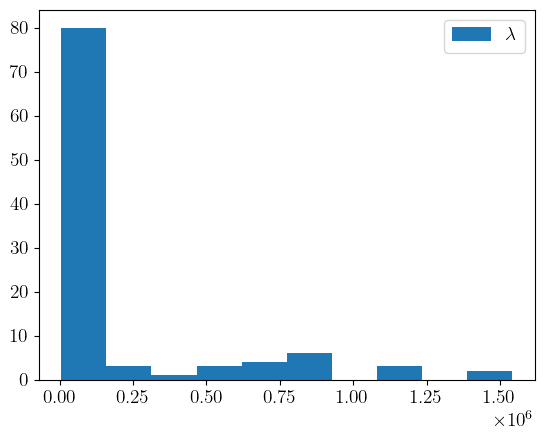

In [189]:
plt.hist(df['true_objective_func'], label='$\lambda$')
plt.legend()

In [190]:
param_names = list(PARAM_DICT.keys())
params = [param_name.split(':')[1] for param_name in param_names]
print(params)
print(len(params))

['aLund', 'bLund', 'aExtraSQuark', 'sigma', 'enhancedFraction', 'ProbStoUD', 'probQQtoQ', 'probSQtoQQ', 'alphaSvalue', 'pTmin']
10


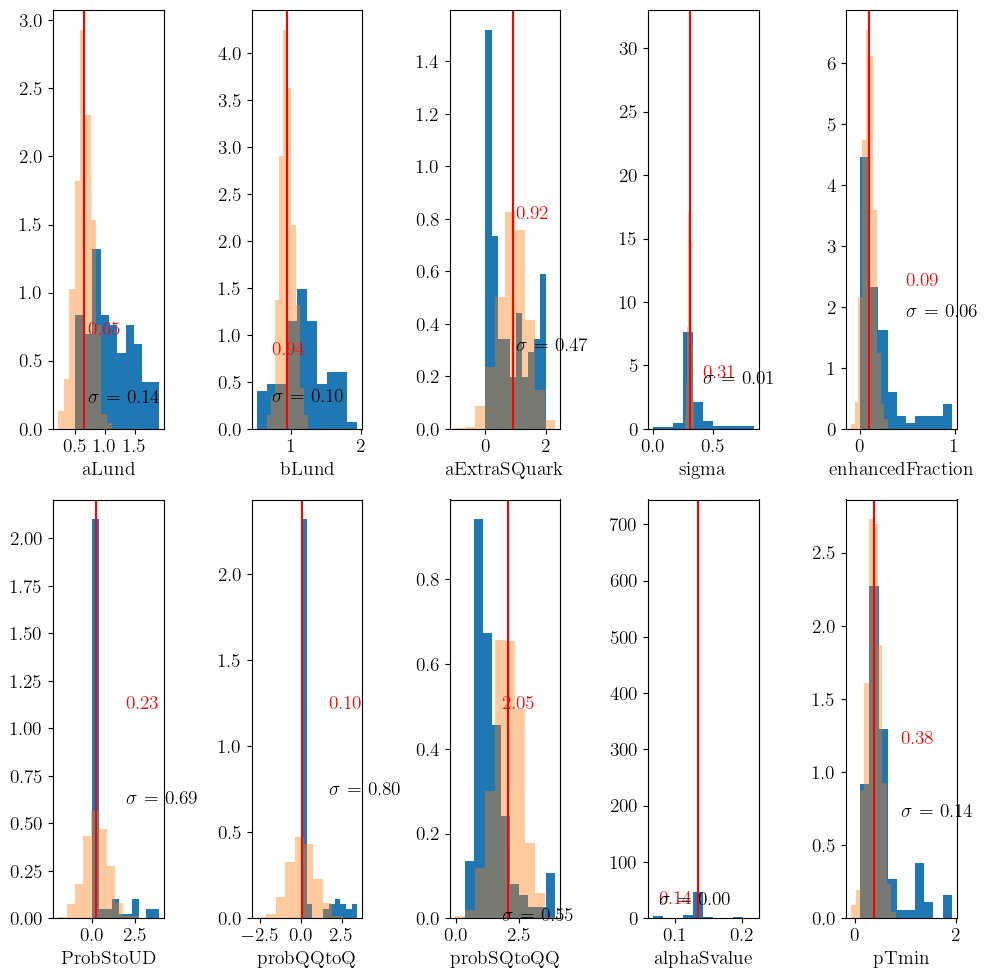

In [191]:
param_vals = [df[param] for param in params]
full_vals = np.stack(param_vals)
full_cov = np.cov(full_vals)

fig, ax = plt.subplots(2,5, figsize=(10,10))
ax = ax.ravel()
stds = np.diagonal(full_cov)
for i, param in enumerate(params):
    vals = df[param].values
    std2 = stds[i]
    ax[i].hist(vals, density=True)
    ax[i].set_xlabel(param)
    best_param = best_parameters_reduced[param]
    ax[i].axvline(x=best_param, color = 'r')
    x_pos = (vals.max() - vals.min())/2
    y_pos = (ax[i].get_ylim()[1] - ax[i].get_ylim()[0])/2
    ax[i].text(y=y_pos, x=x_pos, s=f'{best_param:.2f}', color='r')
    ax[i].text(y=y_pos - 0.5, x=x_pos, s=f'$\sigma$ = {std2:.2f}', color='k')
    gauss = np.random.normal(best_param, std2, size=1000)
    ax[i].hist(gauss, density=True, alpha=0.4)
plt.tight_layout()

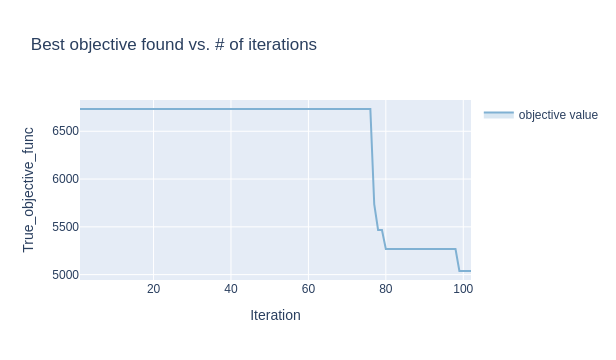

In [192]:
render(ax_client.get_optimization_trace())

[INFO 06-06 15:32:00] ax.service.ax_client: Retrieving contour plot with parameter 'aLund' on X-axis and 'bLund' on Y-axis, for metric 'true_objective_func'. Remaining parameters are affixed to the middle of their range.


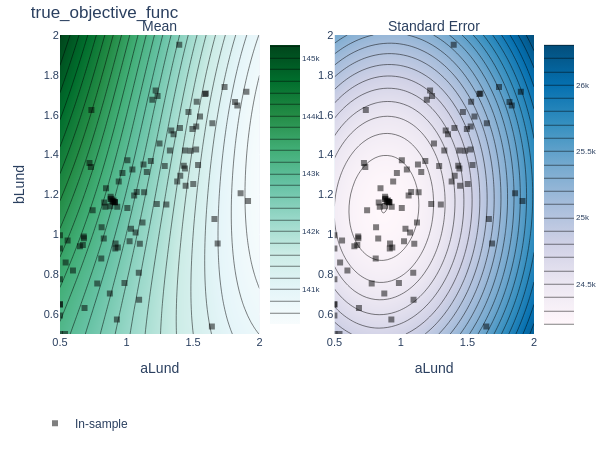

In [193]:
import plotly.graph_objects as go

# fig = go.Figure()
# fig.add_trace(
render(ax_client.get_contour_plot(param_x="aLund", param_y="bLund",))
# )


# fig.show()
# fig.write_image("images/Lund_a_b_countour.pdf")

[INFO 06-06 15:32:23] ax.service.ax_client: Retrieving contour plot with parameter 'aLund' on X-axis and 'sigma' on Y-axis, for metric 'true_objective_func'. Remaining parameters are affixed to the middle of their range.


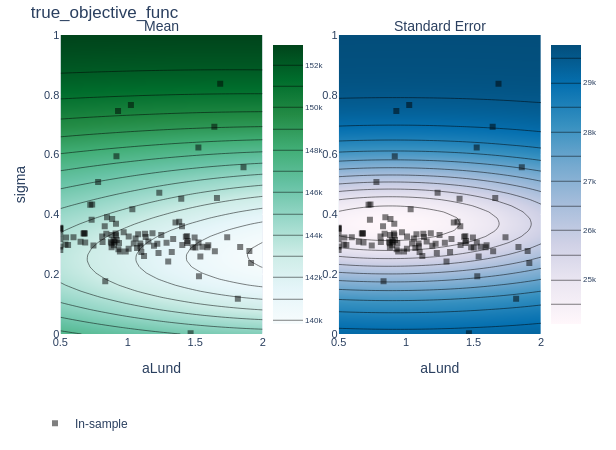

In [194]:
render(ax_client.get_contour_plot(param_x="aLund", param_y="sigma",))

[INFO 06-06 15:32:31] ax.service.ax_client: Retrieving contour plot with parameter 'aExtraSQuark' on X-axis and 'sigma' on Y-axis, for metric 'true_objective_func'. Remaining parameters are affixed to the middle of their range.


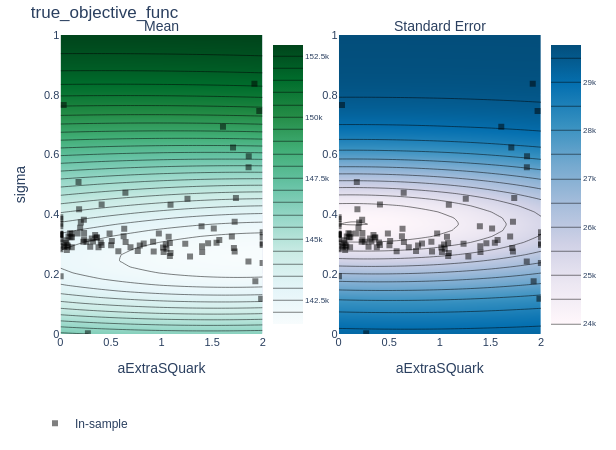

In [195]:
render(ax_client.get_contour_plot(param_x="aExtraSQuark", param_y="sigma",))

[INFO 06-06 15:33:01] ax.service.ax_client: Retrieving contour plot with parameter 'probQQtoQ' on X-axis and 'sigma' on Y-axis, for metric 'true_objective_func'. Remaining parameters are affixed to the middle of their range.


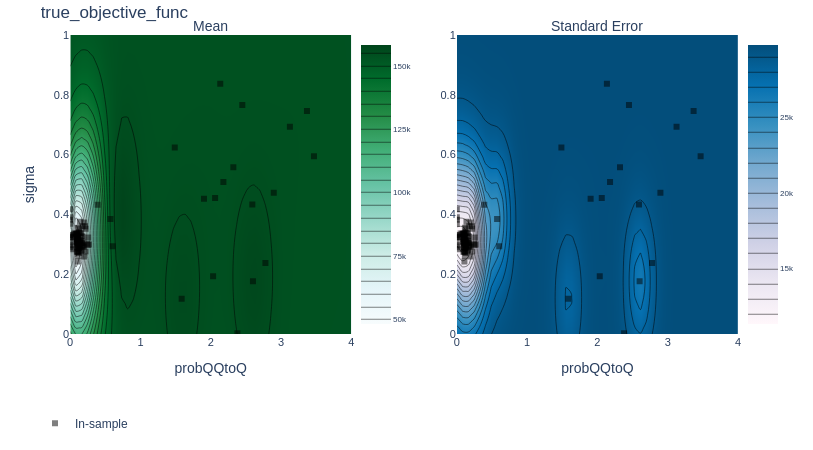

In [197]:
render(ax_client.get_contour_plot(param_x="probQQtoQ", param_y="sigma",))

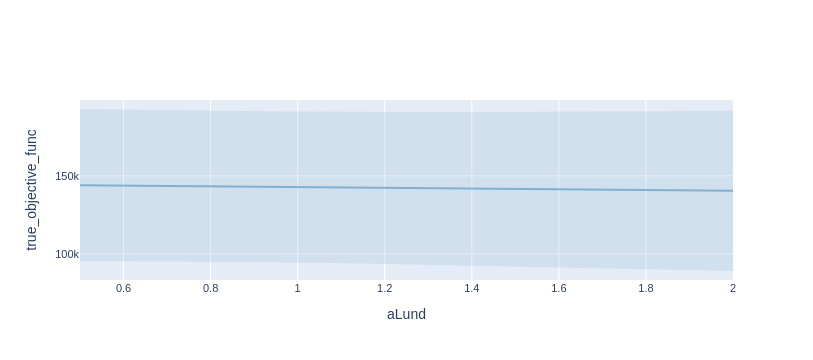

In [198]:
from ax.plot.slice import plot_slice

model = ax_client.generation_strategy.model
render(plot_slice(model, "aLund", "true_objective_func"))

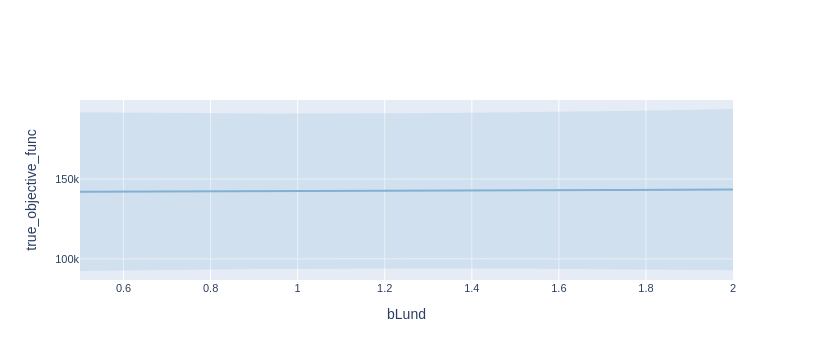

In [199]:
render(plot_slice(model, "bLund", "true_objective_func"))

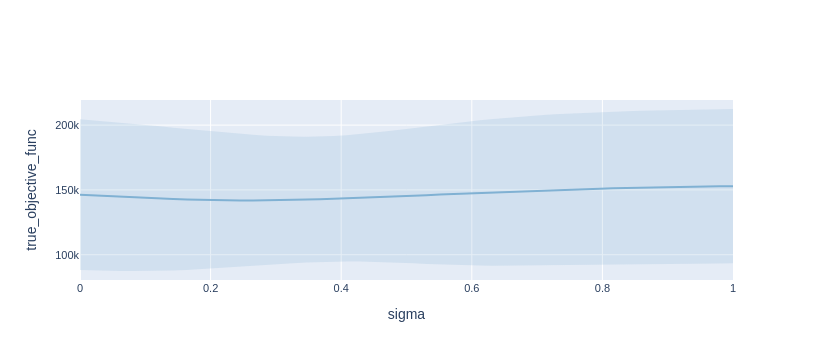

In [200]:
render(plot_slice(model, "sigma", "true_objective_func"))

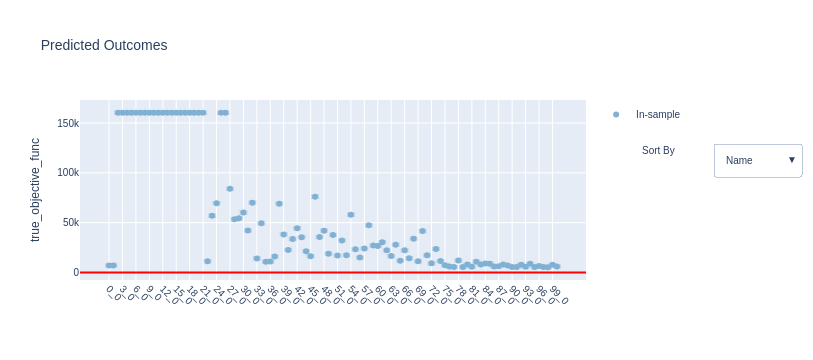

In [201]:
from ax.plot.scatter import plot_fitted
render(plot_fitted(model, metric="true_objective_func", rel=False))

In [202]:
ax_client.get_best_trial()

(101,
 {'aLund': 0.6500049858724484,
  'bLund': 0.9401929253219509,
  'aExtraSQuark': 0.9168928775652091,
  'sigma': 0.30812601635724085,
  'enhancedFraction': 0.09376606126317734,
  'ProbStoUD': 0.22732590820741946,
  'probQQtoQ': 0.09828054814612876,
  'probSQtoQQ': 2.0547395267064457,
  'alphaSvalue': 0.135045793331446,
  'pTmin': 0.3779248422937622},
 ({'true_objective_func': 5282.246758142166},
  {'true_objective_func': {'true_objective_func': 307167.44665173726}}))

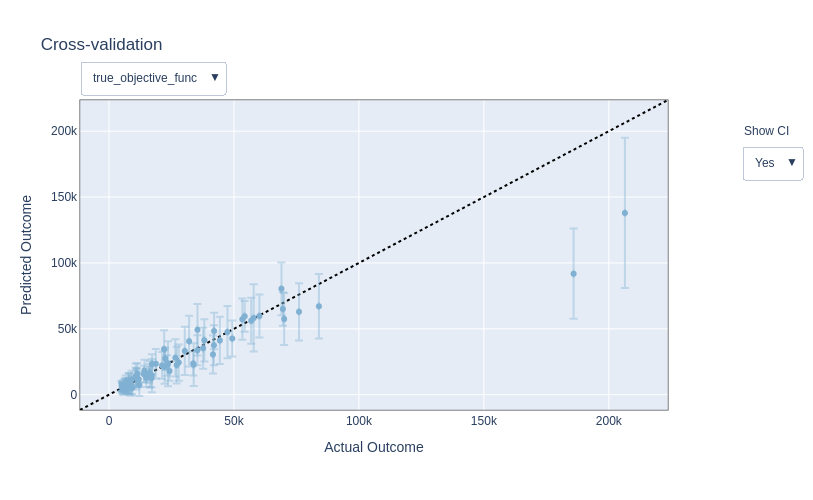

In [203]:
from ax.modelbridge.cross_validation import cross_validate
from ax.plot.diagnostic import interact_cross_validation

cv_results = cross_validate(model)
render(interact_cross_validation(cv_results))

----

## Validate the results

1. Make the pythia card with the best parameters based on the Bayesian Optimization above
2. Run the pythia card with 300,000 events yielding a test.yoda validation output
3. convert yoda histograms to pandas dataframes, filter histograms and plot result agreement with data

In [204]:
def make_pythia_valid_card(best_parameters):
    
    cards_dir = os.path.join(os.getcwd(), "BO_Cards")
    filename = f"ALEPH_1996_S3486095_BO_card_valid.cmnd"
    file_path = os.path.join(cards_dir, filename)
    with open(file_path,'w') as f:
        first_block="""Main:numberOfEvents = 250000          ! number of events to generate
Next:numberShowEvent = 0           ! suppress full listing of first events
# random seed
Random:setSeed = on
Random:seed= 0
! 2) Beam parameter settings.
Beams:idA = 11                ! first beam,  e- = 11
Beams:idB = -11                ! second beam, e+ = -11
Beams:eCM = 91.2               ! CM energy of collision
# Pythia 8 settings for LEP
# Hadronic decays including b quarks, with ISR photons switched off
WeakSingleBoson:ffbar2gmZ = on
23:onMode = off
23:onIfAny = 1 2 3 4 5
PDF:lepton = off
SpaceShower:QEDshowerByL = off\n\n"""
        f.write(first_block)
        # f.write(f"Random:seed={indx+1}")

        f.write("StringZ:aLund = {}\n\n".format(best_parameters["aLund"]))
        f.write("StringZ:bLund = {}\n\n".format(best_parameters["bLund"]))
        # f.write("StringZ:rFactC = {}\n\n".format(best_parameters["rFactC"]))
        # f.write("StringZ:rFactB = {}\n\n".format(best_parameters["rFactB"]))
        f.write("StringZ:aExtraSQuark = {}\n\n".format(best_parameters["aExtraSQuark"]))
        # f.write("StringZ:aExtraDiquark = {}\n\n".format(best_parameters["aExtraDiquark"]))
        f.write("StringPT:sigma = {}\n\n".format(best_parameters["sigma"]))
        f.write("StringPT:enhancedFraction = {}\n\n".format(best_parameters["enhancedFraction"]))
        # f.write("StringPT:enhancedWidth = {}\n\n".format(best_parameters["enhancedWidth"]))
        f.write("StringFlav:ProbStoUD = {}\n\n".format(best_parameters["ProbStoUD"]))
        f.write("StringFlav:probQQtoQ = {}\n\n".format(best_parameters["probQQtoQ"]))
        f.write("StringFlav:probSQtoQQ = {}\n\n".format(best_parameters["probSQtoQQ"]))
        # f.write("StringFlav:ProbQQ1toQQ0 = {}\n\n".format(best_parameters["ProbQQ1toQQ0"]))
        f.write("TimeShower:alphaSvalue = {}\n\n".format(best_parameters["alphaSvalue"]))
        f.write("TimeShower:pTmin = {}\n\n".format(best_parameters["pTmin"]))
def run_valid_card(best_parameters):
    
    # step 1: write .cmnd file 
    make_pythia_valid_card(best_parameters)
    #step 2 run main42 and rivet
    os.system("""./main42 BO_Cards/ALEPH_1996_S3486095_BO_card_valid.cmnd /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card_valid.fifo
    rivet -o ALEPH_1996_S3486095_hist_valid_0.yoda -a ALEPH_1996_S3486095 /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card_valid.fifo

    rm /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card_valid.fifo
    mv ALEPH_1996_S3486095_hist_valid_0.yoda ALEPH_YODAS_BayesOpt/""")

In [205]:
run_valid_card(best_parameters_reduced)


 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card_valid.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card_valid.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the Lund Monte Carlo!  |  | 
 |  |   P  P   Y Y     T    H   H   I    A A     This is PYTHIA version 8.309      |  | 
 |  |   PPP     Y      T    HHHHH   I   AAAAA    Last date of change: 16 Feb 2023  |  | 
 |  |   P       Y      T    H   H   I   A   A                                      |

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 15:38:16
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card_valid.fifo'
Event 100 (0:00:00 elapsed)
Event 200 (0:00:00 elapsed)
Event 300 (0:00:00 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:01 elapsed)
Event 900 (0:00:01 elapsed)
Event 1000 (0:00:01 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:02 elapsed)
Event 1600 (0:00:02 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:03 elapsed)
Event 1900 (0:00:03 elapsed)
Event 2000 (0:00:03 elapsed)
Event 2100 (0:00:03 elapsed)
Event 2200 (0:00:03 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:04 elapsed)
Event 2600 (0:00:04 elapsed)
Event 2700 (0:00:04 elapsed)
Event 2800 (0:00:04 elapsed)
Event 2900 (0:00:04 elapsed)
Event 3000 (0





Rivet.AnalysisHandler: INFO  Using named weights


In [206]:
importlib.reload(yoda2numpy_BayesOpt)
from yoda2numpy_BayesOpt import Yoda2Numpy

def get_valid_data():
    # tracemalloc.start()
    yoda2numpy = Yoda2Numpy()
    files = list(glob('ALEPH_YODAS_BayesOpt/*.yoda'))
    M = len(files)
    # M = 
    generated_indices = []
    for file in files[:M]:
        index = file.split('_')[-1].split('.')[0]
        generated_indices.append(int(index))    
    generated_indices.sort()
    print(generated_indices)
    # # --- SIM
    print(f'looping over {M:d} sim yoda files...\n')
    # dfsims = []
    dfsims_valid = {}
    for ii in tqdm(generated_indices):    
        # index here should match the index of the file
        # dfsims.append( yoda2numpy.todf( yoda2numpy('sim', index=ii) ) )
        dfsims_valid[ii]= yoda2numpy.todf( yoda2numpy('val', index=ii) ) 

    # # --- NEW
    # print(f'looping over {M:d} new yoda files...\n')
    # # dfnews = []
    # # for ii in tqdm(range(M)):
    # #     dfnews.append( yoda2numpy.todf( yoda2numpy('new', index=ii) ) )

    print()
    # key = '/ALEPH_1996_S3486095/d01-x01-y01'
    # dfsim = dfsims[0][key]
    
    dfdata = yoda2numpy.todf( yoda2numpy('dat') )
    
    return dfdata, dfsims_valid, generated_indices

In [207]:
dfdata, dfsims_valid, generated_indices = get_valid_data()

[0, 0]
looping over 2 sim yoda files...



  0%|                                                                                                                                                                                        | 0/2 [00:00<?, ?it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_valid_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  5.75it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_valid_0.yoda

using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


In [208]:
print(generated_indices)
# print(dfsims)
print('DATA DATAFRAME')
print(dfdata['/REF/ALEPH_1996_S3486095/d01-x01-y01'].head())
print('FIRST SIM-VALID DATAFRAME')
print(dfsims_valid[generated_indices[0]]['/ALEPH_1996_S3486095/d01-x01-y01'].head())

[0, 0]
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM-VALID DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  11.676000  0.009341  0.040054  0.030145     14595.0
1  0.005  0.010  23.655199  0.018924  0.177620  0.276473     29569.0
2  0.010  0.015  21.341600  0.017073  0.265181  0.667883     26677.0
3  0.015  0.020  17.384800  0.013908  0.302801  1.062028     21731.0
4  0.020  0.025  13.728800  0.010983  0.307631  1.384390     17161.0


In [209]:
data_keys, mc_keys = get_hist_names(dfdata)
filtered_data_keys, filtered_mc_keys = filter_keys(dfdata, dfsims_valid, data_keys, mc_keys)

 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

In [210]:
reduced_data_keys, reduced_mc_keys = reduce_filtered_keys(filtered_data_keys, filtered_mc_keys)
print(reduced_data_keys, reduced_mc_keys)
print(f'length of reduced data keys = {len(reduced_data_keys)}')
print(f'length of reduced mc keys = {len(reduced_mc_keys)}')

['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S3486095/d37-x01-y01',

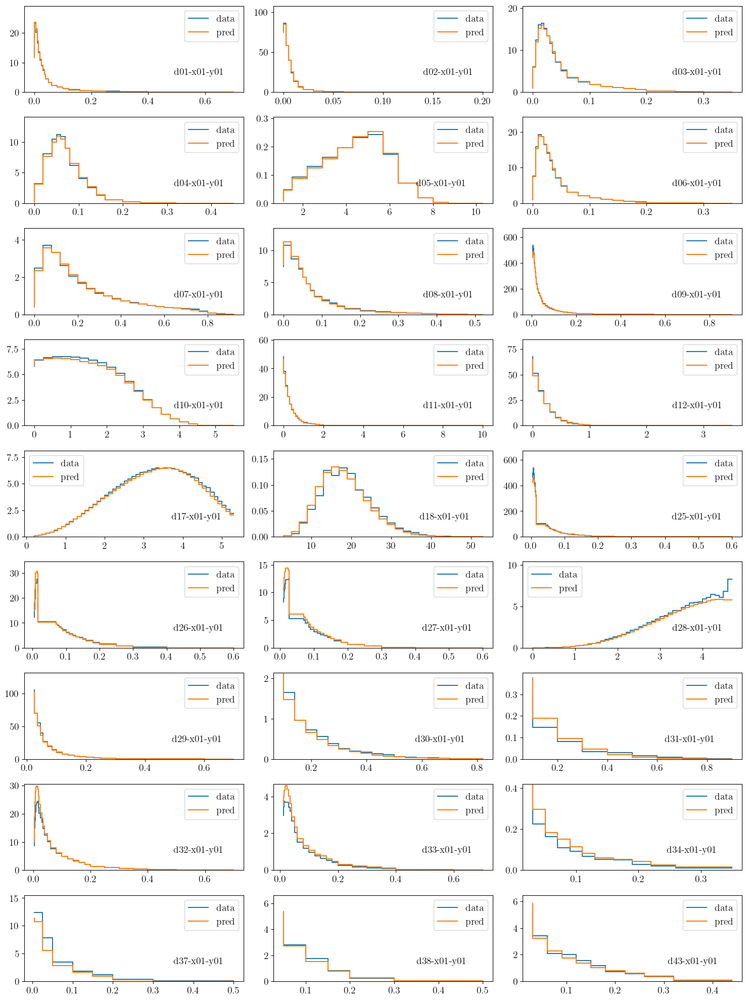

In [211]:
importlib.reload(pythia_SBI_utils)
from pythia_SBI_utils import * 

hists = make_hists(dfdata, dfsims_valid[0], reduced_data_keys, reduced_mc_keys)

plot_dist(reduced_data_keys, hists, filename=f'images/Ax_BayesianOpt_Valid_Best_fit_hists_reduced_params_{N_ITER}_iter.pdf')

In [212]:
def plot_model_chi2_vs_param(param, reference_dict, ax):
    PARAM_DICT_small = {key.split(':')[1] : val for key,val in PARAM_DICT.items()}
    # param = 'aLund'
    N_points = 1000
    # reference_dict = MONASH_DICT
    aLund_linspace =  np.linspace(PARAM_DICT_small[param][0], PARAM_DICT_small[param][1], N_points)
    aLund_observation_dicts = []
    for val in aLund_linspace:
        new_dict = reference_dict.copy()
        new_dict[param] = val
        aLund_observation_dicts.append(new_dict)
    
    means_a, covs_a = model.predict([
            ObservationFeatures(parameters=pointi) for pointi in aLund_observation_dicts
        ]
    )

    chi2_means = np.array(list(means_a.values())[0])
    chi2_covs = np.array(covs_a['true_objective_func']['true_objective_func'])
    
    ax.plot(aLund_linspace, chi2_means, c='k', linewidth=3)

    ax.set_ylim(0, chi2_means.max())
    ypos = (ax.get_ylim()[1] -ax.get_ylim()[0])/2
    xpos = best_parameters_reduced[param] + 0.05
    ax.text(x= xpos, y=ypos, s= '{:.3f}'.format(best_parameters_reduced[param]), color='r')
    ax.fill_between(x=aLund_linspace, y1=chi2_means-chi2_covs,y2=chi2_means+chi2_covs, alpha=0.3, color='b')
    ax.set_xlabel(param, fontsize=22)
    ax.set_ylabel('GP $\lambda$', fontsize=22)
    ax.scatter(df[param], df['true_objective_func'], color='green')
    ax.axvline(x=best_parameters_reduced[param], color='r')

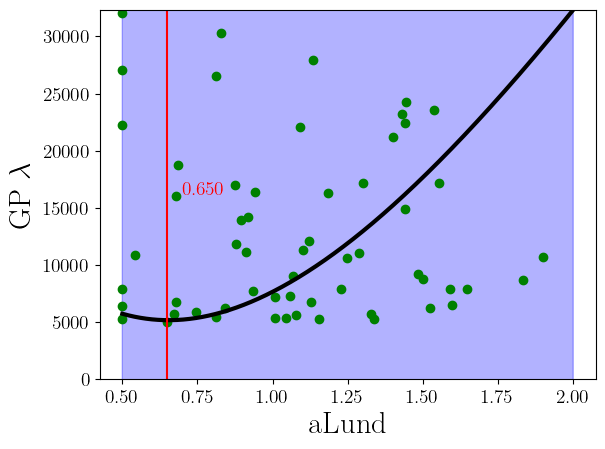

In [213]:
fig, ax = plt.subplots(1,1)
plot_model_chi2_vs_param(param='aLund', reference_dict=best_parameters_reduced, ax=ax)

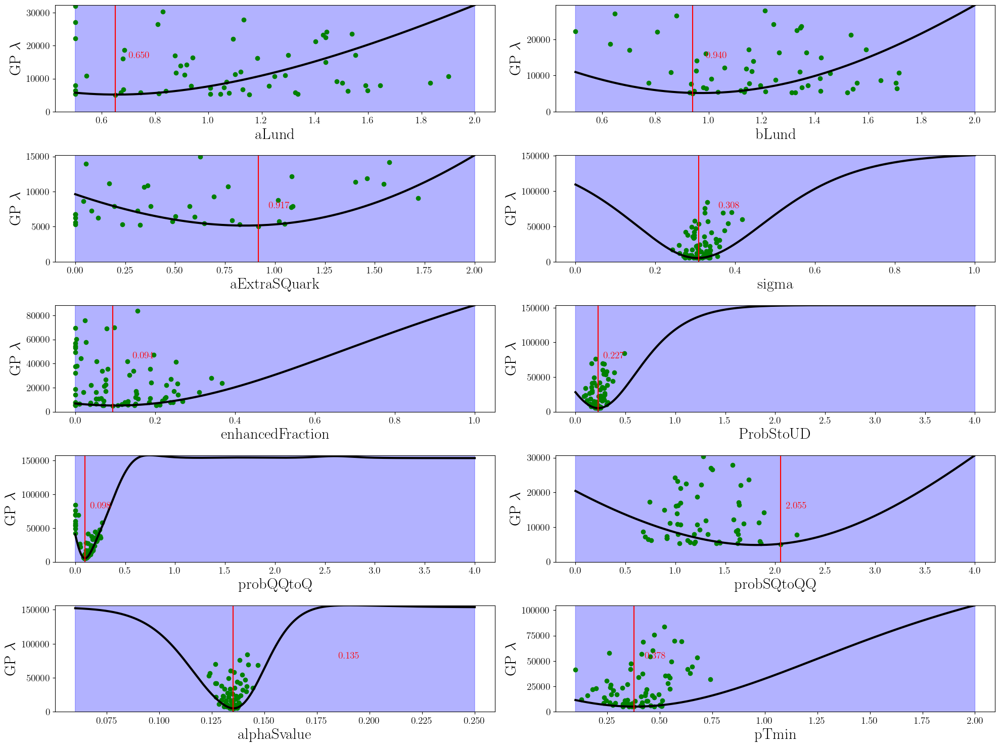

In [214]:
fig, ax = plt.subplots(5, 2, figsize=(20,15))
ax = ax.ravel()
for i, axi in enumerate(ax):
    params = list(REDUCED_MONASH_DICT.keys())
    plot_model_chi2_vs_param(param=params[i], reference_dict=best_parameters_reduced, ax=axi)

plt.tight_layout()
plt.savefig(f'images/GP_lambda_vs_param_all_params.pdf')

# Get profile likelihood of each parameter with Minuit, and the total covariance matrix

In [215]:
import iminuit
from iminuit import Minuit

In [216]:
def cost_func(aLund, 
             bLund,
            aExtraSQuark,
            sigma,
            enhancedFraction,
            ProbStoUD,
            probQQtoQ,
            probSQtoQQ,
            alphaSvalue,
            pTmin):
    
    params_dict = {
    "aLund" : aLund, 
    "bLund" : bLund,
    "aExtraSQuark": aExtraSQuark,
    "sigma":sigma,
    "enhancedFraction":enhancedFraction,
    "ProbStoUD":ProbStoUD,
    "probQQtoQ":probQQtoQ,
    "probSQtoQQ":probSQtoQQ,
    "alphaSvalue": alphaSvalue,
    "pTmin": pTmin
    }
    means, covs = model.predict([
            ObservationFeatures(parameters=params_dict)
        ]
    )
    return means['true_objective_func'][0]

In [251]:
# mean value func at BO point
cost_func(**best_parameters_reduced)

5184.530222962749

In [218]:
limits = list(PARAM_DICT.values())

In [219]:
m = Minuit(cost_func, **best_parameters_reduced)
m.limits = limits

In [220]:
m.migrad(ncall=500000)

┌─────────────────────────────────────────────────────────────────────────┐
│                                Migrad                                   │
├──────────────────────────────────┬──────────────────────────────────────┤
│ FCN = 4532                       │              Nfcn = 366              │
│ EDM = 9.36e-06 (Goal: 0.0002)    │            time = 0.5 sec            │
├──────────────────────────────────┼──────────────────────────────────────┤
│          Valid Minimum           │   Below EDM threshold (goal x 10)    │
├──────────────────────────────────┼──────────────────────────────────────┤
│      No parameters at limit      │           Below call limit           │
├──────────────────────────────────┼──────────────────────────────────────┤
│             Hesse ok             │         Covariance accurate          │
└──────────────────────────────────┴──────────────────────────────────────┘
┌───┬──────────────────┬───────────┬───────────┬────────────┬────────────┬─────────┬─────────┬───────┐
│   │ Name             │   Value   │ Hesse Err │ Minos Err- │ Minos Err+ │ Limit-  │ Limit+  │ Fixed │
├───┼──────────────────┼───────────┼───────────┼────────────┼────────────┼─────────┼─────────┼───────┤
│ 0 │ aLund            │   0.578   │   0.011   │            │            │   0.5   │    2    │       │
│ 1 │ bLund            │   0.960   │   0.008   │            │            │   0.5   │    2    │       │
│ 2 │ aExtraSQuark     │   0.537   │   0.035   │            │            │    0    │    2    │       │
│ 3 │ sigma            │  0.3199   │  0.0016   │            │            │    0    │    1    │       │
│ 4 │ enhancedFraction │   0.036   │   0.007   │            │            │    0    │    1    │       │
│ 5 │ ProbStoUD        │  0.2330   │  0.0015   │            │            │    0    │    4    │       │
│ 6 │ probQQtoQ        │  96.8e-3  │  0.6e-3   │            │            │    0    │    4    │       │
│ 7 │ probSQtoQQ       │   1.594   │   0.030   │            │            │    0    │    4    │       │
│ 8 │ alphaSvalue      │ 136.22e-3 │  0.11e-3  │            │            │  0.06   │  0.25   │       │
│ 9 │ pTmin            │   0.430   │   0.006   │            │            │   0.1   │    2    │       │
└───┴──────────────────┴───────────┴───────────┴────────────┴────────────┴─────────┴─────────┴───────┘
┌──────────────────┬───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────┐
│                  │            aLund            bLund     aExtraSQuark            sigma enhancedFraction        ProbStoUD        probQQtoQ       probSQtoQQ      alphaSvalue            pTmin │
├──────────────────┼───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────┤
│            aLund │         0.000123          0.06e-3          0.23e-3         -11.0e-6          0.05e-3          -4.2e-6          -1.9e-6          0.18e-3        -0.742e-6         -0.04e-3 │
│            bLund │          0.06e-3         7.07e-05          0.12e-3          -5.9e-6          0.03e-3          -1.9e-6          -1.5e-6          0.09e-3        -0.372e-6         -0.02e-3 │
│     aExtraSQuark │          0.23e-3          0.12e-3          0.00123         -49.8e-6          0.21e-3          -7.0e-6          -4.8e-6           0.9e-3        -2.929e-6         -0.17e-3 │
│            sigma │         -11.0e-6          -5.9e-6         -49.8e-6         2.61e-06          -9.6e-6           0.4e-6           0.3e-6         -41.0e-6         0.144e-6           7.7e-6 │
│ enhancedFraction │          0.05e-3          0.03e-3          0.21e-3          -9.6e-6          4.5e-05          -1.9e-6          -1.2e-6          0.17e-3        -0.585e-6         -0.03e-3 │
│        ProbStoUD │          -4.2e-6          -1.9e-6          -7.0e-6           0.4e-6          -1.9

In [221]:
best_parameters_reduced

{'aLund': 0.6500049858724484,
 'bLund': 0.9401929253219509,
 'aExtraSQuark': 0.9168928775652091,
 'sigma': 0.30812601635724085,
 'enhancedFraction': 0.09376606126317734,
 'ProbStoUD': 0.22732590820741946,
 'probQQtoQ': 0.09828054814612876,
 'probSQtoQQ': 2.0547395267064457,
 'alphaSvalue': 0.135045793331446,
 'pTmin': 0.3779248422937622}

In [222]:
m.minos()

┌─────────────────────────────────────────────────────────────────────────┐
│                                Migrad                                   │
├──────────────────────────────────┬──────────────────────────────────────┤
│ FCN = 4532                       │             Nfcn = 2158              │
│ EDM = 9.36e-06 (Goal: 0.0002)    │            time = 1.7 sec            │
├──────────────────────────────────┼──────────────────────────────────────┤
│          Valid Minimum           │   Below EDM threshold (goal x 10)    │
├──────────────────────────────────┼──────────────────────────────────────┤
│      No parameters at limit      │           Below call limit           │
├──────────────────────────────────┼──────────────────────────────────────┤
│             Hesse ok             │         Covariance accurate          │
└──────────────────────────────────┴──────────────────────────────────────┘
┌───┬──────────────────┬───────────┬───────────┬────────────┬────────────┬─────────┬─────────┬───────┐
│   │ Name             │   Value   │ Hesse Err │ Minos Err- │ Minos Err+ │ Limit-  │ Limit+  │ Fixed │
├───┼──────────────────┼───────────┼───────────┼────────────┼────────────┼─────────┼─────────┼───────┤
│ 0 │ aLund            │   0.578   │   0.011   │   -0.011   │   0.011    │   0.5   │    2    │       │
│ 1 │ bLund            │   0.960   │   0.008   │   -0.008   │   0.009    │   0.5   │    2    │       │
│ 2 │ aExtraSQuark     │   0.537   │   0.035   │   -0.034   │   0.035    │    0    │    2    │       │
│ 3 │ sigma            │  0.3199   │  0.0016   │  -0.0016   │   0.0016   │    0    │    1    │       │
│ 4 │ enhancedFraction │   0.036   │   0.007   │   -0.006   │   0.007    │    0    │    1    │       │
│ 5 │ ProbStoUD        │  0.2330   │  0.0015   │  -0.0015   │   0.0015   │    0    │    4    │       │
│ 6 │ probQQtoQ        │  96.8e-3  │  0.6e-3   │  -0.6e-3   │   0.6e-3   │    0    │    4    │       │
│ 7 │ probSQtoQQ       │   1.594   │   0.031   │   -0.030   │   0.030    │    0    │    4    │       │
│ 8 │ alphaSvalue      │ 136.22e-3 │  0.11e-3  │  -0.11e-3  │  0.11e-3   │  0.06   │  0.25   │       │
│ 9 │ pTmin            │   0.430   │   0.006   │   -0.006   │   0.006    │   0.1   │    2    │       │
└───┴──────────────────┴───────────┴───────────┴────────────┴────────────┴─────────┴─────────┴───────┘
┌──────────┬───────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┬───────────────────────┐
│          │         aLund         │         bLund         │     aExtraSQuark      │         sigma         │   enhancedFraction    │       ProbStoUD       │       probQQtoQ       │      probSQtoQQ       │      alphaSvalue      │         pTmin         │
├──────────┼───────────┬───────────┼───────────┬───────────┼───────────┬───────────┼───────────┬───────────┼───────────┬───────────┼───────────┬───────────┼───────────┬───────────┼───────────┬───────────┼───────────┬───────────┼───────────┬───────────┤
│  Error   │  -0.011   │   0.011   │  -0.008   │   0.009   │  -0.034   │   0.035   │  -0.0016  │  0.0016   │  -0.006   │   0.007   │  -0.0015  │  0.0015   │  -0.6e-3  │  0.6e-3   │   -0.03   │   0.03    │ -0.11e-3  │  0.11e-3  │  -0.006   │   0.006   │
│  Valid   │   True    │   True    │   True    │   True    │   True    │   True    │   True    │   True    │   True    │   True    │   True    │   True    │   True    │   True    │   True    │   True    │   True    │   True    │   True    │   True    │
│ At Limit │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │
│ Max FCN  │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False   │   False

In [260]:
cost_func_at_BO = cost_func(**best_parameters_reduced)
print(f'cost function at BO point = {cost_func_at_BO}')
scale_vals = [1.05,1.1]
for scale in scale_vals:
    scaled_point_BO = {}
    for key, val in best_parameters_reduced.items():
        scaled_point_BO[key] = val * scale
    print()
    print(f'cost function at BO point scaled by {scale} = {cost_func(**scaled_point_BO)}')


cost function at BO point = 5184.530222962749

cost function at BO point scaled by 1.05 = 17634.119297232246

cost function at BO point scaled by 1.1 = 50598.71060815499


In [261]:
minos_points = m.values.to_dict()
minos_points

{'aLund': 0.5778117622792757,
 'bLund': 0.9600374450150893,
 'aExtraSQuark': 0.537231133686081,
 'sigma': 0.3199225654263836,
 'enhancedFraction': 0.03614626382569172,
 'ProbStoUD': 0.23304917378354353,
 'probQQtoQ': 0.09676983002509686,
 'probSQtoQQ': 1.5935087782247985,
 'alphaSvalue': 0.13622136230557338,
 'pTmin': 0.43017166568309007}

In [262]:
cost_func_at_minuit = cost_func(**minos_points)
print(f'cost function at Minuit point = {cost_func_at_minuit}')
scale_vals = [1.05,1.1]
for scale in scale_vals:
    scaled_point_minuit = {}
    for key, val in minos_points.items():
        scaled_point_minuit[key] = val * scale
    print()
    print(f'cost function at Minuit point scaled by {scale} = {cost_func(**scaled_point_minuit)}')


cost function at Minuit point = 4532.204663255259

cost function at Minuit point scaled by 1.05 = 18386.942152152253

cost function at Minuit point scaled by 1.1 = 54476.715480456645


Minos is deeper minimum than BO

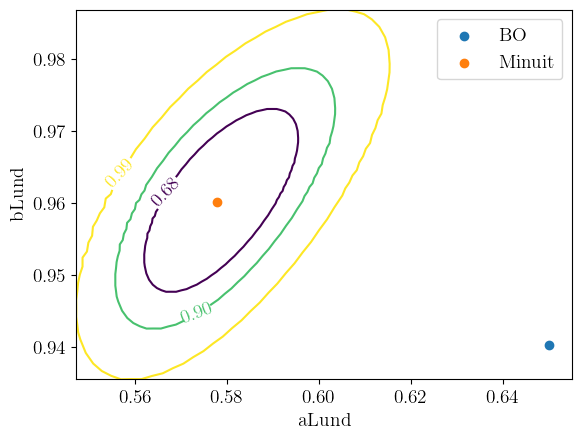

In [264]:
m.draw_mncontour('aLund','bLund', cl=(0.68, 0.9, 0.99))
plt.scatter(best_parameters_reduced['aLund'], best_parameters_reduced['bLund'], label='BO')
plt.scatter(m.values['aLund'], m.values['bLund'], label='Minuit')
plt.legend()

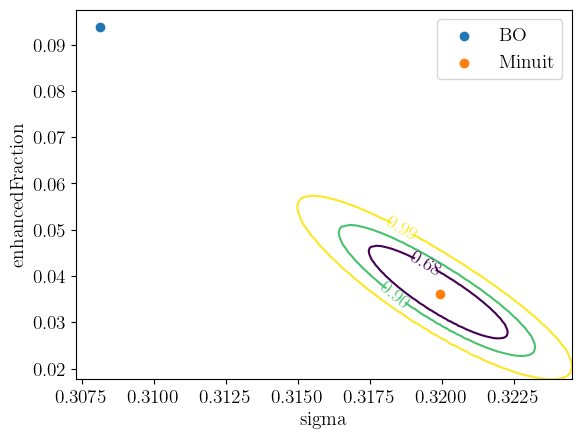

In [227]:
m.draw_mncontour('sigma','enhancedFraction', cl=(0.68, 0.9, 0.99))
plt.scatter(best_parameters_reduced['sigma'], best_parameters_reduced['enhancedFraction'], label='BO')
plt.scatter(m.values['sigma'], m.values['enhancedFraction'], label='Minuit')
plt.legend()

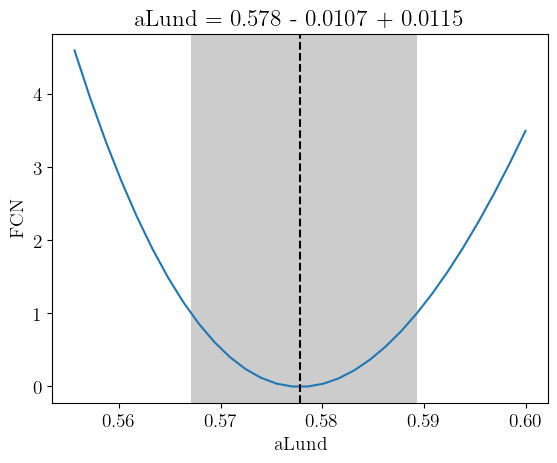

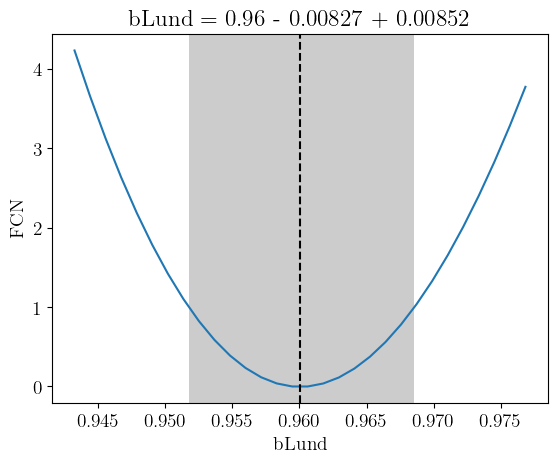

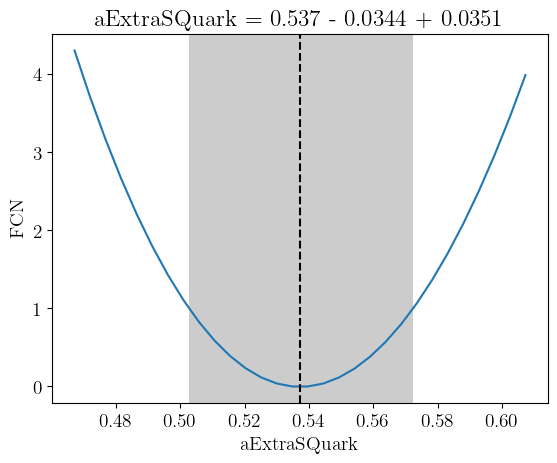

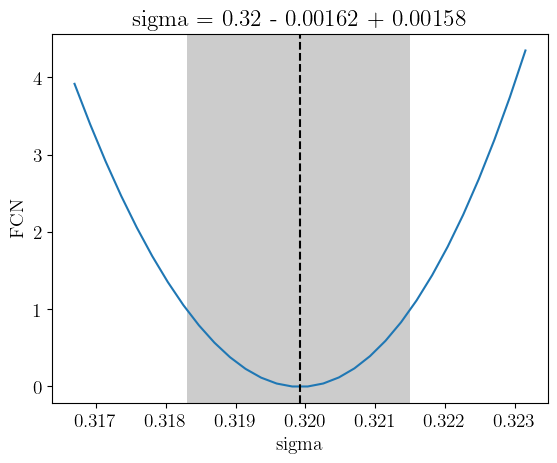

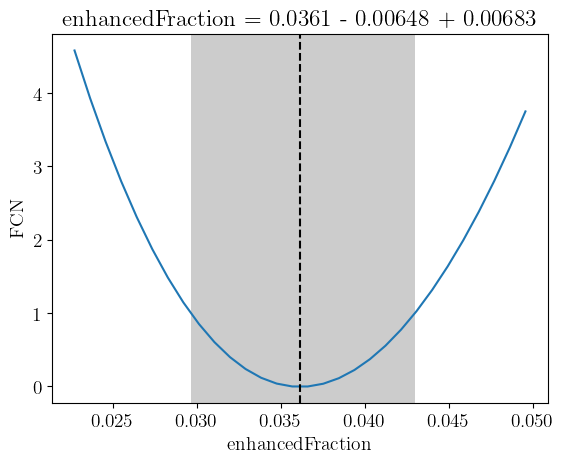

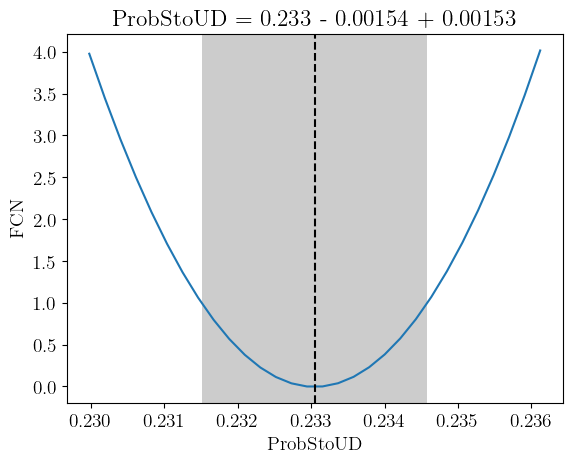

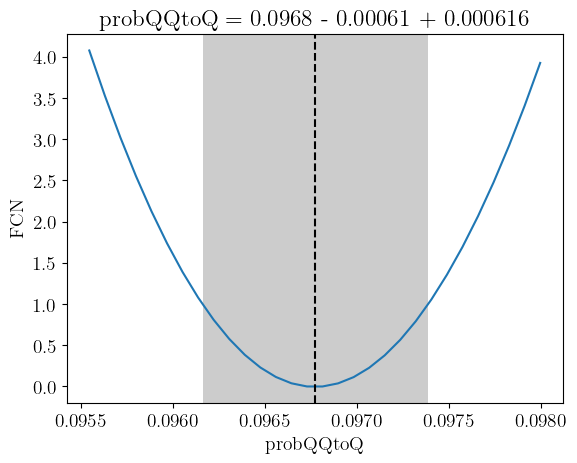

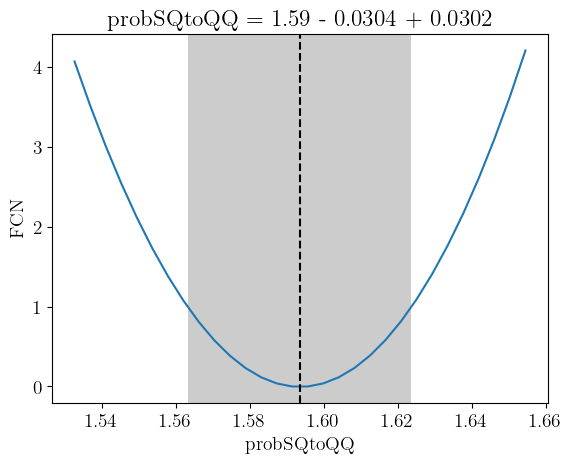

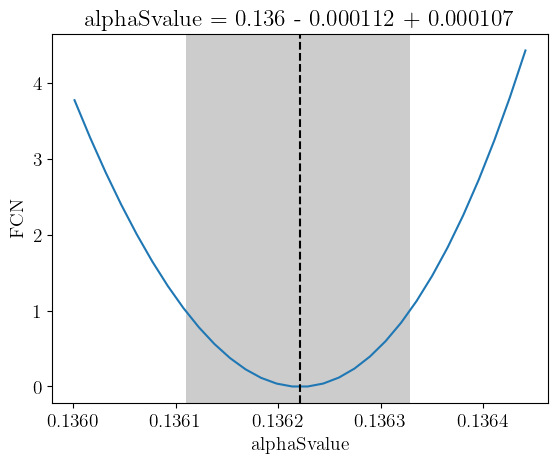

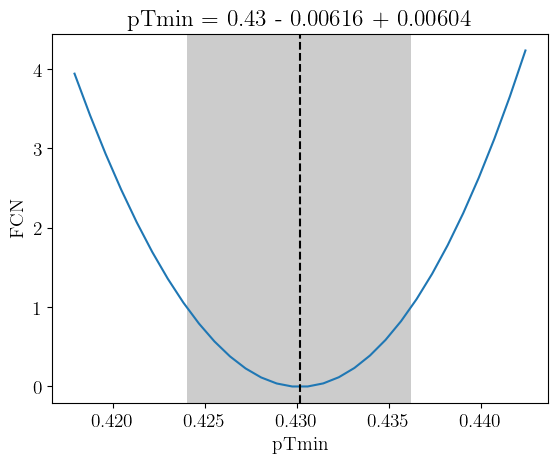

In [234]:
for param in params:
    plt.figure()
    m.draw_mnprofile(param)

In [229]:
covariance = m.covariance
covariance

,aLund,bLund,aExtraSQuark,sigma,enhancedFraction,ProbStoUD,probQQtoQ,probSQtoQQ,alphaSvalue,pTmin
aLund,0.000123,0.06e-3 (0.659),0.23e-3 (0.594),-11.0e-6 (-0.614),0.05e-3 (0.659),-4.2e-6 (-0.249),-1.9e-6 (-0.279),0.18e-3 (0.538),-0.742e-6 (-0.608),-0.04e-3 (-0.526)
bLund,0.06e-3 (0.659),7.07e-05,0.12e-3 (0.403),-5.9e-6 (-0.438),0.03e-3 (0.487),-1.9e-6 (-0.143),-1.5e-6 (-0.288),0.09e-3 (0.350),-0.372e-6 (-0.402),-0.02e-3 (-0.386)
aExtraSQuark,0.23e-3 (0.594),0.12e-3 (0.403),0.00123,-49.8e-6 (-0.880),0.21e-3 (0.890),-7.0e-6 (-0.130),-4.8e-6 (-0.224),0.9e-3 (0.871),-2.929e-6 (-0.759),-0.17e-3 (-0.800)
sigma,-11.0e-6 (-0.614),-5.9e-6 (-0.438),-49.8e-6 (-0.880),2.61e-06,-9.6e-6 (-0.885),0.4e-6 (0.145),0.3e-6 (0.301),-41.0e-6 (-0.832),0.144e-6 (0.812),7.7e-6 (0.773)
enhancedFraction,0.05e-3 (0.659),0.03e-3 (0.487),0.21e-3 (0.890),-9.6e-6 (-0.885),4.5e-05,-1.9e-6 (-0.185),-1.2e-6 (-0.290),0.17e-3 (0.846),-0.585e-6 (-0.792),-0.03e-3 (-0.776)
ProbStoUD,-4.2e-6 (-0.249),-1.9e-6 (-0.143),-7.0e-6 (-0.130),0.4e-6 (0.145),-1.9e-6 (-0.185),2.36e-06,-0.1e-6 (-0.099),-6.4e-6 (-0.138),0.030e-6 (0.177),1.2e-6 (0.127)
probQQtoQ,-1.9e-6 (-0.279),-1.5e-6 (-0.288),-4.8e-6 (-0.224),0.3e-6 (0.301),-1.2e-6 (-0.290),-0.1e-6 (-0.099),3.76e-07,-4.0e-6 (-0.213),0.027e-6 (0.406),0.8e-6 (0.216)
probSQtoQQ,0.18e-3 (0.538),0.09e-3 (0.350),0.9e-3 (0.871),-41.0e-6 (-0.832),0.17e-3 (0.846),-6.4e-6 (-0.138),-4.0e-6 (-0.213),0.000932,-2.483e-6 (-0.739),-0.14e-3 (-0.750)
alphaSvalue,-0.742e-6 (-0.608),-0.372e-6 (-0.402),-2.929e-6 (-0.759),0.144e-6 (0.812),-0.585e-6 (-0.792),0.030e-6 (0.177),0.027e-6 (0.406),-2.483e-6 (-0.739),1.21e-08,0.457e-6 (0.677)
pTmin,-0.04e-3 (-0.526),-0.02e-3 (-0.386),-0.17e-3 (-0.800),7.7e-6 (0.773),-0.03e-3 (-0.776),1.2e-6 (0.127),0.8e-6 (0.216),-0.14e-3 (-0.750),0.457e-6 (0.677),3.76e-05


In [230]:
covariance.correlation()

,aLund,bLund,aExtraSQuark,sigma,enhancedFraction,ProbStoUD,probQQtoQ,probSQtoQQ,alphaSvalue,pTmin
aLund,1,0.7,0.6,-0.6,0.7,-0.2,-0.3,0.5,-0.6,-0.5
bLund,0.7,1,0.4,-0.4,0.5,-0.1,-0.3,0.4,-0.4,-0.4
aExtraSQuark,0.6,0.4,1,-0.9,0.9,-0.1,-0.2,0.9,-0.8,-0.8
sigma,-0.6,-0.4,-0.9,1,-0.9,0.1,0.3,-0.8,0.8,0.8
enhancedFraction,0.7,0.5,0.9,-0.9,1,-0.2,-0.3,0.8,-0.8,-0.8
ProbStoUD,-0.2,-0.1,-0.1,0.1,-0.2,1,-0.1,-0.1,0.2,0.1
probQQtoQ,-0.3,-0.3,-0.2,0.3,-0.3,-0.1,1,-0.2,0.4,0.2
probSQtoQQ,0.5,0.4,0.9,-0.8,0.8,-0.1,-0.2,1,-0.7,-0.8
alphaSvalue,-0.6,-0.4,-0.8,0.8,-0.8,0.2,0.4,-0.7,1,0.7
pTmin,-0.5,-0.4,-0.8,0.8,-0.8,0.1,0.2,-0.8,0.7,1


## Validate the results with the Minuit best fit point

In [265]:
run_valid_card(minos_points)


 >>> PYTHIA settings will be read from file BO_Cards/ALEPH_1996_S3486095_BO_card_valid.cmnd <<< 
 >>> HepMC events will be written to file /media/ali/DATA/TEMP/ALEPH_1996_S3486095_card_valid.fifo <<< 


 *------------------------------------------------------------------------------------* 
 |                                                                                    | 
 |  *------------------------------------------------------------------------------*  | 
 |  |                                                                              |  | 
 |  |                                                                              |  | 
 |  |   PPP   Y   Y  TTTTT  H   H  III    A      Welcome to the Lund Monte Carlo!  |  | 
 |  |   P  P   Y Y     T    H   H   I    A A     This is PYTHIA version 8.309      |  | 
 |  |   PPP     Y      T    HHHHH   I   AAAAA    Last date of change: 16 Feb 2023  |  | 
 |  |   P       Y      T    H   H   I   A   A                                      |

Rivet 3.1.9 running on machine cf9fd2c43a7b (x86_64) at 2024-06-06 21:29:01
Reading events from '/media/ali/DATA/TEMP/ALEPH_1996_S3486095_card_valid.fifo'
Event 100 (0:00:01 elapsed)
Event 200 (0:00:01 elapsed)
Event 300 (0:00:01 elapsed)
Event 400 (0:00:01 elapsed)
Event 500 (0:00:01 elapsed)
Event 600 (0:00:01 elapsed)
Event 700 (0:00:01 elapsed)
Event 800 (0:00:02 elapsed)
Event 900 (0:00:02 elapsed)
Event 1000 (0:00:02 elapsed)
Event 1100 (0:00:02 elapsed)
Event 1200 (0:00:02 elapsed)
Event 1300 (0:00:02 elapsed)
Event 1400 (0:00:02 elapsed)
Event 1500 (0:00:03 elapsed)
Event 1600 (0:00:03 elapsed)
Event 1700 (0:00:03 elapsed)
Event 1800 (0:00:04 elapsed)
Event 1900 (0:00:04 elapsed)
Event 2000 (0:00:04 elapsed)
Event 2100 (0:00:04 elapsed)
Event 2200 (0:00:04 elapsed)
Event 2300 (0:00:04 elapsed)
Event 2400 (0:00:04 elapsed)
Event 2500 (0:00:05 elapsed)
Event 2600 (0:00:05 elapsed)
Event 2700 (0:00:05 elapsed)
Event 2800 (0:00:05 elapsed)
Event 2900 (0:00:05 elapsed)
Event 3000 (0





Rivet.AnalysisHandler: INFO  Using named weights


In [266]:
dfdata, dfsims_valid, generated_indices = get_valid_data()

[0, 0]
looping over 2 sim yoda files...



 50%|████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 1/2 [00:00<00:00,  6.79it/s]

using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_valid_0.yoda
using filename ALEPH_YODAS_BayesOpt/ALEPH_1996_S3486095_hist_valid_0.yoda


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  7.63it/s]


using filename ALEPH_YODAS_BayesOpt/data/ALEPH_1996_S3486095.yoda


In [267]:
print(generated_indices)
# print(dfsims)
print('DATA DATAFRAME')
print(dfdata['/REF/ALEPH_1996_S3486095/d01-x01-y01'].head())
print('FIRST SIM-VALID DATAFRAME')
print(dfsims_valid[generated_indices[0]]['/ALEPH_1996_S3486095/d01-x01-y01'].head())

[0, 0]
DATA DATAFRAME
     xval   xerr-   xerr+       yval     yerr-     yerr+
0  0.0025  0.0025  0.0025  12.360000  0.407922  0.407922
1  0.0075  0.0025  0.0025  23.330000  0.254951  0.254951
2  0.0125  0.0025  0.0025  20.230000  0.156205  0.156205
3  0.0175  0.0025  0.0025  16.690001  0.120416  0.120416
4  0.0225  0.0025  0.0025  13.410000  0.100000  0.100000
FIRST SIM-VALID DATAFRAME
    xlow  xhigh       sumw     sumw2     sumwx    sumwx2  numEntries
0  0.000  0.005  12.448800  0.009959  0.042464  0.031830     15561.0
1  0.005  0.010  23.898399  0.019119  0.178911  0.277557     29873.0
2  0.010  0.015  20.910400  0.016728  0.259191  0.651228     26138.0
3  0.015  0.020  17.056801  0.013645  0.296816  1.040128     21321.0
4  0.020  0.025  13.781600  0.011025  0.309051  1.391788     17227.0


In [268]:
data_keys, mc_keys = get_hist_names(dfdata)
filtered_data_keys, filtered_mc_keys = filter_keys(dfdata, dfsims_valid, data_keys, mc_keys)

 new data keys ['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S348609

In [269]:
reduced_data_keys, reduced_mc_keys = reduce_filtered_keys(filtered_data_keys, filtered_mc_keys)
print(reduced_data_keys, reduced_mc_keys)
print(f'length of reduced data keys = {len(reduced_data_keys)}')
print(f'length of reduced mc keys = {len(reduced_mc_keys)}')

['/REF/ALEPH_1996_S3486095/d01-x01-y01', '/REF/ALEPH_1996_S3486095/d02-x01-y01', '/REF/ALEPH_1996_S3486095/d03-x01-y01', '/REF/ALEPH_1996_S3486095/d04-x01-y01', '/REF/ALEPH_1996_S3486095/d05-x01-y01', '/REF/ALEPH_1996_S3486095/d06-x01-y01', '/REF/ALEPH_1996_S3486095/d07-x01-y01', '/REF/ALEPH_1996_S3486095/d08-x01-y01', '/REF/ALEPH_1996_S3486095/d09-x01-y01', '/REF/ALEPH_1996_S3486095/d10-x01-y01', '/REF/ALEPH_1996_S3486095/d11-x01-y01', '/REF/ALEPH_1996_S3486095/d12-x01-y01', '/REF/ALEPH_1996_S3486095/d17-x01-y01', '/REF/ALEPH_1996_S3486095/d18-x01-y01', '/REF/ALEPH_1996_S3486095/d25-x01-y01', '/REF/ALEPH_1996_S3486095/d26-x01-y01', '/REF/ALEPH_1996_S3486095/d27-x01-y01', '/REF/ALEPH_1996_S3486095/d28-x01-y01', '/REF/ALEPH_1996_S3486095/d29-x01-y01', '/REF/ALEPH_1996_S3486095/d30-x01-y01', '/REF/ALEPH_1996_S3486095/d31-x01-y01', '/REF/ALEPH_1996_S3486095/d32-x01-y01', '/REF/ALEPH_1996_S3486095/d33-x01-y01', '/REF/ALEPH_1996_S3486095/d34-x01-y01', '/REF/ALEPH_1996_S3486095/d37-x01-y01',

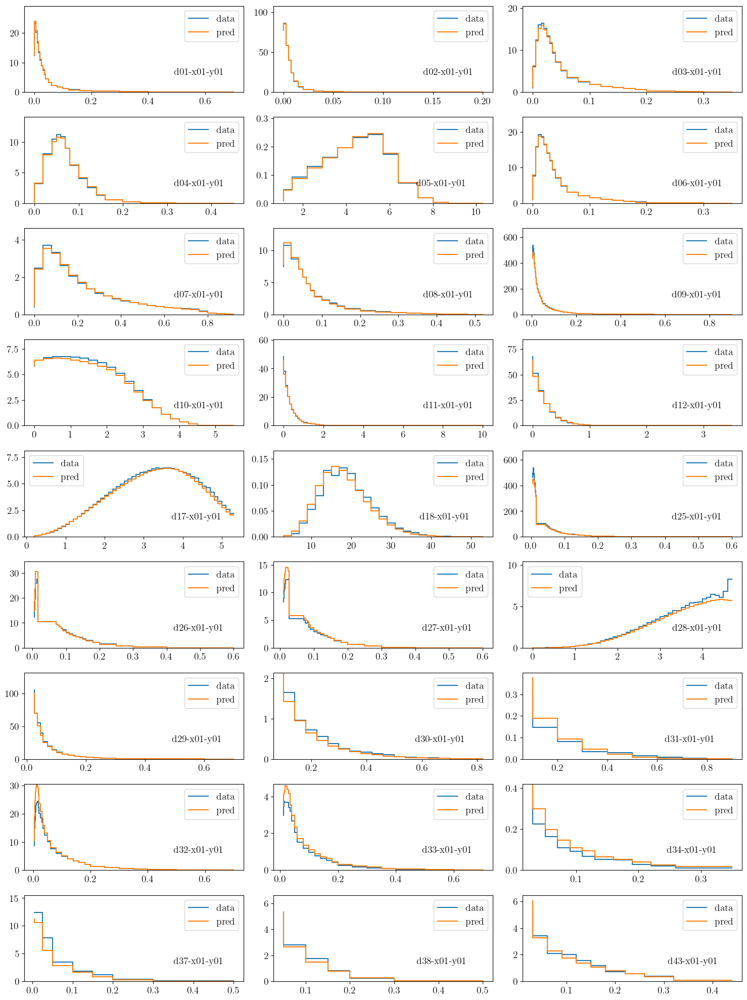

In [270]:
importlib.reload(pythia_SBI_utils)
from pythia_SBI_utils import * 

hists = make_hists(dfdata, dfsims_valid[0], reduced_data_keys, reduced_mc_keys)

plot_dist(reduced_data_keys, hists, filename=f'images/Ax_Minuit_Valid_Best_fit_hists_reduced_params_{N_ITER}_iter.pdf')